In [ ]:
import sys
sys.path.append('/dls_sw/apps/scisoftpy/2.7')
sys.path.append('/dls_sw/i16/software/python')
from dlstools import *
from dlstools.pdnx import *
from matplotlib.pyplot import *

from dlstools.quickfit import *
import matplotlib.pyplot as plt

#%matplotlib inline
%matplotlib notebook
#%matplotlib nbagg

p='/dls/i16/data/2020/cm26473-2/%i.nxs'

In [2]:
pd.set_option('display.max_rows',9999)
def showscans(scans, metadata = []):
    # md is metadata list e.g. ['entry1/sample/name']
    _scanlist =[]
    for scan in scans:
        _n = pdnx(p % scan)
        dic = {}
        dic['scan'] = scan
        dic['length'] = len(_n)
        dic['command'] = _n.nx.entry1.scan_command
        dic['start_time'] = _n.nx.entry1.start_time
        for meta in metadata:
            dic[meta.split('/')[-1]] = _n.nx[meta]   
            
        _scanlist += [dic]
        
    return pd.DataFrame(_scanlist)

<IPython.core.display.Javascript object>


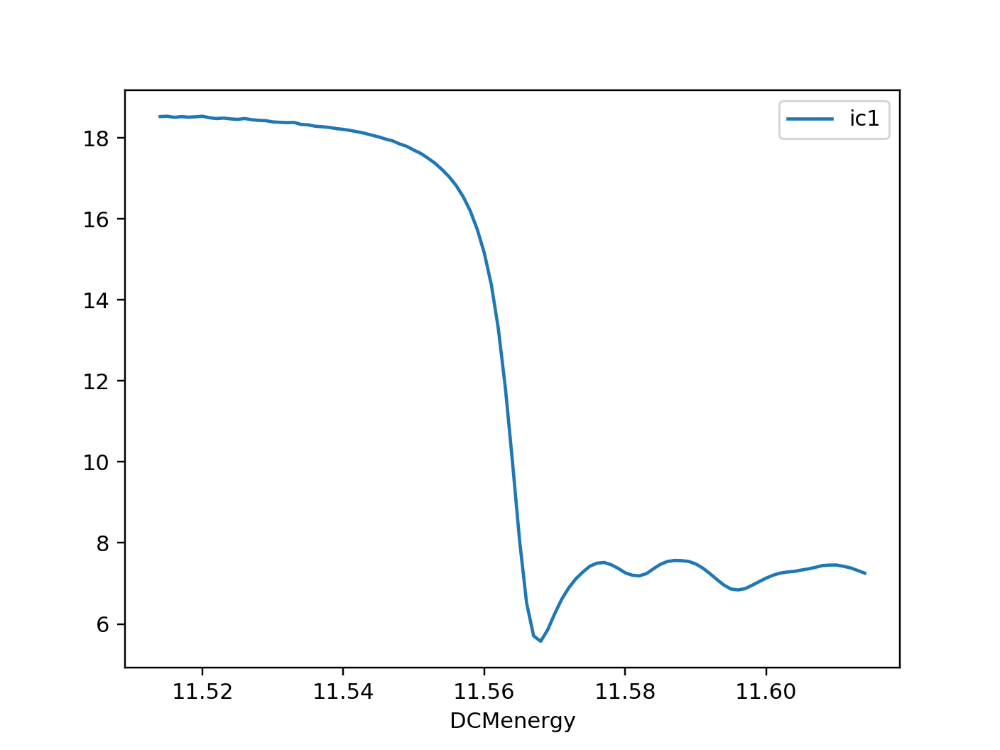

In [2]:
n = pdnx(p % 823290) # energy calibration (0.2 eV change but previous was noisy)
n.plot('DCMenergy','ic1')

<IPython.core.display.Javascript object>


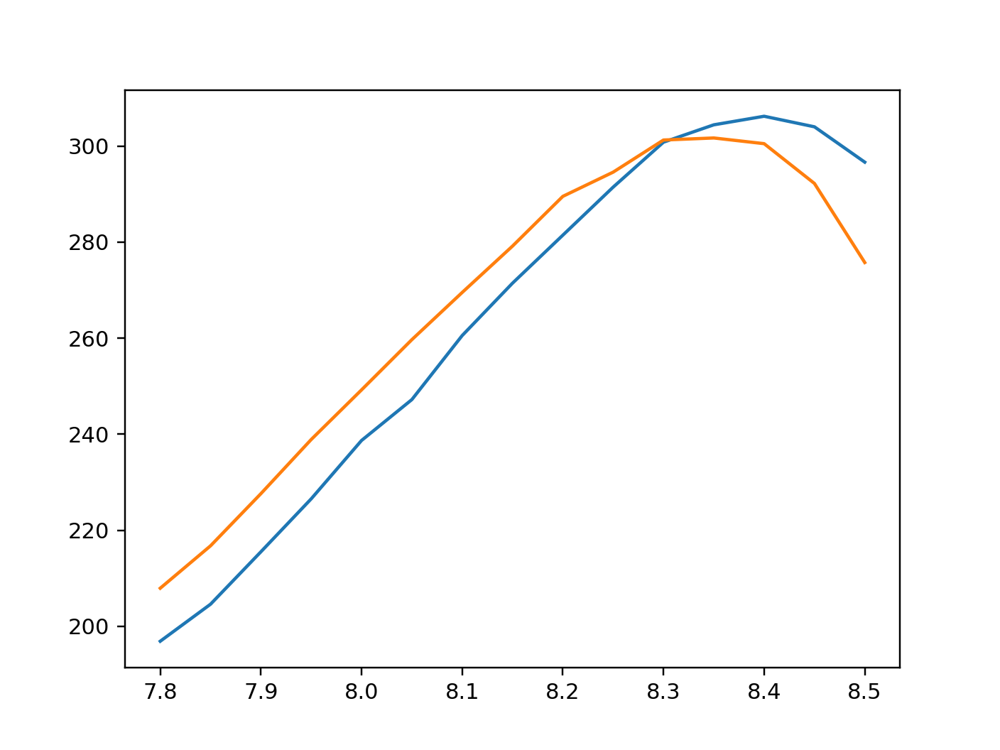

In [3]:
n = pdnx(p % 823310) # Rh coating
figure()
plot(n.DCMenergy,n.diode)
n = pdnx(p % 823311) # Si coating
plot(n.DCMenergy,n.diode)

<IPython.core.display.Javascript object>


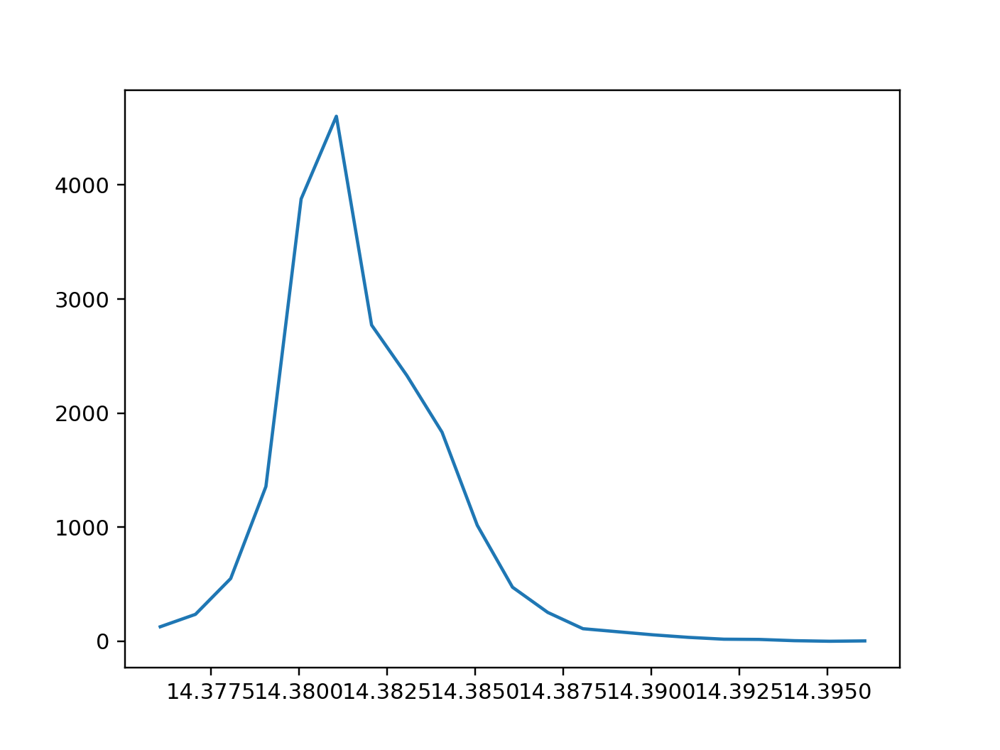

In [4]:
n = pdnx(p % 823317) # atten 200 7.5e-9
figure()
plot(n.eta,n['sum'])
n = pdnx(p % 823311) #  atten 170 7.6e-8


<IPython.core.display.Javascript object>


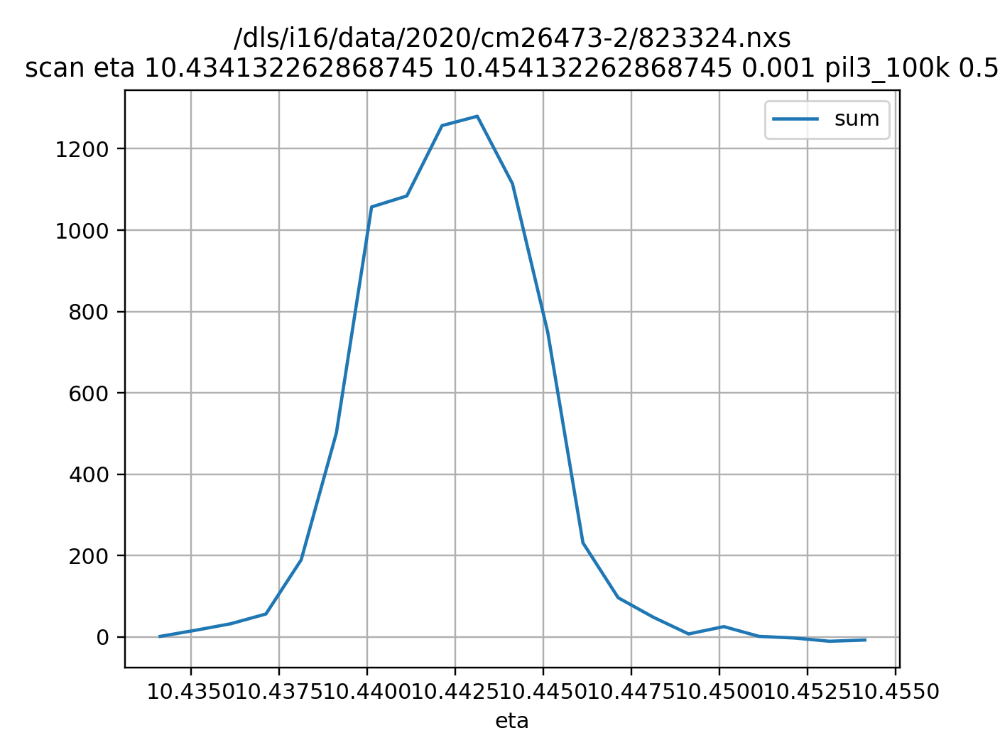

In [5]:
n = pdnx(p % 823324) # atten 170 7.6e-8
n.plt('eta','sum')

<IPython.core.display.Javascript object>


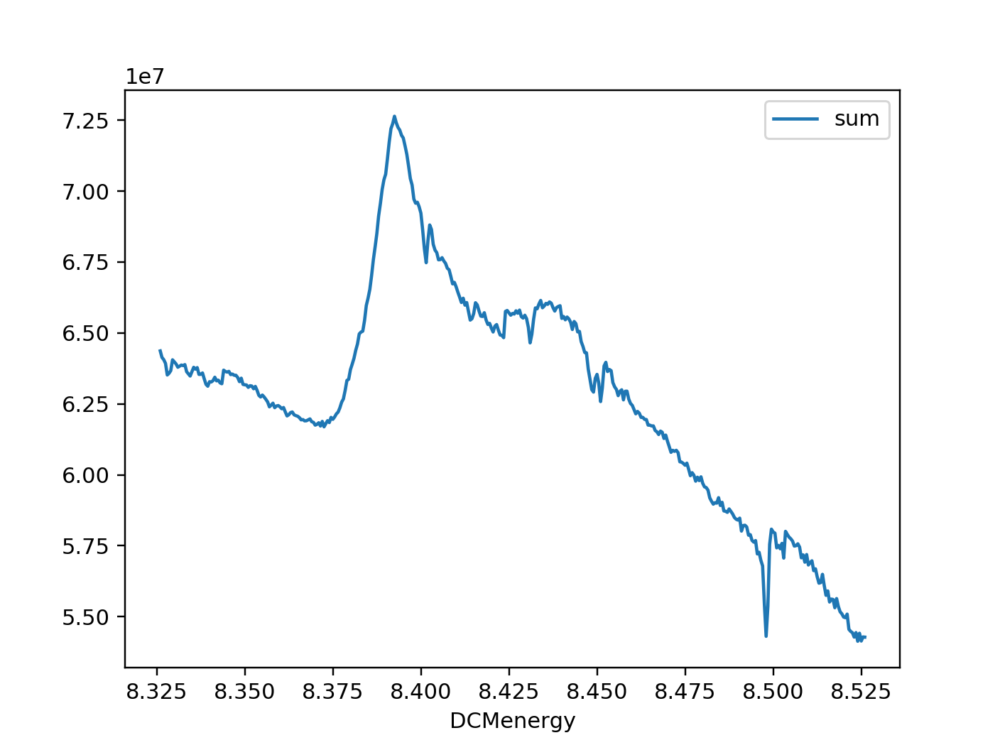

<IPython.core.display.Javascript object>


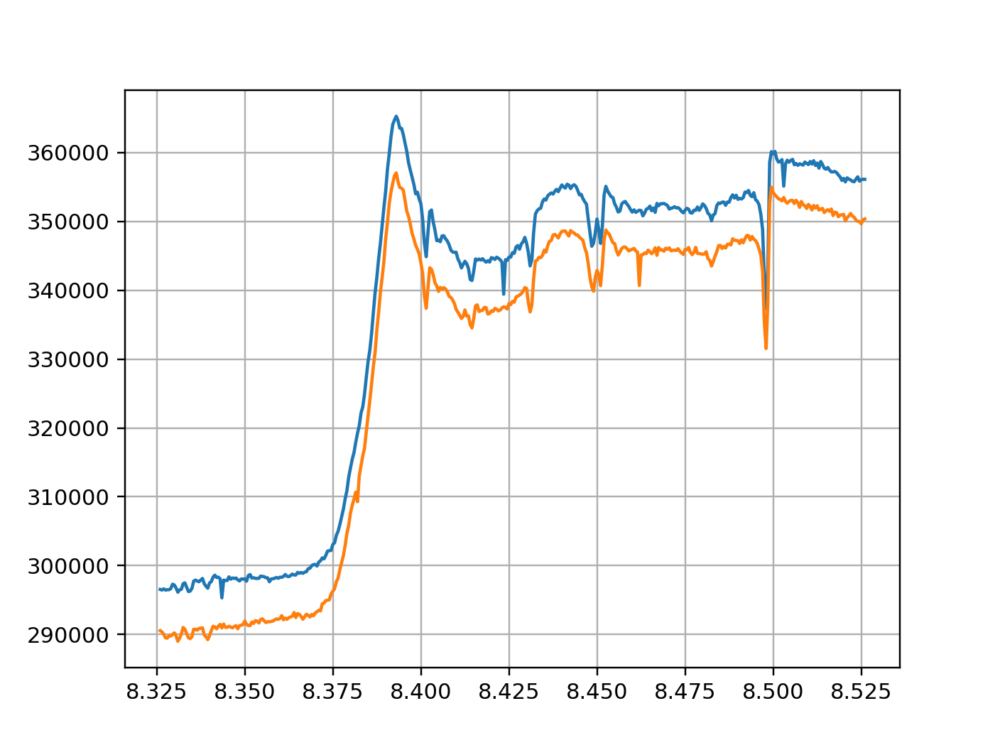

<IPython.core.display.Javascript object>


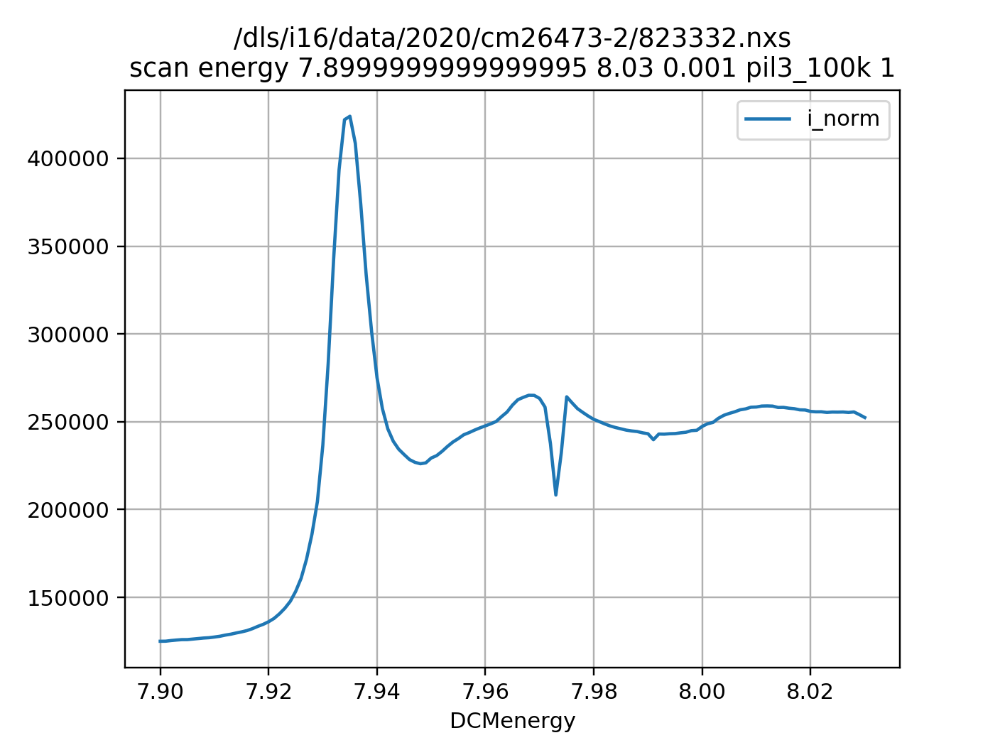

<IPython.core.display.Javascript object>


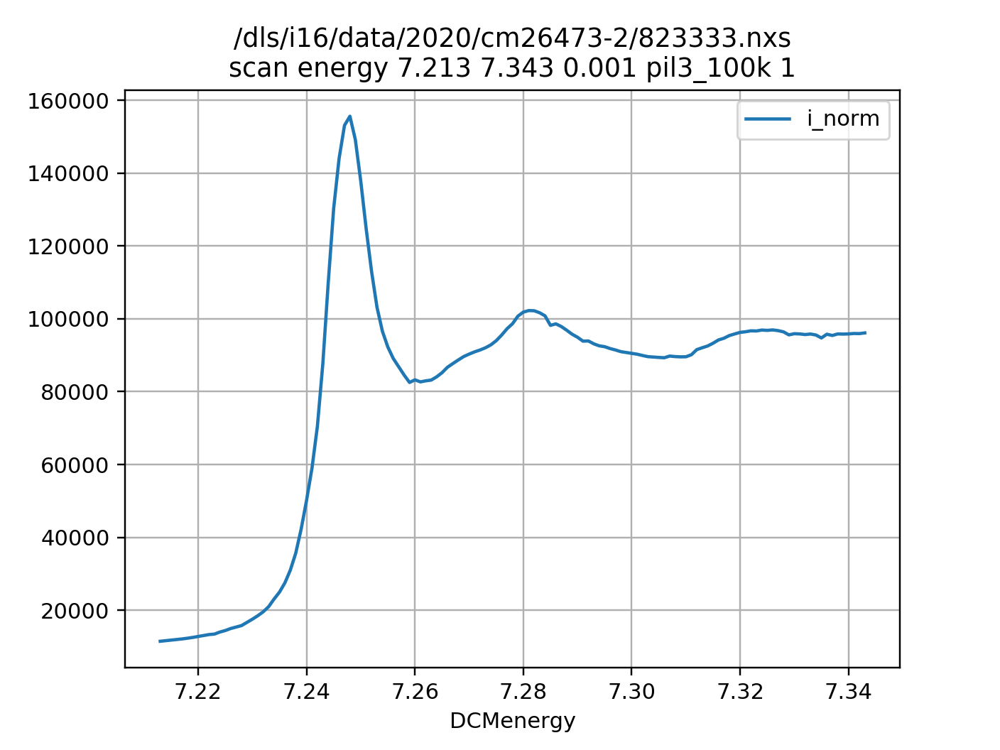

In [6]:
n = pdnx(p % 823329) # L1
n['i_norm'] = n['sum']/n.ic1monitor
n.plot('DCMenergy', 'sum')
figure()
plot(n['DCMenergy'], n['i_norm'])
n = pdnx(p % 823330) # L1
n['i_norm'] = n['sum']/n.ic1monitor
plot(n['DCMenergy'], n['i_norm']); grid(1)

n = pdnx(p % 823332) # L2
n['i_norm'] = n['sum']/n.ic1monitor
n.plt('DCMenergy', 'i_norm')

n = pdnx(p % 823333) # L3
n['i_norm'] = n['sum']/n.ic1monitor
n.plt('DCMenergy', 'i_norm')


Text(0.5, 1.0, 'scan pil3_tresh 5 9 0.1 pil3_100k 1  L3')

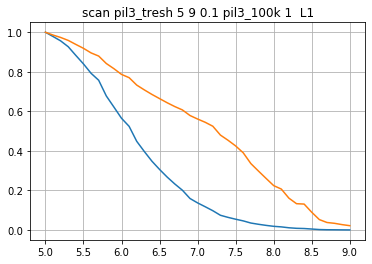

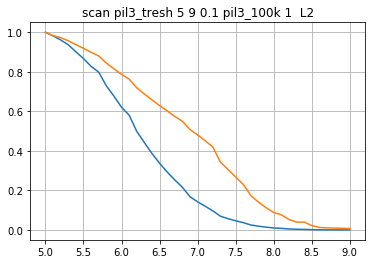

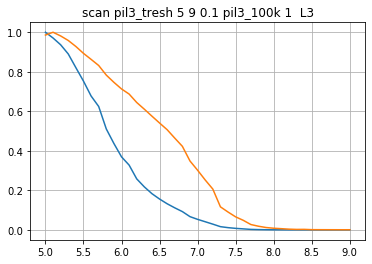

In [7]:
n = pdnx(p % 823335) # L1 E=8.39 keV
n['norm_sum'] = n['sum']/max(n['sum'])
figure()
plot(n.pil3_tresh, n.norm_sum)
n = pdnx(p % 823340) # L1 E=7.935 keV nominal [004] atten 50
n['norm_sum'] = n['sum']/max(n['sum'])
plot(n.pil3_tresh, n.norm_sum); grid(1)
title(n.nx.entry1.title + '  L1')

n = pdnx(p % 823336) # L2 E=7.935 keV
n['norm_sum'] = n['sum']/max(n['sum'])
figure()
plot(n.pil3_tresh, n.norm_sum)
n = pdnx(p % 823339) # L2 E=7.935 keV nominal [004] atten 50
n['norm_sum'] = n['sum']/max(n['sum'])
plot(n.pil3_tresh, n.norm_sum); grid(1)
title(n.nx.entry1.title + '  L2')

n = pdnx(p % 823337) # L3 E=7.248 keV
n['norm_sum'] = n['sum']/max(n['sum'])
figure()
plot(n.pil3_tresh, n.norm_sum)
n = pdnx(p % 823338) # L3 E=7.248 keV nominal [004] atten 50
n['norm_sum'] = n['sum']/max(n['sum'])
plot(n.pil3_tresh, n.norm_sum); grid(1)
title(n.nx.entry1.title + '  L3')


In [23]:
showscans(range(823364, 823483+1))

,scan,command,start_time
0,823364,scan eta 20.931272102811946 21.13127210281195 ...,2020-07-14T17:12:05.478+01:00
1,823365,scan chi 89.35441462626818 90.35441462626818 0...,2020-07-14T17:13:42.129+01:00
2,823366,scan eta 21.02127210281294 21.041272102812943 ...,2020-07-14T17:14:32.142+01:00
3,823367,scan energy 8.350000000000001 8.41 5.0E-4 hkl ...,2020-07-14T17:15:15.65+01:00
4,823368,scan eta 22.18501356543095 22.385013565430953 ...,2020-07-14T17:24:48.077+01:00
5,823369,scan chi 89.35441462626818 90.35441462626818 0...,2020-07-14T17:26:24.089+01:00
6,823370,scan eta 22.27001356543195 22.290013565431952 ...,2020-07-14T17:27:13.899+01:00
7,823371,scan energy 7.8999999999999995 7.96 5.0E-4 hkl...,2020-07-14T17:27:58.342+01:00
8,823372,scan eta 24.438620193379947 24.63862019337995 ...,2020-07-14T17:37:36.496+01:00
9,823373,scan chi 89.35441462626818 90.35441462626818 0...,2020-07-14T17:39:13.735+01:00


(0, 10000000.0)

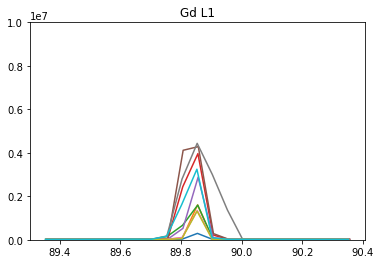

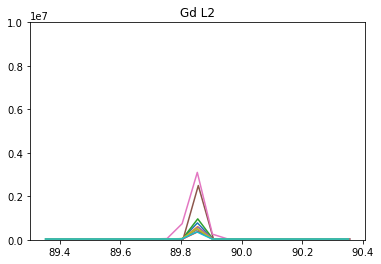

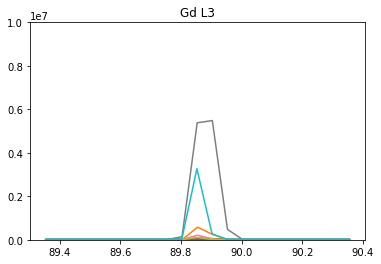

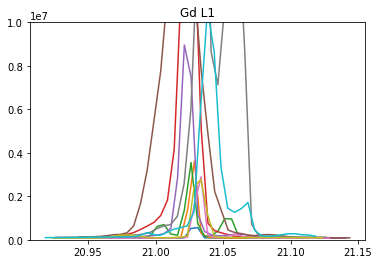

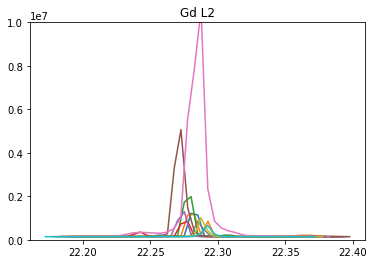

...

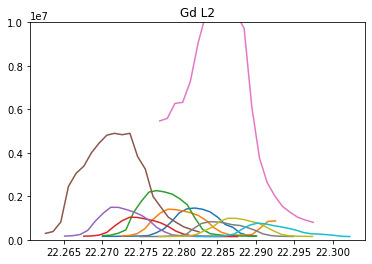

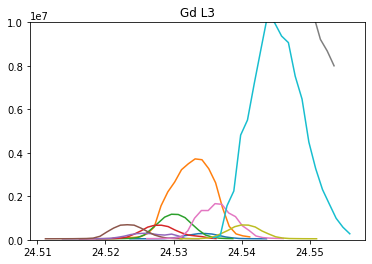

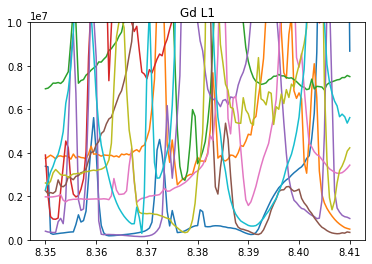

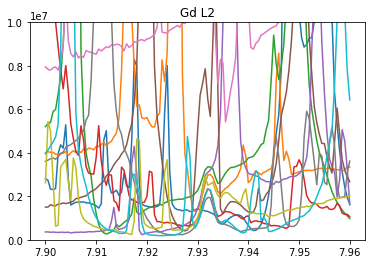

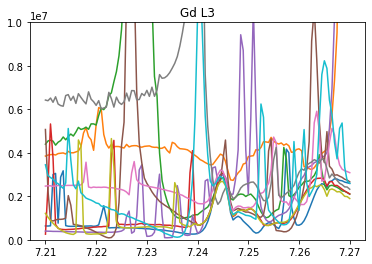

In [8]:
en_l1_scans = range(823367, 823475+1, 12)
en_l2_scans = range(823371, 823479+1, 12)
en_l3_scans = range(823375, 823483+1, 12)
eta_fine_l1_scans = range(823366 , 823474+1, 12)
eta_fine_l2_scans = range(823370, 823478+1, 12)
eta_fine_l3_scans = range(823374, 823482+1, 12)
eta_l1_scans = range(823364 , 823472+1, 12)
eta_l2_scans = range(823368, 823476+1, 12)
eta_l3_scans = range(823372, 823480+1, 12)
chi_l1_scans = range(823365 , 823473+1, 12)
chi_l2_scans = range(823369, 823477+1, 12)
chi_l3_scans = range(823373, 823481+1, 12)

figure()
for scan in chi_l1_scans:
    n = pdnx(p % scan)
    plot(n.chi, n.schiroi_sum)
    title('Gd L1')    
ylim([0,1e7])

figure()
for scan in chi_l2_scans:
    n = pdnx(p % scan)
    plot(n.chi, n.schiroi_sum)
    title('Gd L2')    
ylim([0,1e7])

figure()
for scan in chi_l3_scans:
    n = pdnx(p % scan)
    plot(n.chi, n.schiroi_sum)
    title('Gd L3')    
ylim([0,1e7])

figure()
for scan in eta_l1_scans:
    n = pdnx(p % scan)
    plot(n.eta, n.roi1_sum)
    title('Gd L1')    
ylim([0,1e7])

figure()
for scan in eta_l2_scans:
    n = pdnx(p % scan)
    plot(n.eta, n.roi1_sum)
    title('Gd L2')    
ylim([0,1e7])

figure()
for scan in eta_l3_scans:
    n = pdnx(p % scan)
    plot(n.eta, n.roi1_sum)
    title('Gd L3')    
ylim([0,1e7])

figure()
for scan in eta_fine_l1_scans:
    n = pdnx(p % scan)
    plot(n.eta, n.roi1_sum)
    title('Gd L1')    
ylim([0,1e7])

figure()
for scan in eta_fine_l2_scans:
    n = pdnx(p % scan)
    plot(n.eta, n.roi1_sum)
    title('Gd L2')    
ylim([0,1e7])

figure()
for scan in eta_fine_l3_scans:
    n = pdnx(p % scan)
    plot(n.eta, n.roi1_sum)
    title('Gd L3')    
ylim([0,1e7])


figure()
for scan in en_l1_scans:
    n = pdnx(p % scan)
    plot(n.DCMenergy, n.roi1_sum)
    title('Gd L1')    
ylim([0,1e7])

figure()
for scan in en_l2_scans:
    n = pdnx(p % scan)
    plot(n.DCMenergy, n.roi1_sum)
    title('Gd L2')    
ylim([0,1e7])

figure()
for scan in en_l3_scans:
    n = pdnx(p % scan)
    plot(n.DCMenergy, n.roi1_sum)
    title('Gd L3')    
ylim([0,1e7])

In [25]:
showscans(range(823504, 823640+1))

,scan,command,start_time
0,823504,scan eta 20.81725180660414 21.117251806604138 ...,2020-07-15T10:42:40.881+01:00
1,823505,scan chi 89.35680910427088 90.35680910427088 0...,2020-07-15T10:44:25.587+01:00
2,823506,scan eta 21.062251806604696 21.0822518066047 0...,2020-07-15T10:45:05.473+01:00
3,823507,scan psi 18.0 22.0 0.05 hkl [0.008640045276201...,2020-07-15T10:45:40.298+01:00
4,823508,scan eta 22.07099326922414 22.370993269224137 ...,2020-07-15T10:48:12.628+01:00
5,823509,scan chi 89.35680910427088 90.35680910427088 0...,2020-07-15T10:49:44.969+01:00
6,823510,scan eta 22.315993269224695 22.335993269224698...,2020-07-15T10:50:49.095+01:00
7,823511,scan psi 18.0 22.0 0.05 hkl [0.008344832514091...,2020-07-15T10:51:24.256+01:00
8,823512,scan eta 24.324599897173137 24.624599897173134...,2020-07-15T10:53:58.56+01:00
9,823513,scan chi 89.35680910427088 90.35680910427088 0...,2020-07-15T10:55:28.887+01:00


<IPython.core.display.Javascript object>


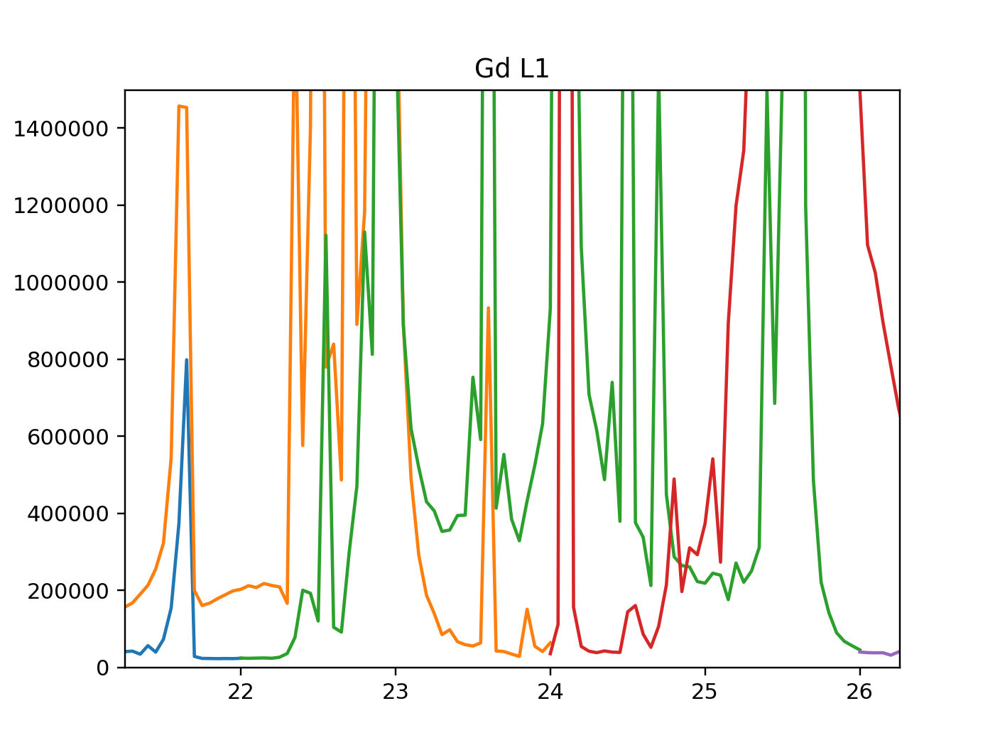

(0, 10000000.0)

In [12]:
%matplotlib notebook
#losing alignment. check with 004 allowed.

psi_l1_scans = range(823507, 823640+1, 12)
psi_l2_scans = range(823511, 823640+1, 12)
psi_l3_scans = range(823515, 823640+1, 12)

figure()
for scan in psi_l3_scans:
    n = pdnx(p % scan)
    plot(n.psi, n.roi1_sum)
    title('Gd L1')    
ylim([0,1e7])

<IPython.core.display.Javascript object>


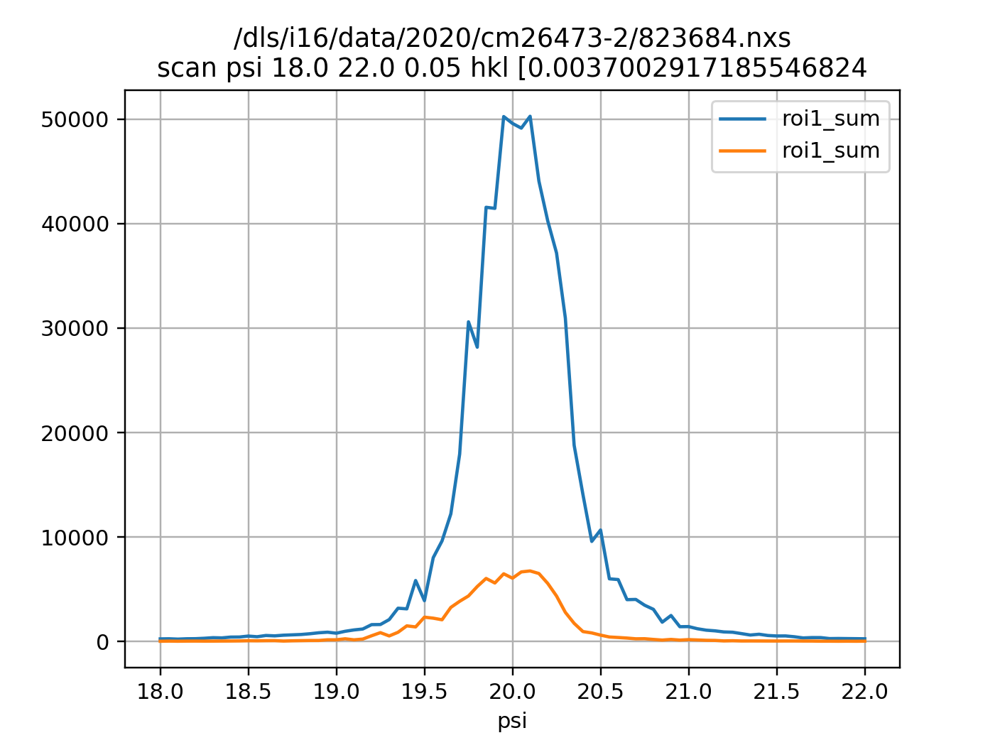

<IPython.core.display.Javascript object>


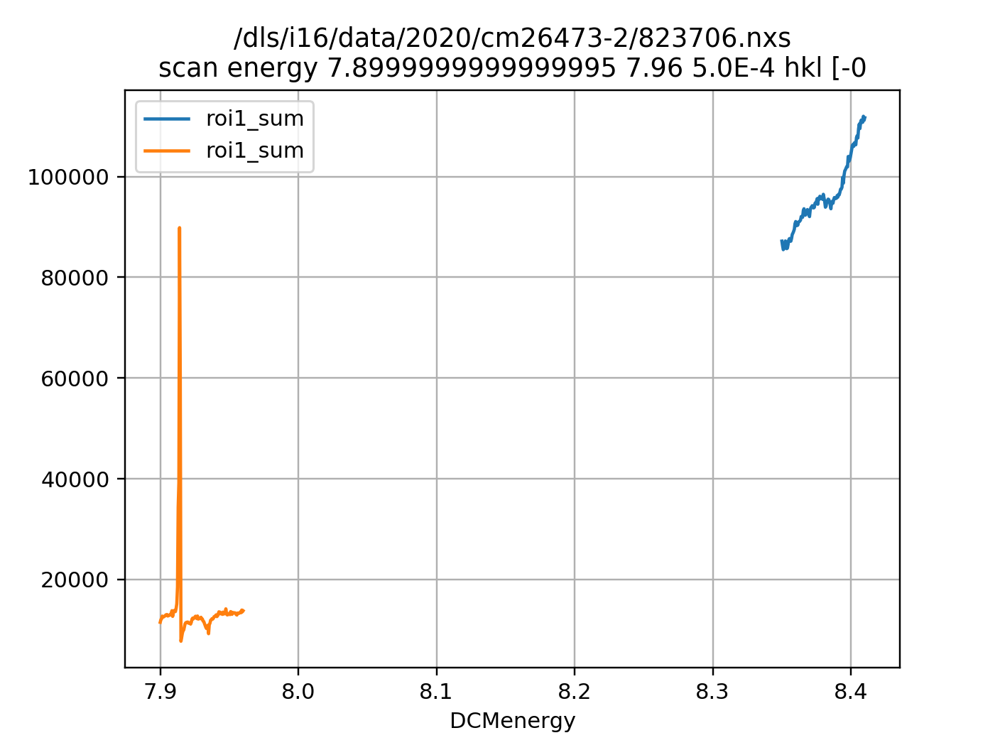

In [11]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots(1, 1)
pdnx(p % 823680).plt('psi', 'roi1_sum', ax=ax)
pdnx(p % 823684).plt('psi', 'roi1_sum', ax=ax)

fig, ax = plt.subplots(1, 1)
pdnx(p % 823702).plt('DCMenergy', 'roi1_sum', ax = ax)
pdnx(p % 823706).plt('DCMenergy', 'roi1_sum', ax = ax)


In [28]:
showscans(range(823760, 824137+1))

,scan,command,start_time
0,823760,scan eta 20.868482216249184 21.16848221624918 ...,2020-07-15T18:03:49.912+01:00
1,823761,scan chi 89.3526494310059 90.3526494310059 0.0...,2020-07-15T18:05:25.579+01:00
2,823762,scan eta 21.028482216250172 21.048482216250175...,2020-07-15T18:06:07.769+01:00
3,823763,scan psi 39.75 40.25 0.05 hkl [0.0017648396595...,2020-07-15T18:06:44.659+01:00
4,823764,scan eta 21.031124807320648 21.05112480732065 ...,2020-07-15T18:07:04.021+01:00
5,823765,scan energy 8.350000000000001 8.41 5.0E-4 hkl ...,2020-07-15T18:07:40.348+01:00
6,823766,scan eta 22.121580609807573 22.42158060980757 ...,2020-07-15T18:17:40.105+01:00
7,823767,scan chi 89.35259053333019 90.35259053333019 0...,2020-07-15T18:19:16.1+01:00
8,823768,scan eta 22.281580609808575 22.30158060980858 ...,2020-07-15T18:20:26.283+01:00
9,823769,scan psi 39.5 40.0 0.05 hkl [0.001529745611281...,2020-07-15T18:21:03.973+01:00


<IPython.core.display.Javascript object>


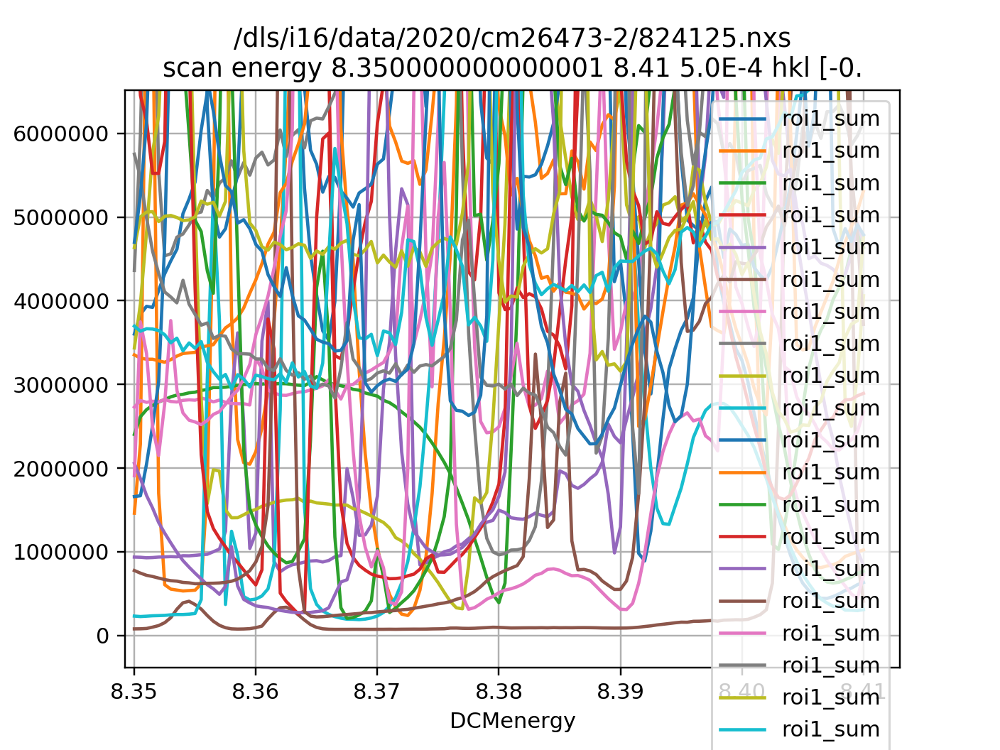

<IPython.core.display.Javascript object>


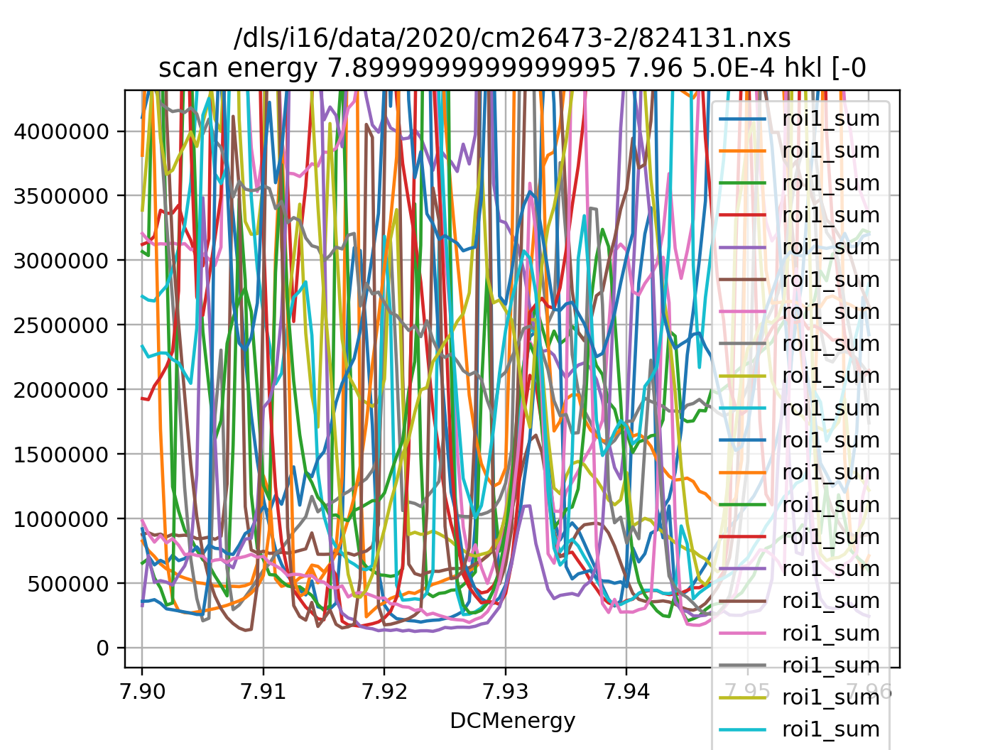

<IPython.core.display.Javascript object>


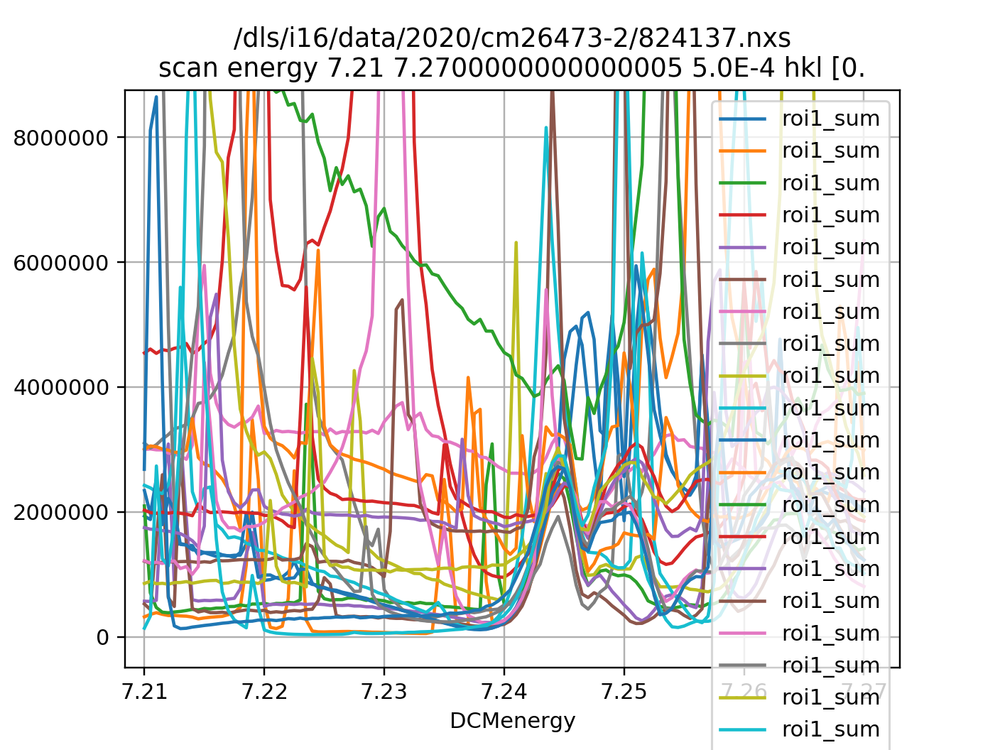

<IPython.core.display.Javascript object>


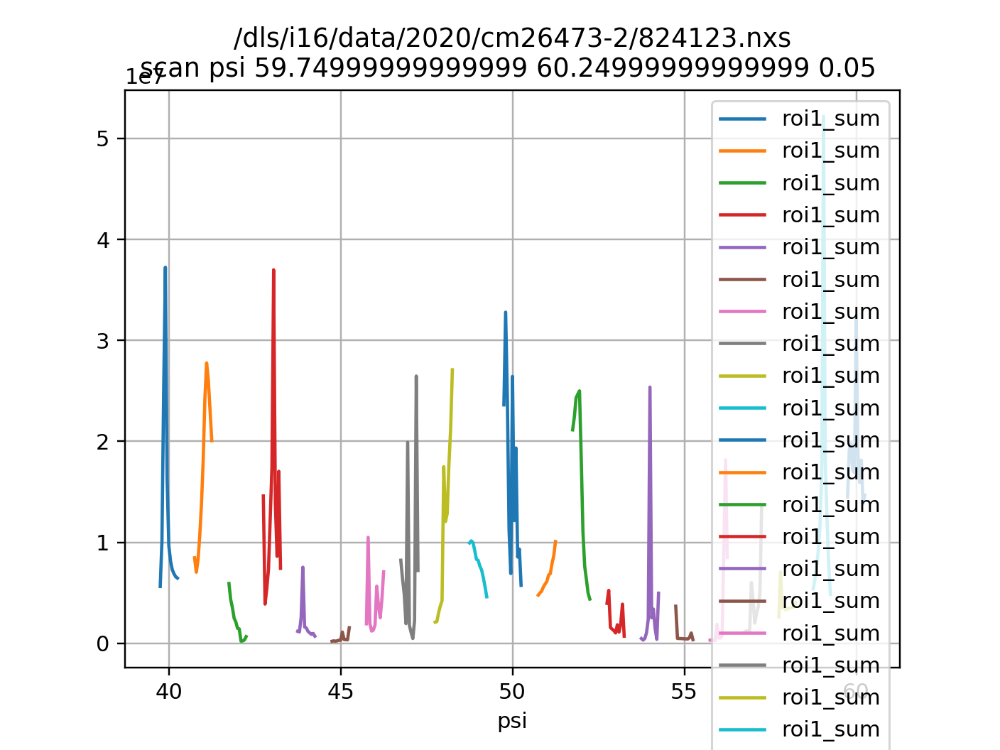

<IPython.core.display.Javascript object>


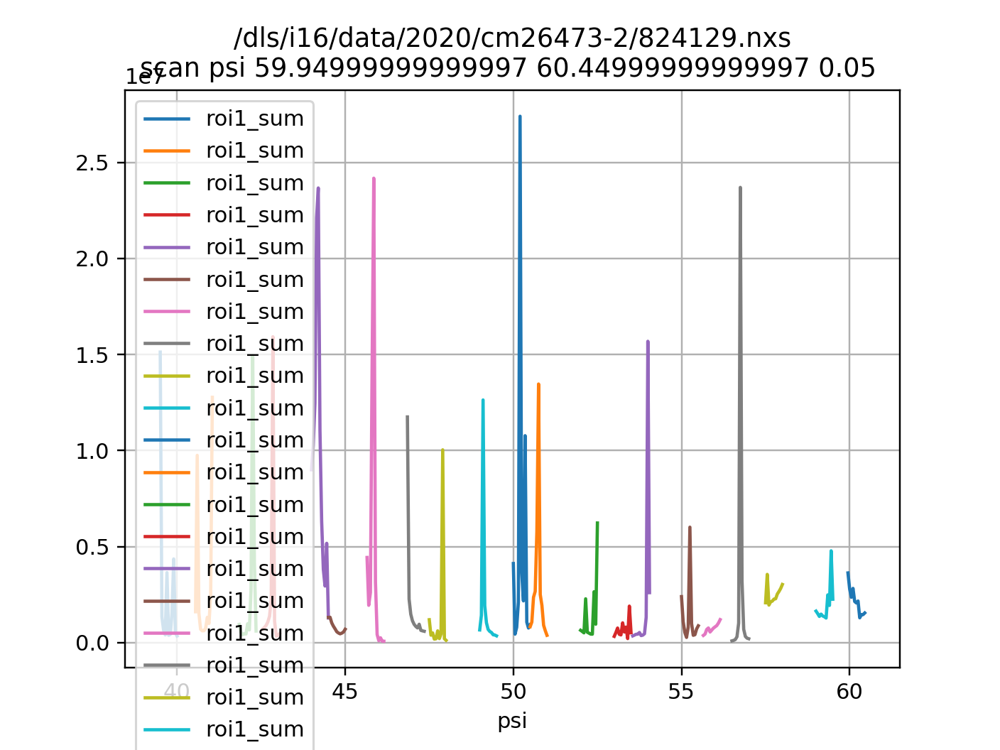

<IPython.core.display.Javascript object>


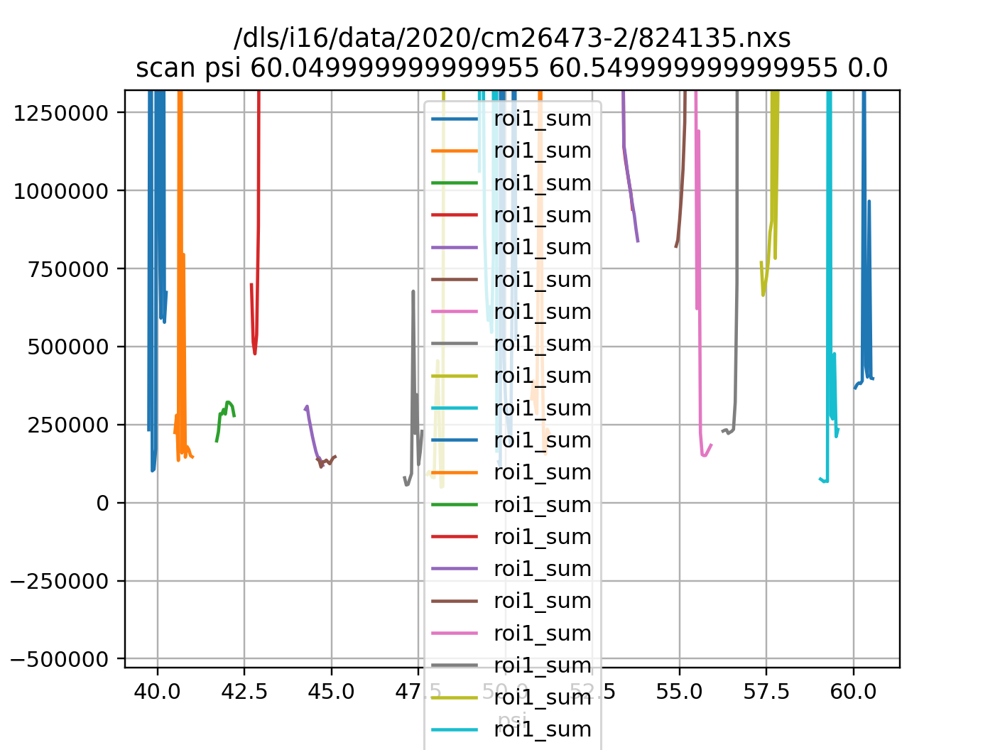

In [29]:
first = 823760
last = 824137
psi_l1_scans = range(823763, last+1, 18)
psi_l2_scans = range(823769, last+1, 18)
psi_l3_scans = range(823775, last+1, 18)
en_l1_scans = range(823765, last+1, 18)
en_l2_scans = range(823771, last+1, 18)
en_l3_scans = range(823777, last+1, 18)

fig, ax = plt.subplots(1, 1)
for scan in en_l1_scans:
    pdnx(p % scan).plt('DCMenergy', 'roi1_sum', ax=ax)

fig, ax = plt.subplots(1, 1)
for scan in en_l2_scans:
    pdnx(p % scan).plt('DCMenergy', 'roi1_sum', ax=ax)
    
fig, ax = plt.subplots(1, 1)
for scan in en_l3_scans:
    pdnx(p % scan).plt('DCMenergy', 'roi1_sum', ax=ax)

#ylim([0,1e7])


fig, ax = plt.subplots(1, 1)
for scan in psi_l1_scans:
    pdnx(p % scan).plt('psi', 'roi1_sum', ax=ax)

fig, ax = plt.subplots(1, 1)
for scan in psi_l2_scans:
    pdnx(p % scan).plt('psi', 'roi1_sum', ax=ax)
    
fig, ax = plt.subplots(1, 1)
for scan in psi_l3_scans:
    pdnx(p % scan).plt('psi', 'roi1_sum', ax=ax)

#ylim([0,1e7])


In [48]:
showscans(range(824165, 825283+1), metadata = ['entry1/sample/beam/incident_energy','entry1/before_scan/psi/psi'])

,scan,length,command,start_time,incident_energy,psi
0,824165,21,scan idgap 6.36085 6.400849999999999 0.002 Bea...,2020-07-16T10:48:38.614+01:00,7.24399716251239,61.74999999999992
1,824166,61,scan eta 24.374194904580946 24.674194904580943...,2020-07-16T10:49:14.018+01:00,7.24399716251239,45.00022433636228
2,824167,21,scan chi 89.35441462626818 90.35441462626818 0...,2020-07-16T10:50:47.797+01:00,7.244001619177332,44.99880169434683
3,824168,41,scan eta 24.60781523218753 24.64781523218753 0...,2020-07-16T10:51:35.317+01:00,7.213997701085241,44.99971759756888
4,824169,41,scan eta 24.607982027288354 24.647982027288354...,2020-07-16T10:52:41.732+01:00,7.2139999102576216,45.09977063661253
5,824170,41,scan eta 24.608148756052127 24.648148756052127...,2020-07-16T10:53:48.153+01:00,7.2139999102576216,45.199840174567896
6,824171,41,scan eta 24.60831541797369 24.648315417973688 ...,2020-07-16T10:54:54.982+01:00,7.213997701085241,45.29988954247223
7,824172,41,scan eta 24.60848201254362 24.64848201254362 0...,2020-07-16T10:56:01.883+01:00,7.2139999102576216,45.39992768874273
8,824173,41,scan eta 24.6086485392557 24.6486485392557 0.0...,2020-07-16T10:57:09.18+01:00,7.213997701085241,45.50000294120815
9,824174,41,scan eta 24.608814997602064 24.648814997602063...,2020-07-16T10:58:15.667+01:00,7.2139999102576216,45.60006697870829


<IPython.core.display.Javascript object>


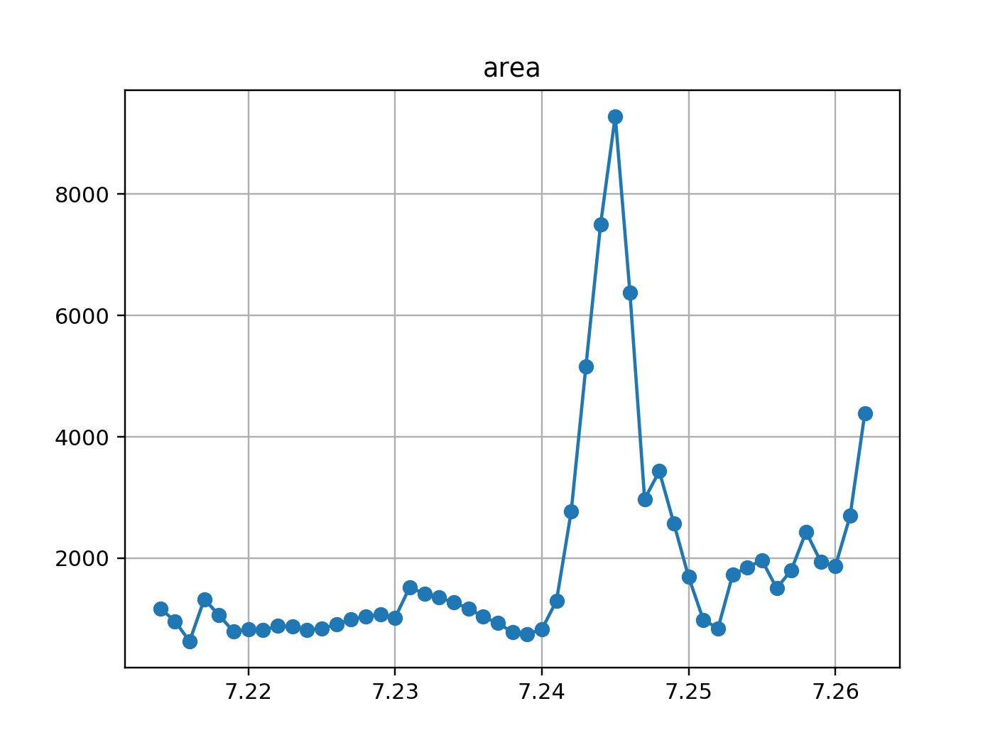

<IPython.core.display.Javascript object>


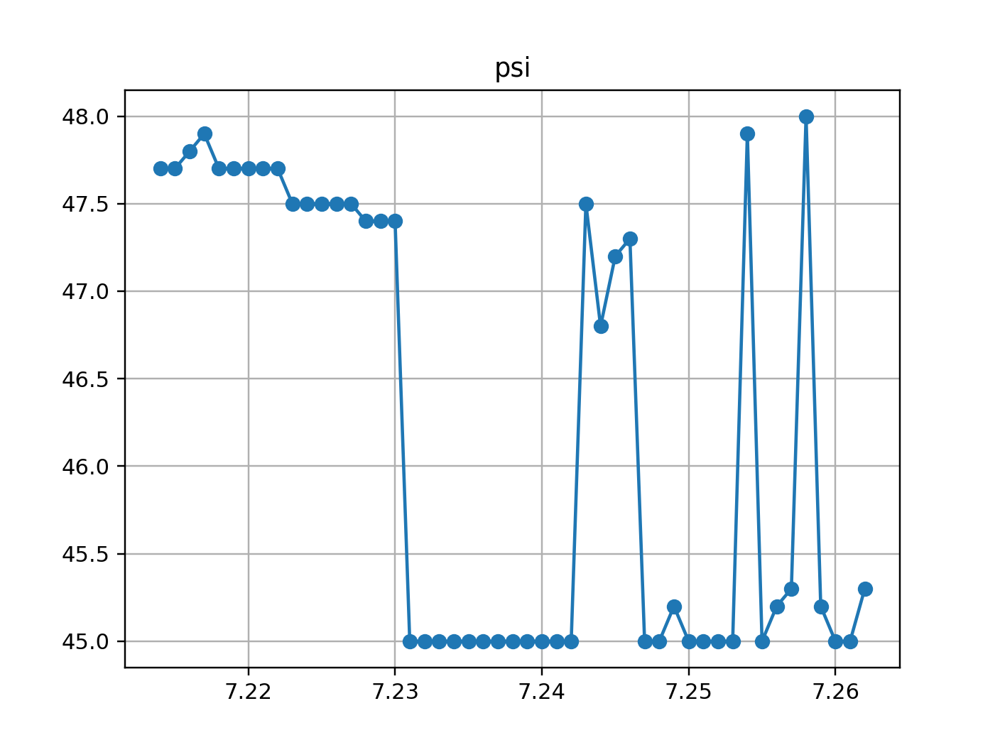

<IPython.core.display.Javascript object>


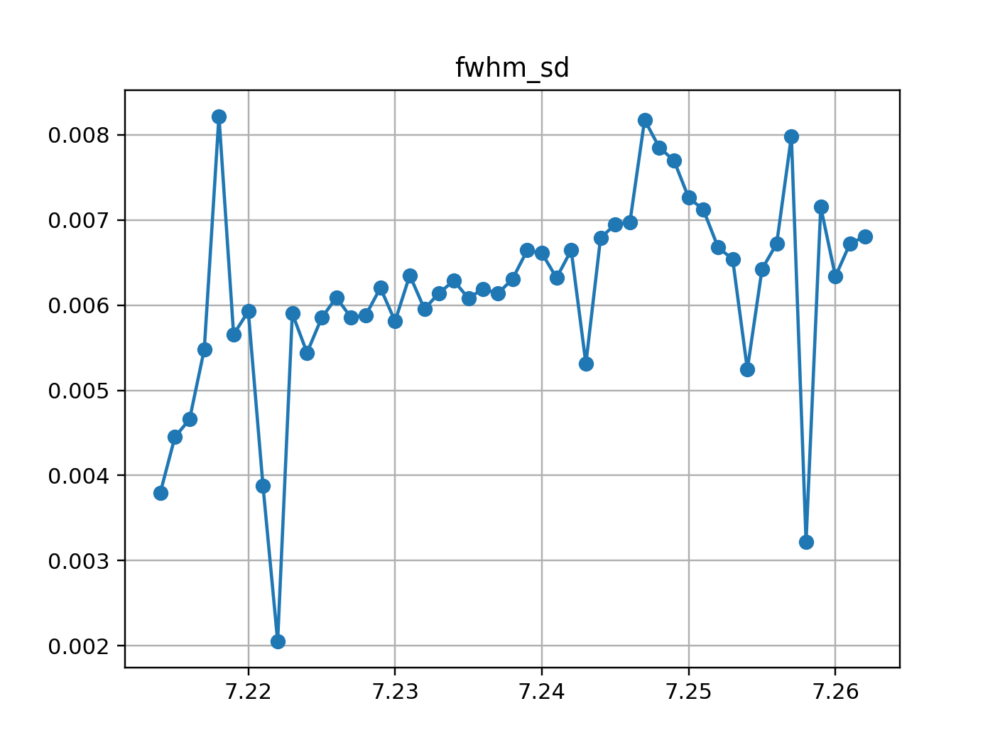

<IPython.core.display.Javascript object>


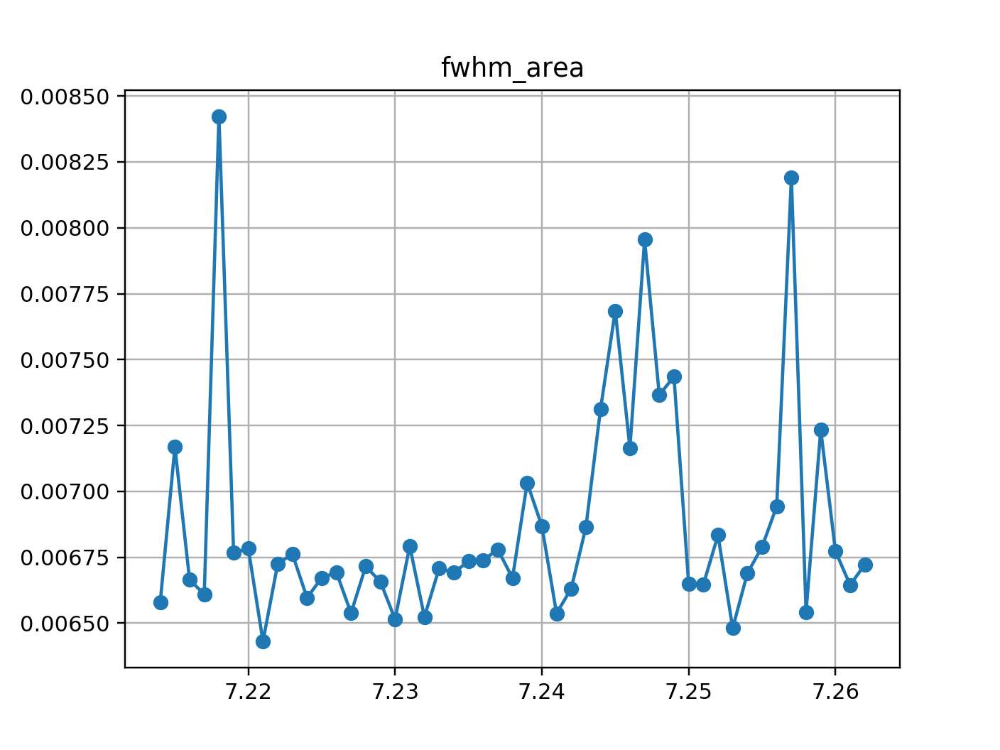

<IPython.core.display.Javascript object>


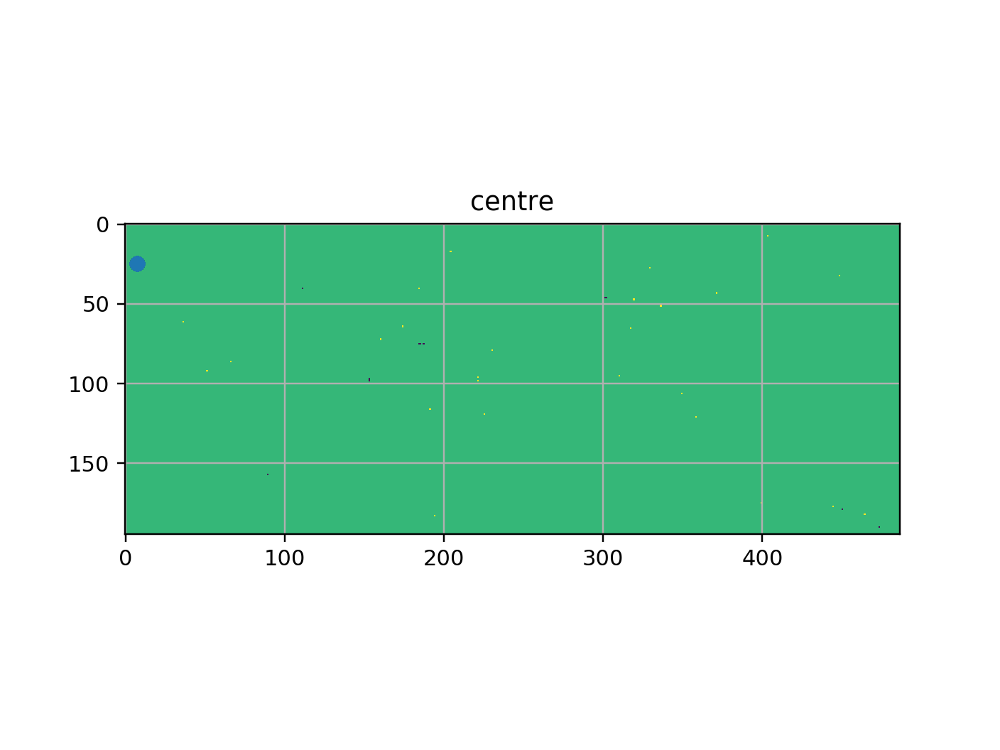

In [103]:
# get smallest area for each energy
max_width = 0.01 # ignore wide peaks
res = {}
for scan in range(824168, 825675+1):
    n = pdnx(p % scan)
    if len(n.beamOK) == 41: #it's a fine eta scan
        
        en = round(float(n.nx['entry1/sample/beam/incident_energy']), 3)
        psi = n.nx['entry1/before_scan/psi/psi']
        
        [centre, fwhm_sd, fwhm_area, sum, height, area, m, c] = peak(n.eta, n.roi1_sum-n.scroi_bg_sum, 3)
        #print(en, centre-np.mean(n.eta), np.max(n.eta)-np.min(n.eta), fwhm_sd, area, float(psi))
        
        if not np.isnan(fwhm_sd) and fwhm_sd < max_width:
        
            if en in res.keys():

                if area < res[en]['area']:   
                    res[en] = {'area': area, 'fwhm_sd': fwhm_sd, 'fwhm_area': fwhm_area, 'centre': centre, 'psi': float(psi)}
            else:

                res[en] = {'area': area, 'fwhm_sd': fwhm_sd, 'fwhm_area': fwhm_area, 'centre': centre, 'psi': float(psi)}
        
        #plot(n.eta, n.roi1_sum-n.scroi_bg_sum)

en, cts, psi , centre, fwhm_sd, fwhm_area = [], [], [], [], [], []
for pt in res:
    en += [pt]
    cts += [res[pt]['area']]
    psi += [res[pt]['psi']]
    fwhm_sd += [res[pt]['fwhm_sd']]
    fwhm_area += [res[pt]['fwhm_area']]
    centre += [res[pt]['centre']]
    
    
en, cts, psi, fwhm_sd, centre, fwhm_area = np.array(en), np.array(cts), np.array(psi), np.array(fwhm_sd), np.array(centre), np.array(fwhm_area)

figure(); plot(en, cts, '-o'); title('area'); grid(1)
figure(); plot(en, psi, '-o'); title('psi'); grid(1)
figure(); plot(en, fwhm_sd, '-o'); title('fwhm_sd'); grid(1)
figure(); plot(en, fwhm_area, '-o'); title('fwhm_area'); grid(1)
figure(); plot(en, centre, '-o'); title('centre'); grid(1)


<IPython.core.display.Javascript object>


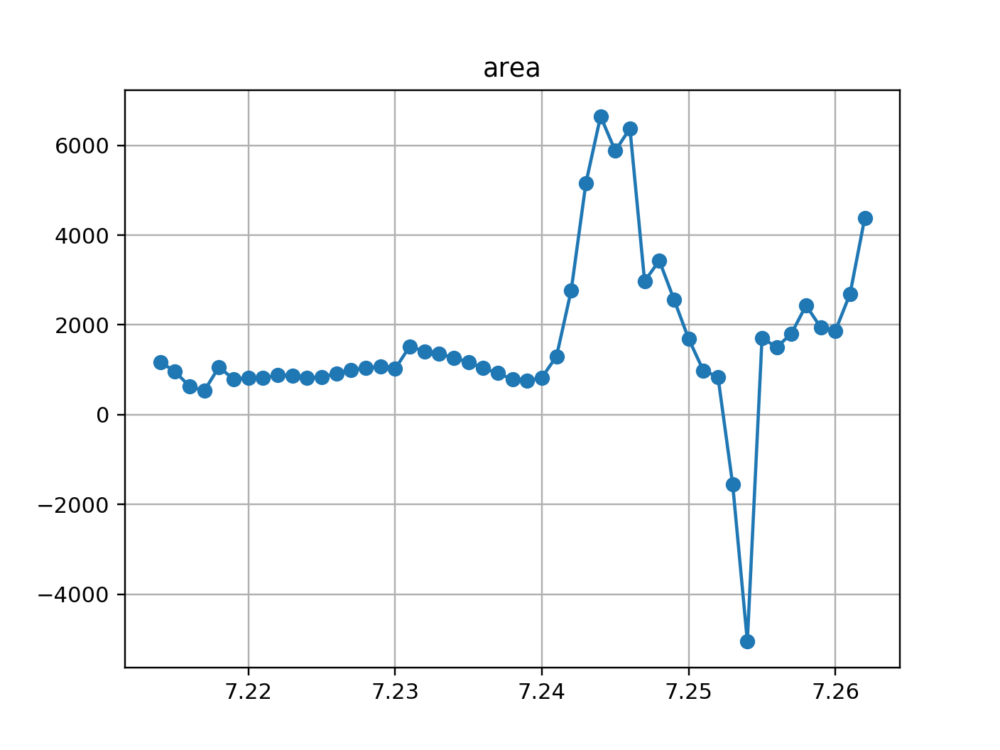

<IPython.core.display.Javascript object>


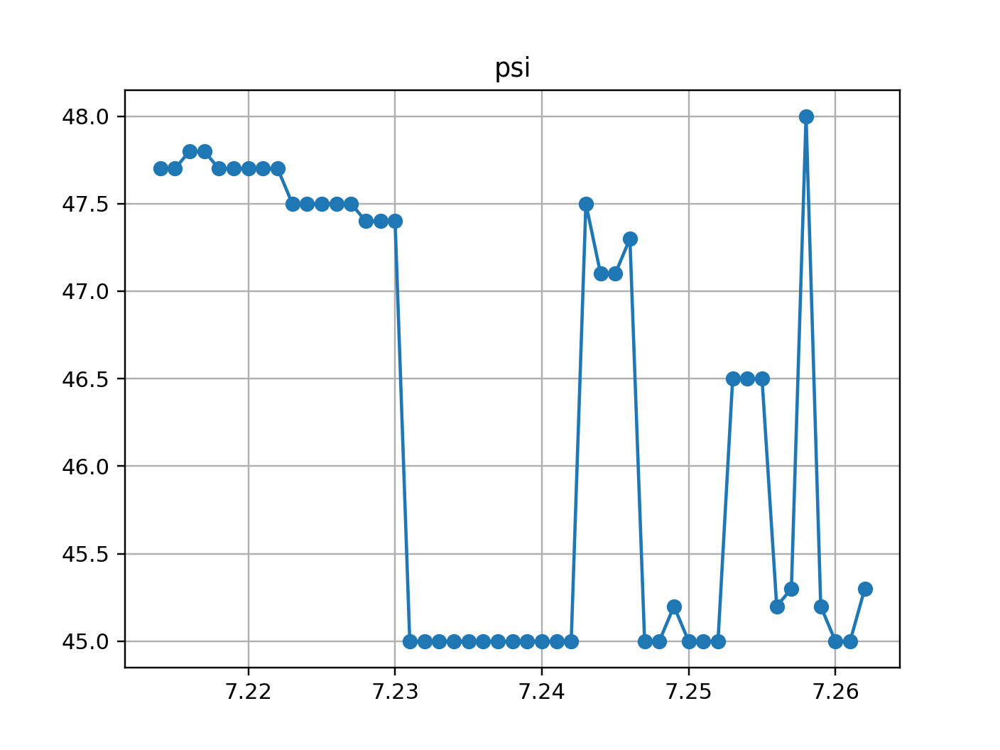

<IPython.core.display.Javascript object>


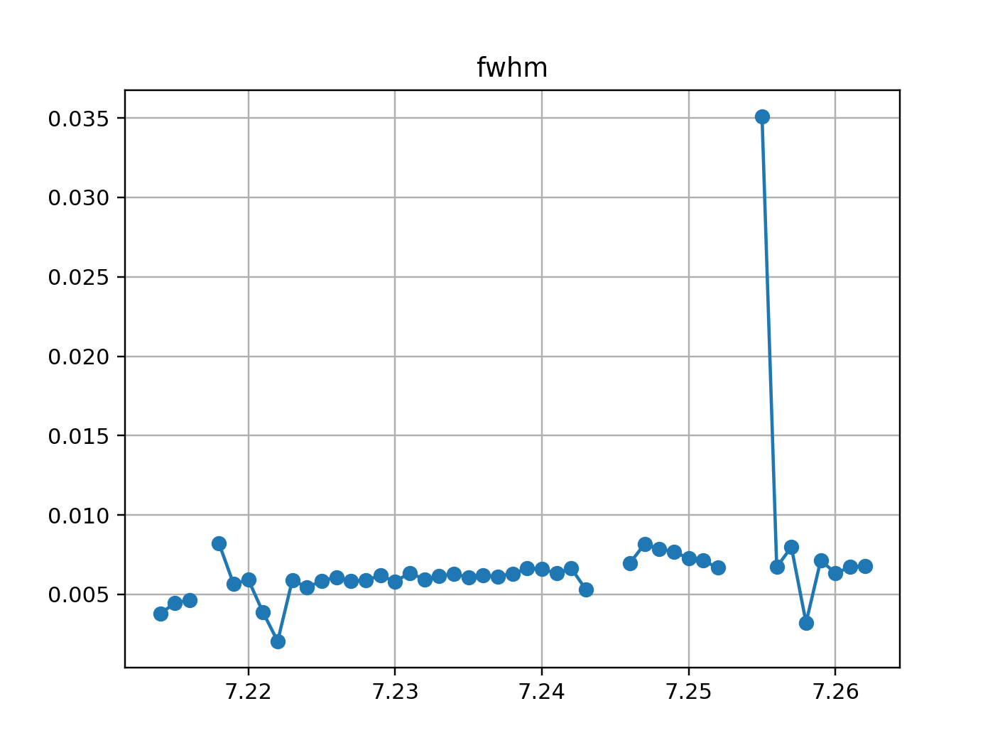

<IPython.core.display.Javascript object>


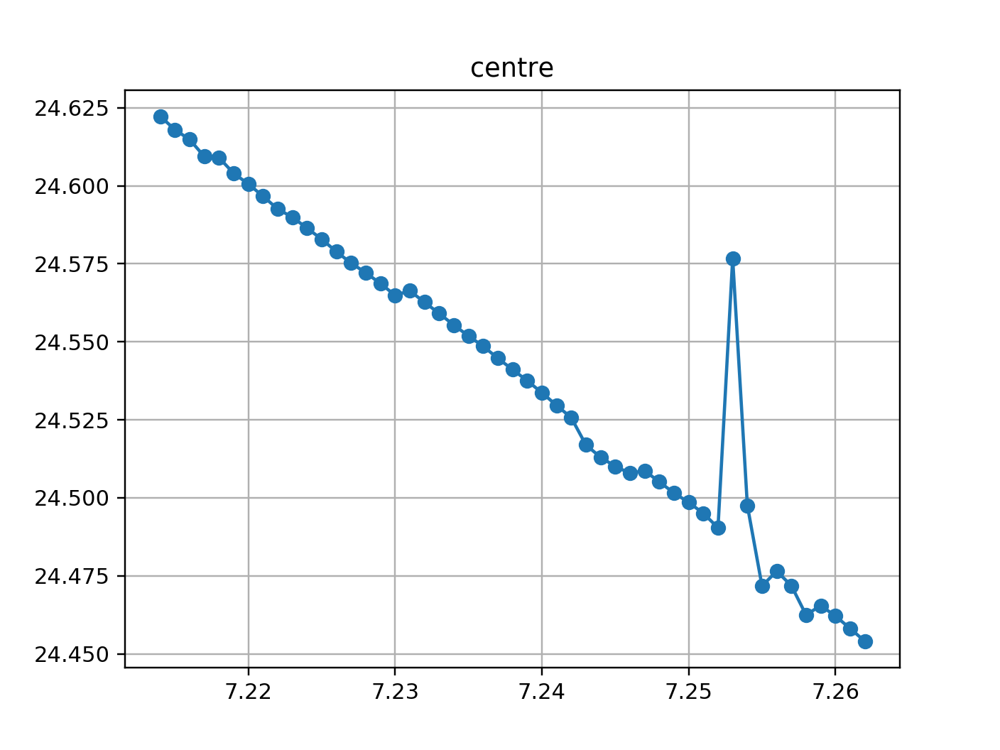

In [80]:
figure(); plot(en, cts, '-o'); title('area'); grid(1)
figure(); plot(en, psi, '-o'); title('psi'); grid(1)
figure(); plot(en, fwhm_sd, '-o'); title('fwhm'); grid(1)
figure(); plot(en, centre, '-o'); title('centre'); grid(1)

In [10]:
res

NameError: name 'res' is not defined

<IPython.core.display.Javascript object>


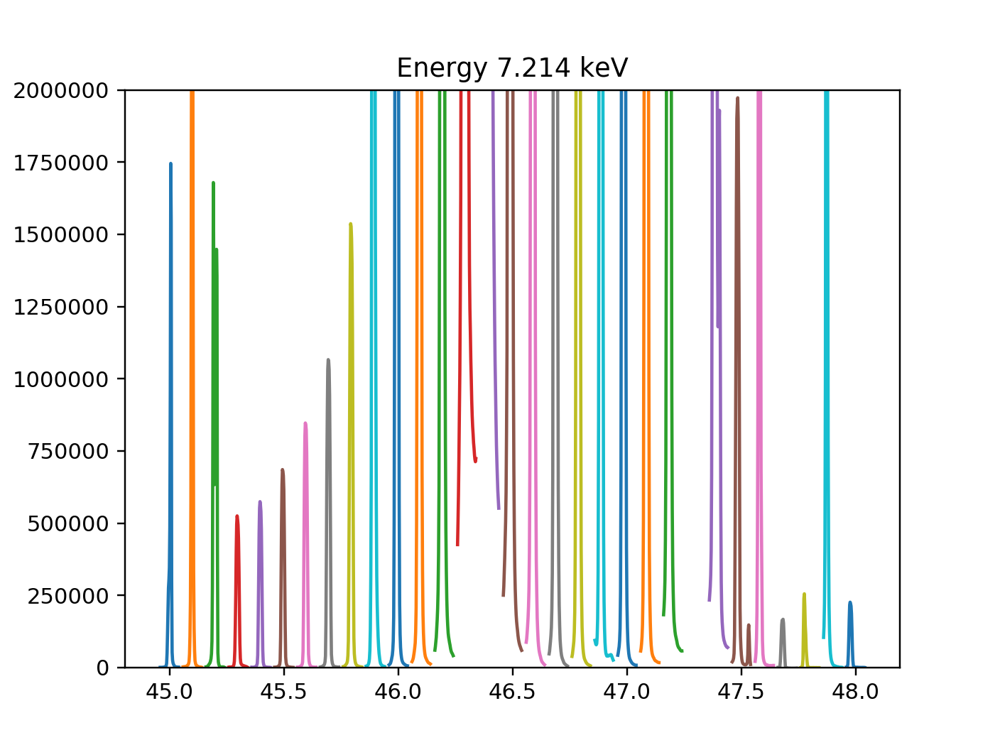

<IPython.core.display.Javascript object>


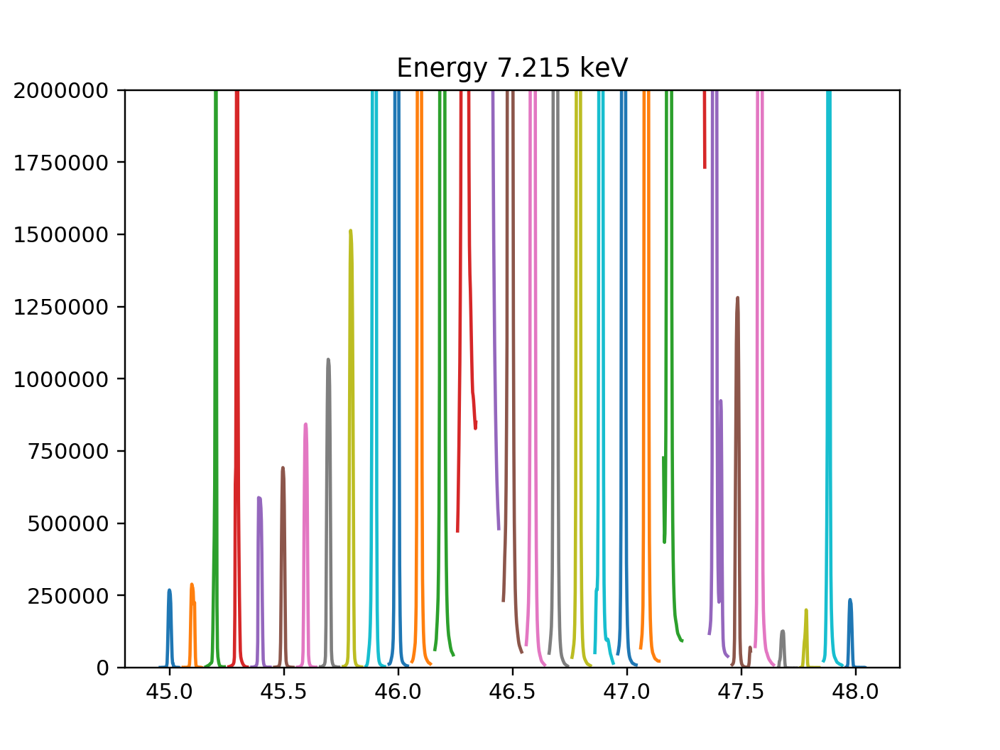

<IPython.core.display.Javascript object>


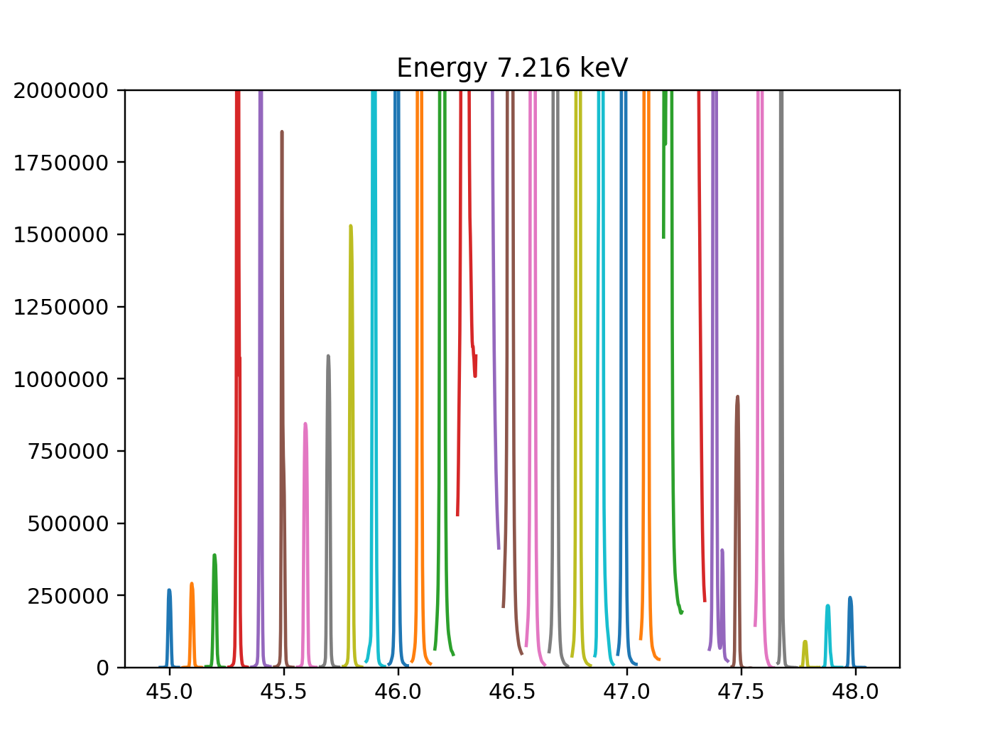

<IPython.core.display.Javascript object>


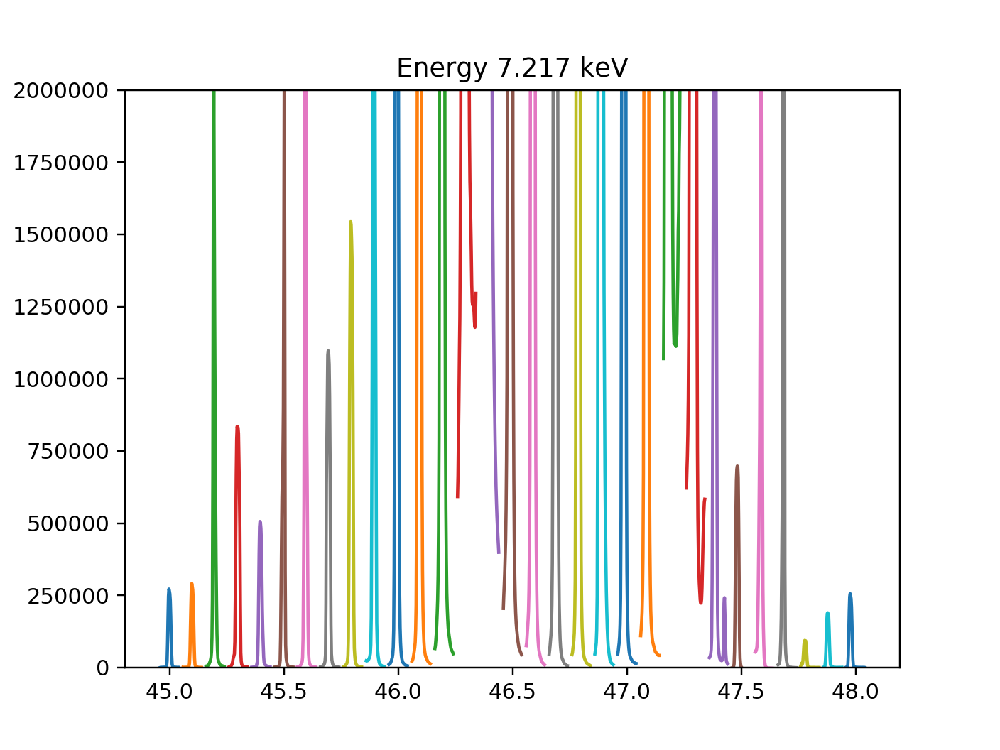

<IPython.core.display.Javascript object>


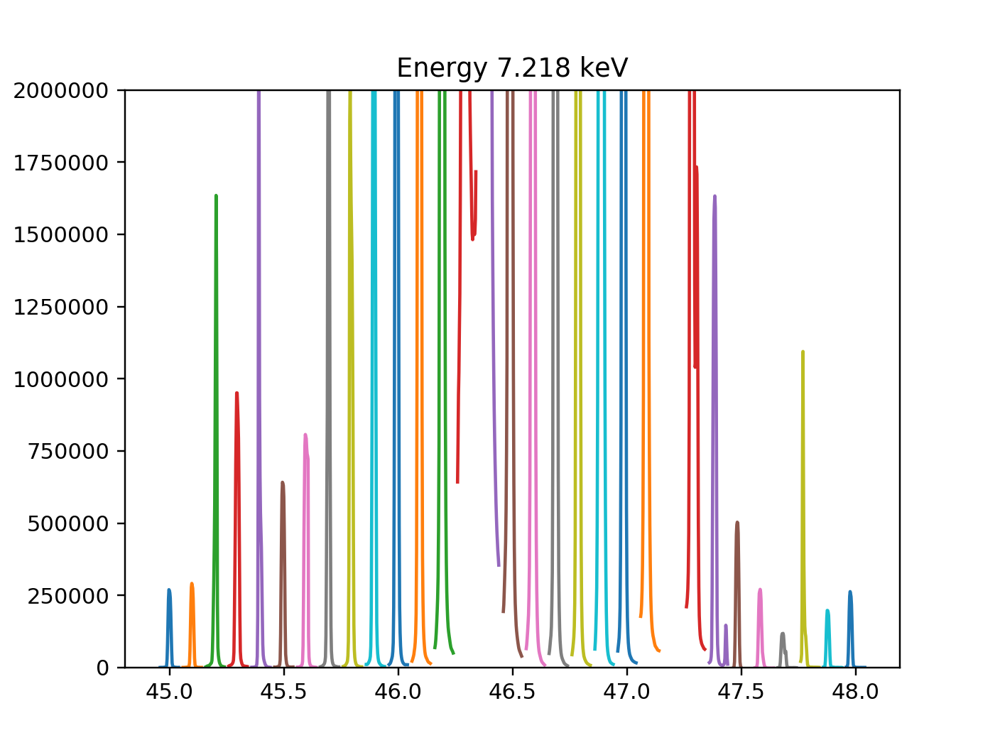

<IPython.core.display.Javascript object>


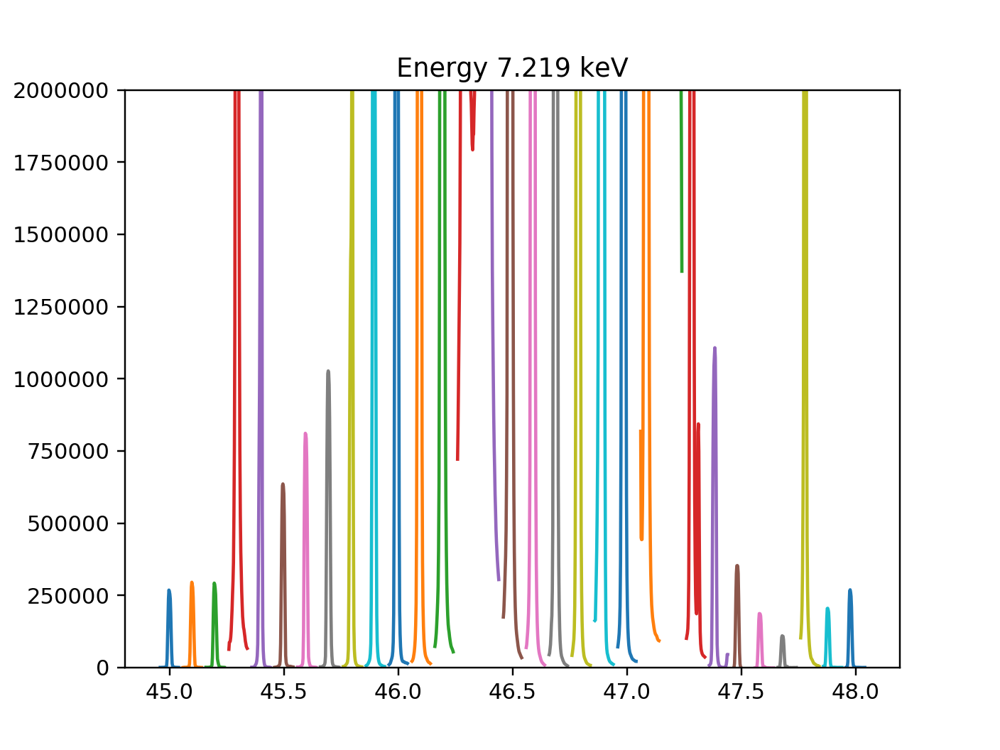

<IPython.core.display.Javascript object>


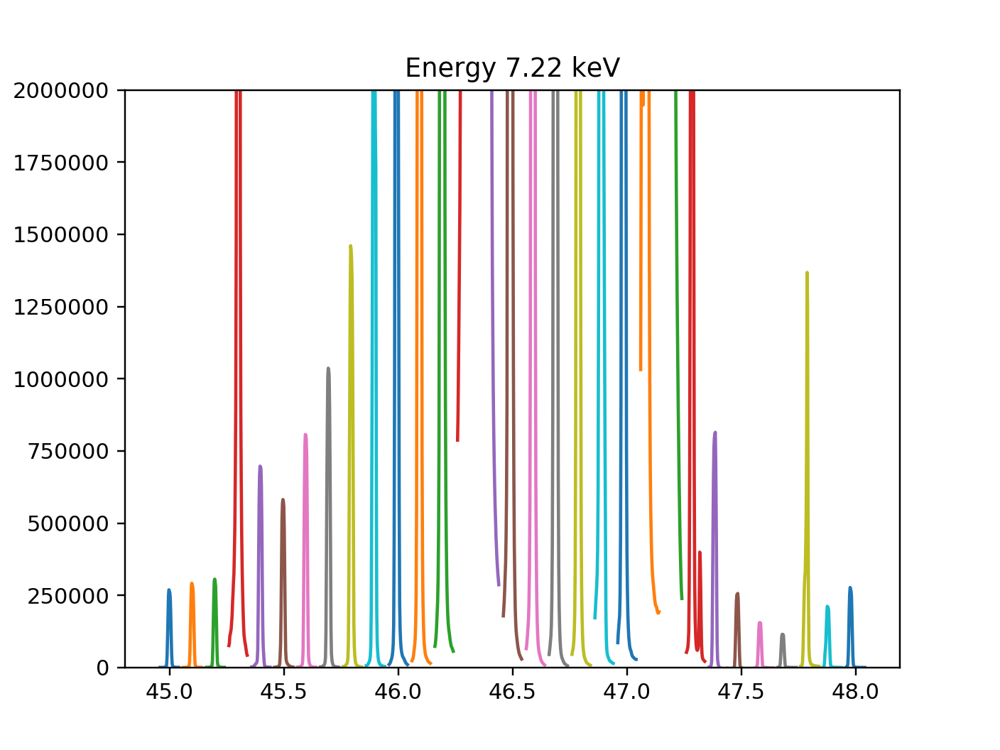

<IPython.core.display.Javascript object>


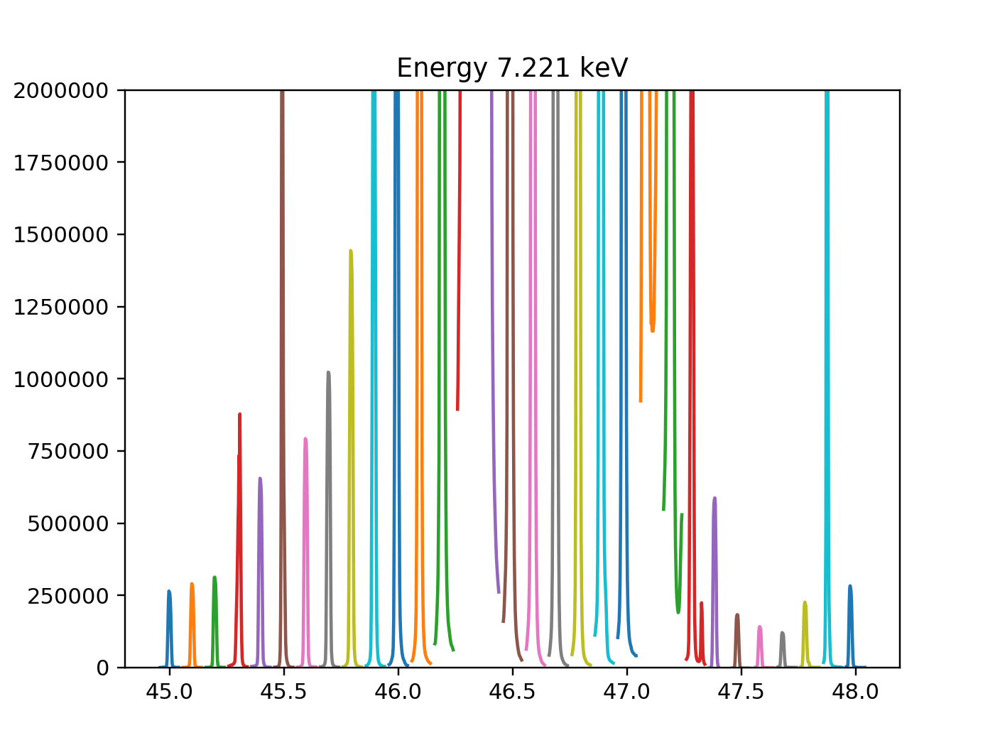

<IPython.core.display.Javascript object>


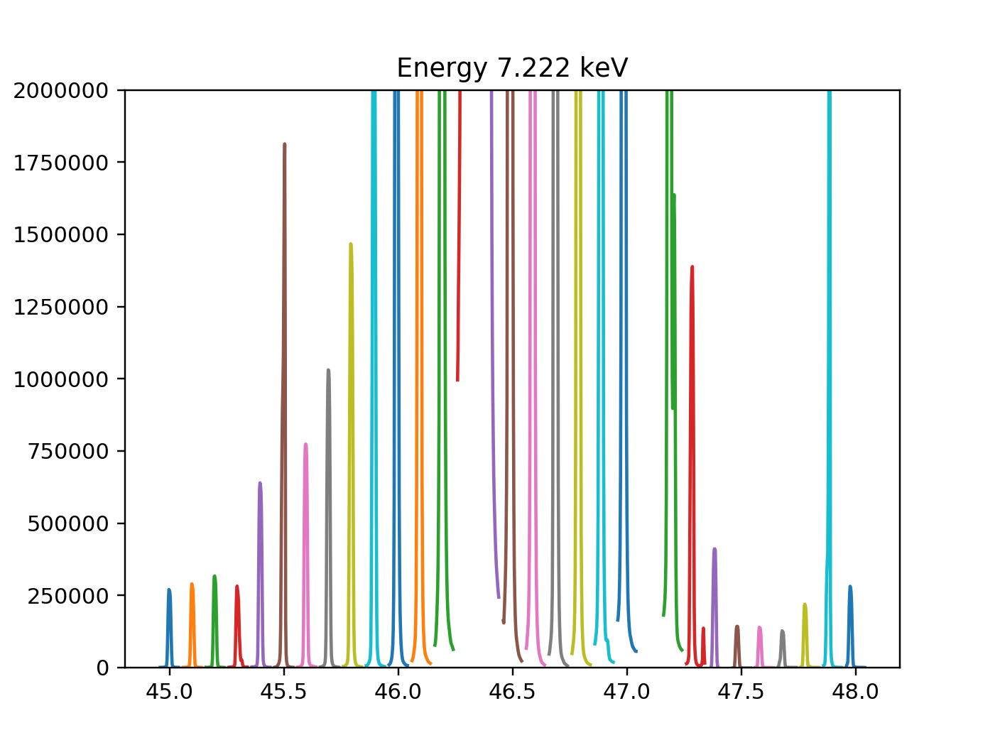

<IPython.core.display.Javascript object>


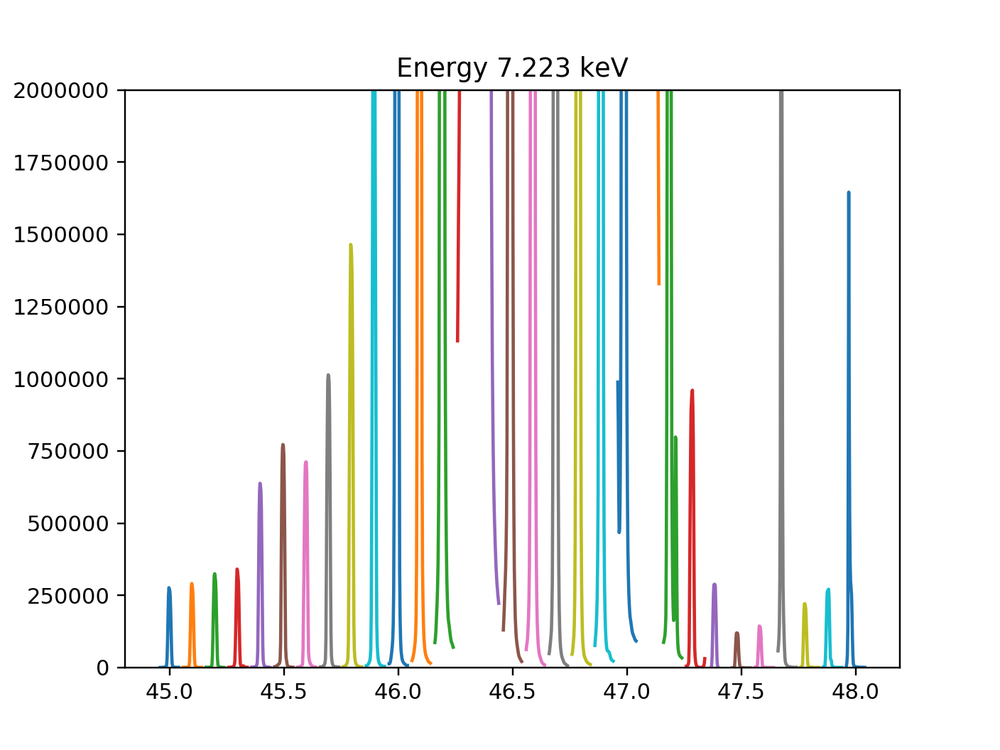

<IPython.core.display.Javascript object>


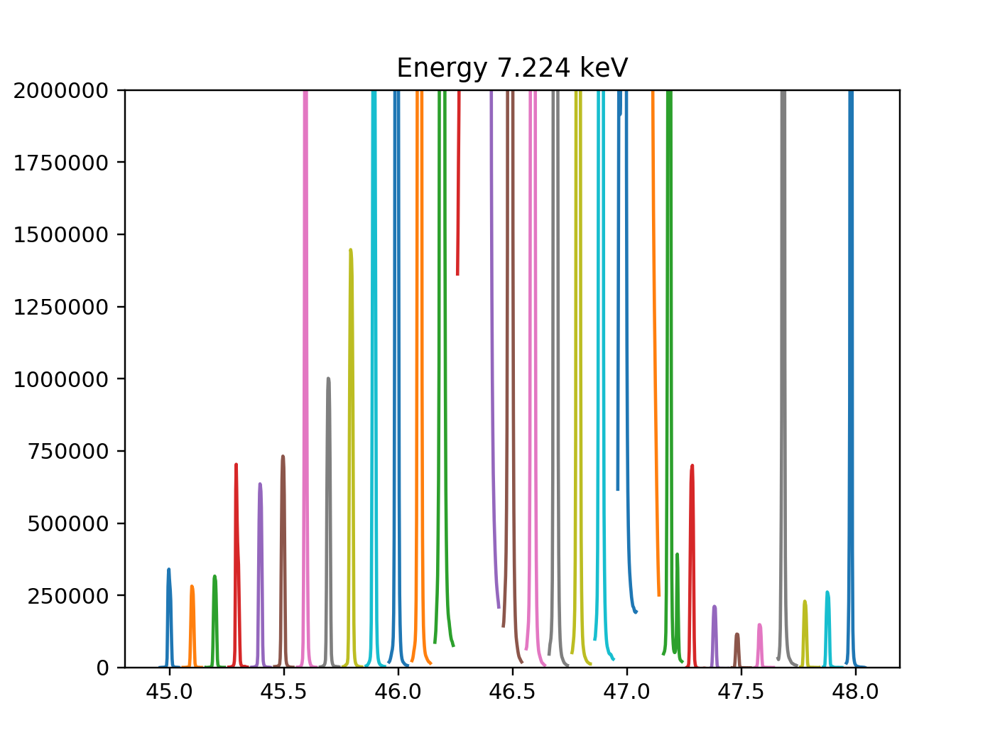

<IPython.core.display.Javascript object>


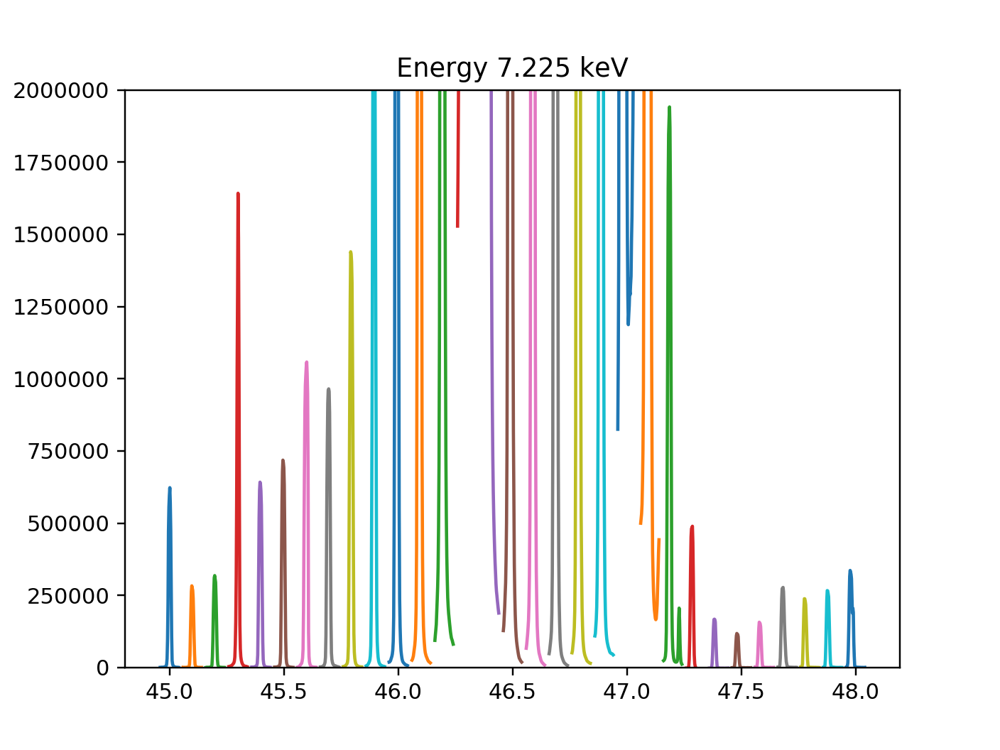

<IPython.core.display.Javascript object>


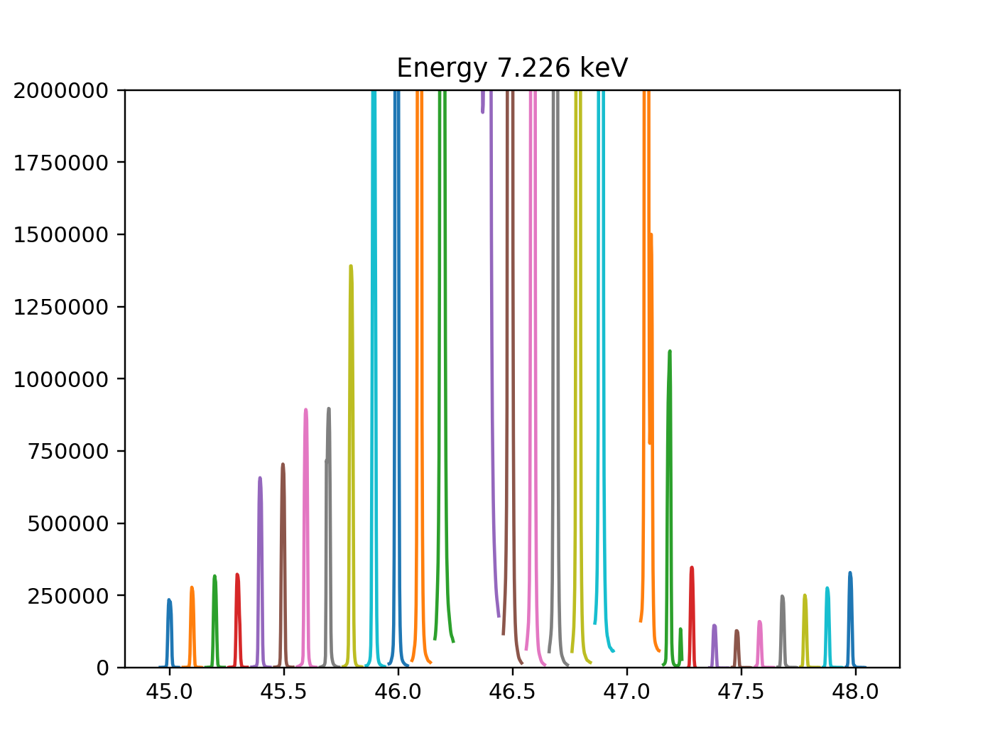

<IPython.core.display.Javascript object>


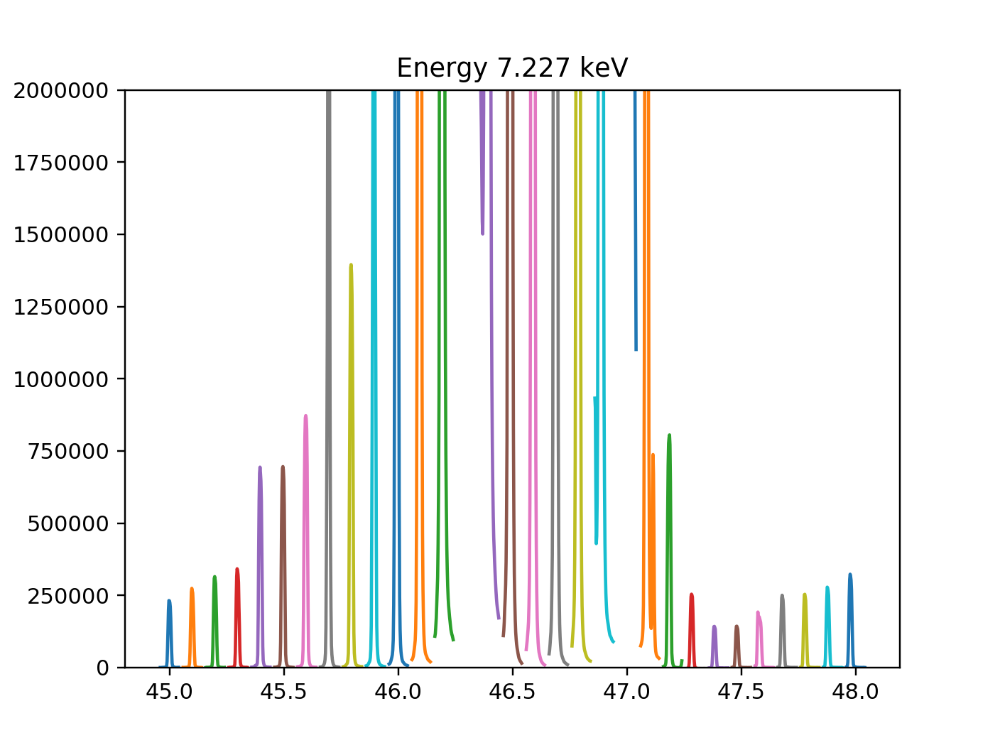

<IPython.core.display.Javascript object>


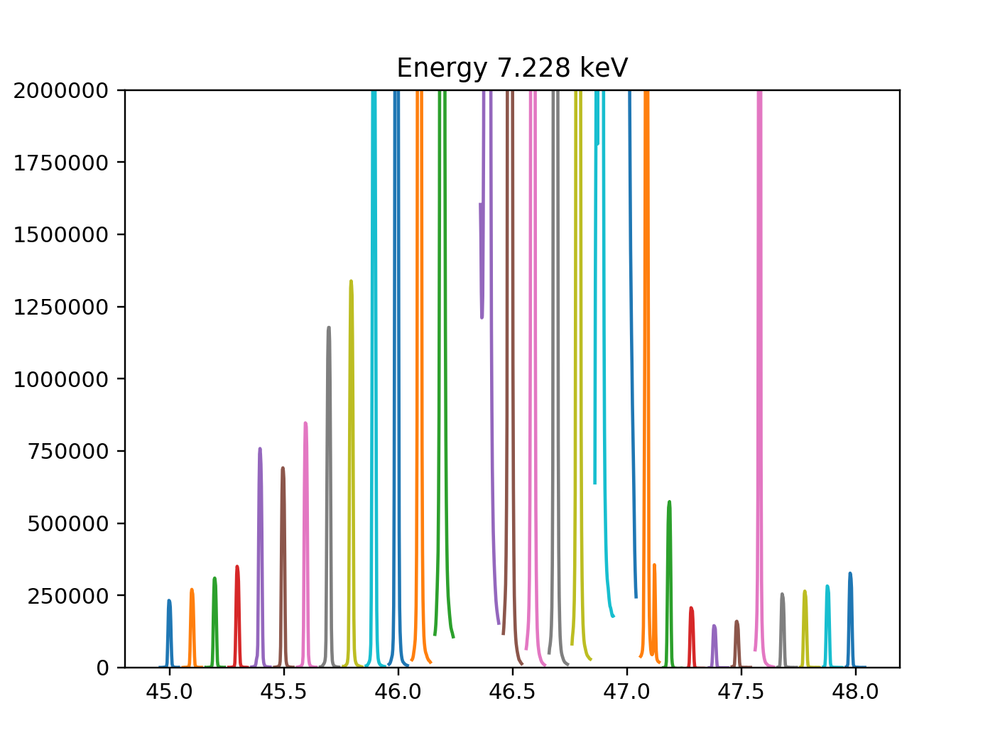

<IPython.core.display.Javascript object>


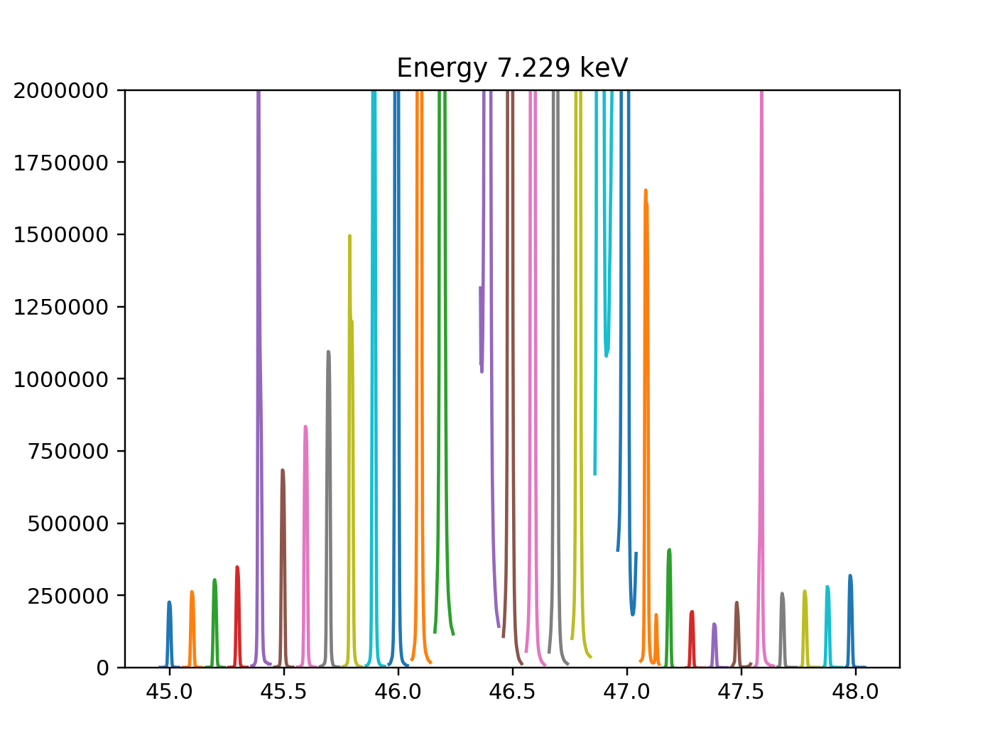

<IPython.core.display.Javascript object>


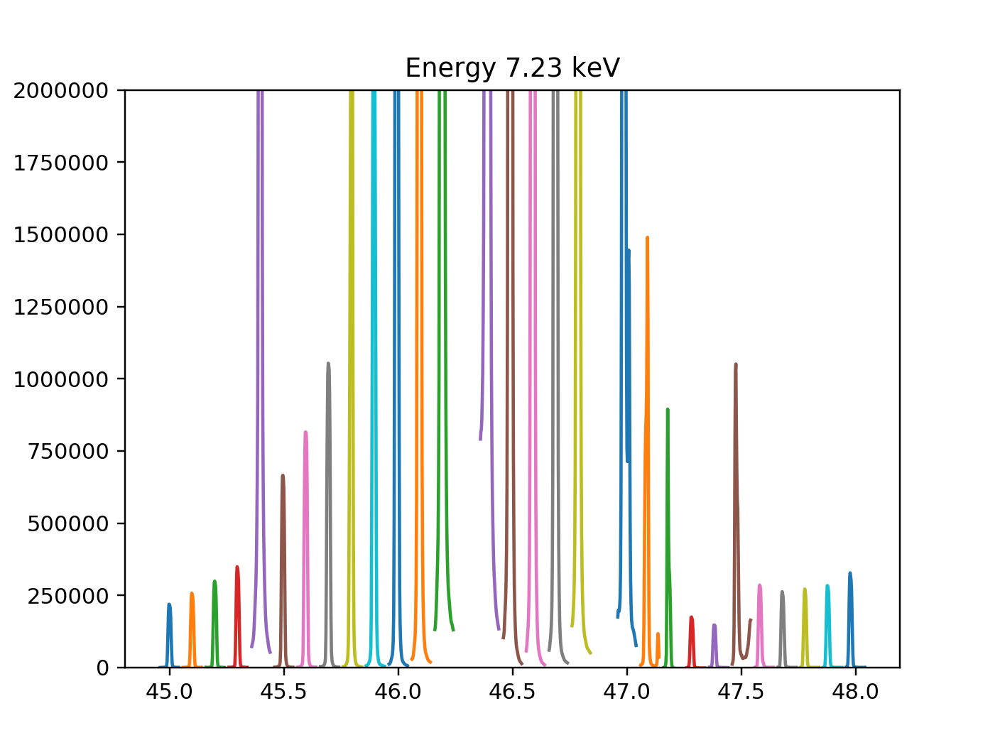

<IPython.core.display.Javascript object>


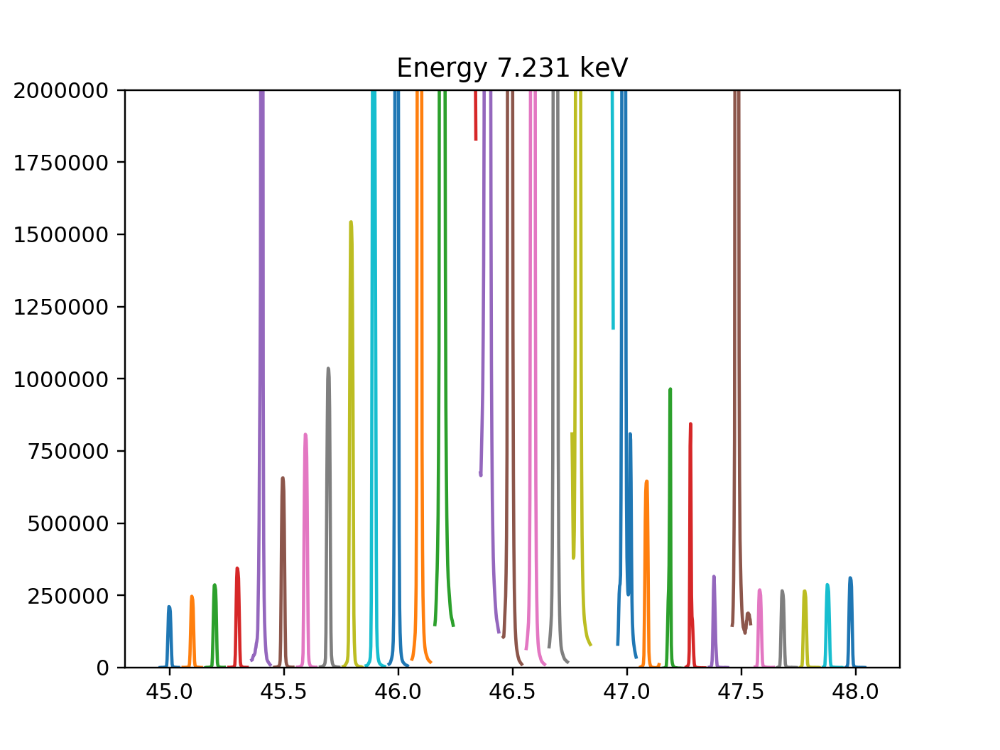

<IPython.core.display.Javascript object>


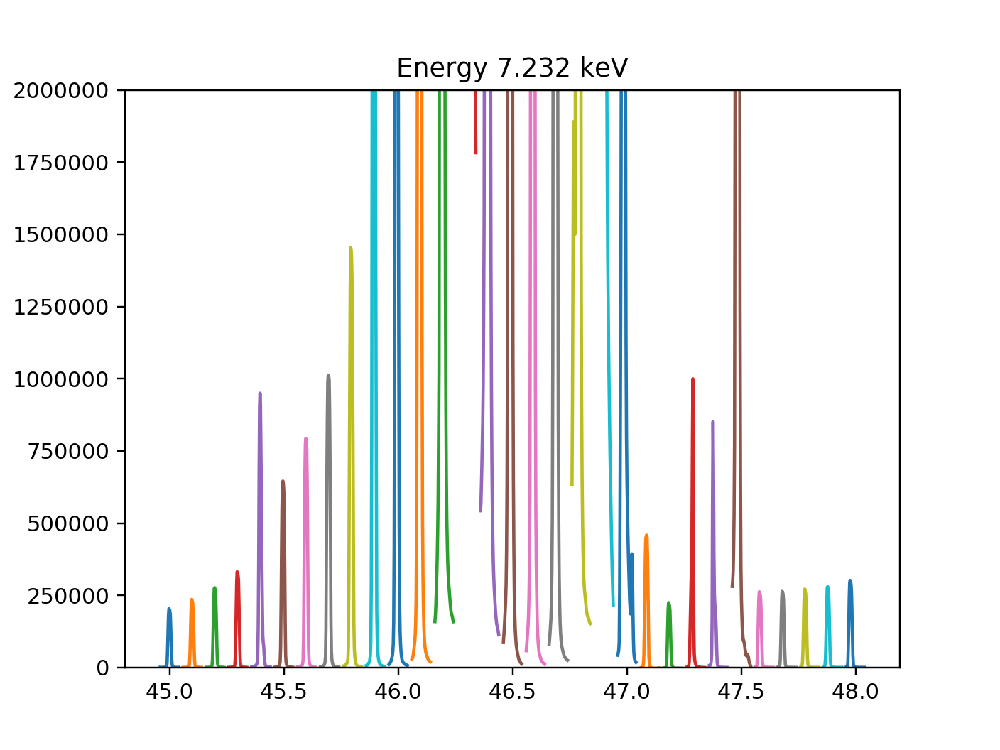

<IPython.core.display.Javascript object>


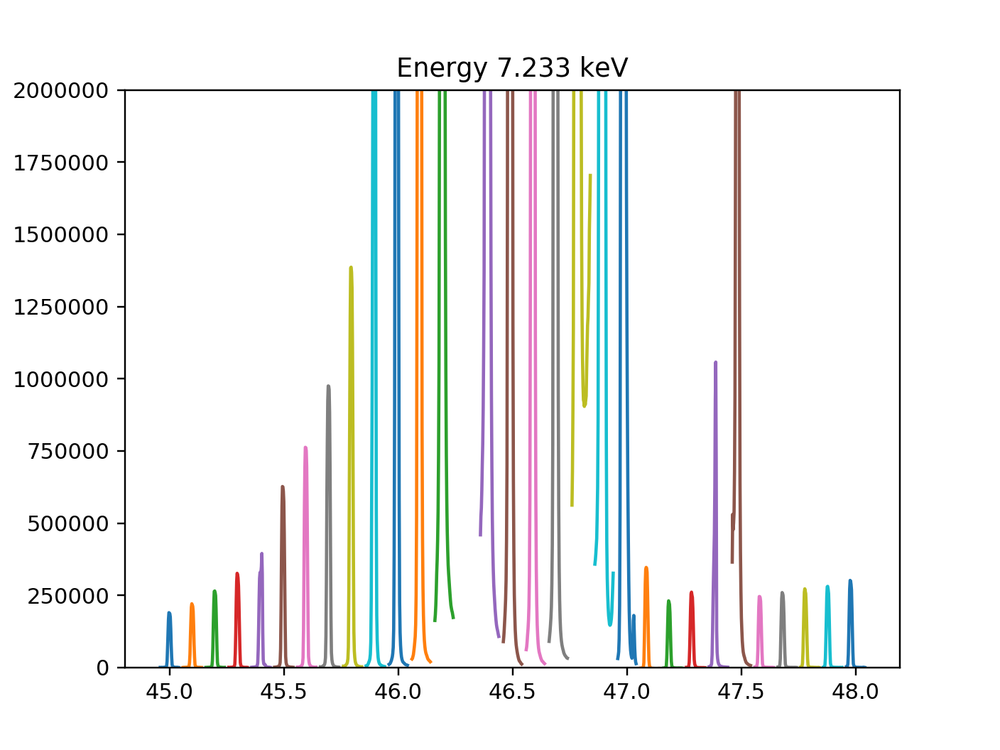

<IPython.core.display.Javascript object>


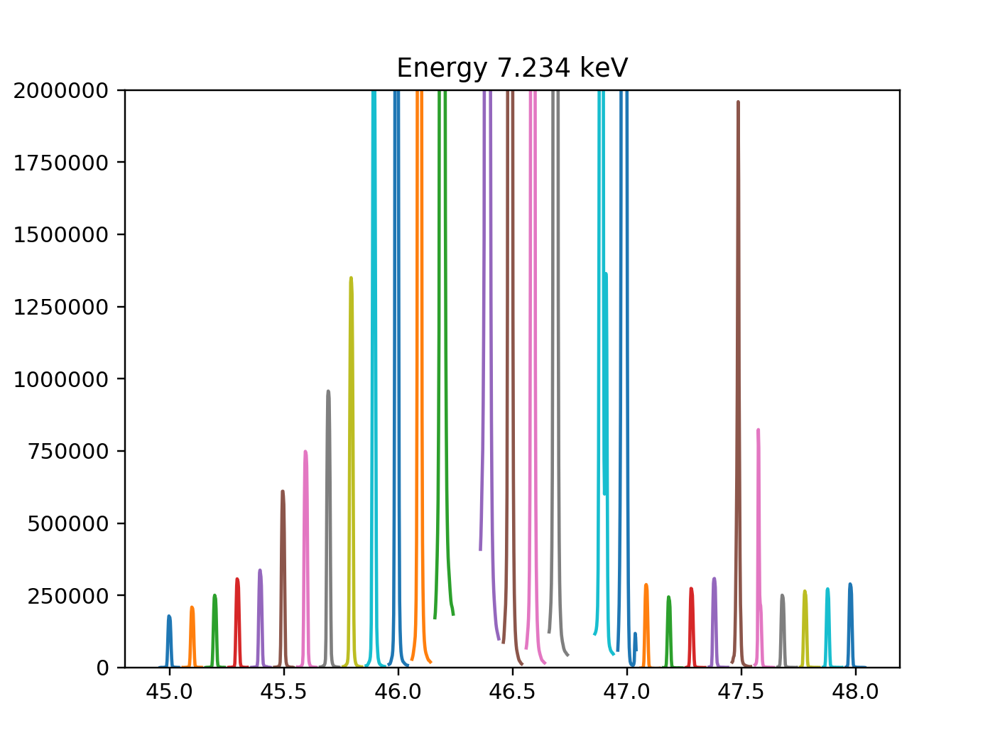

<IPython.core.display.Javascript object>


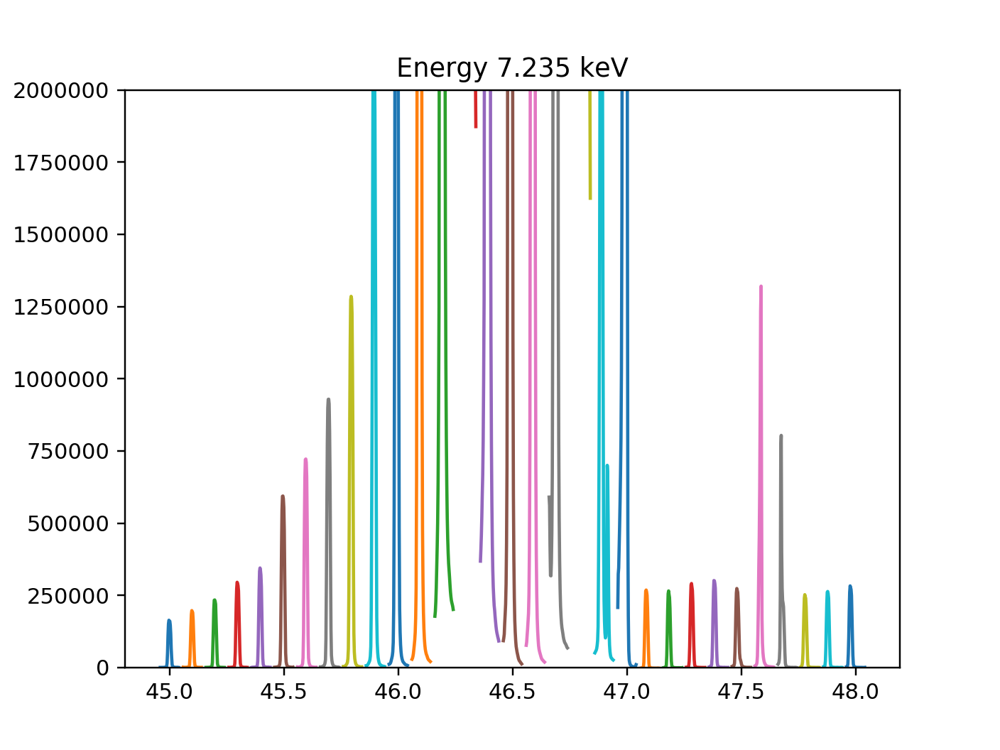

<IPython.core.display.Javascript object>


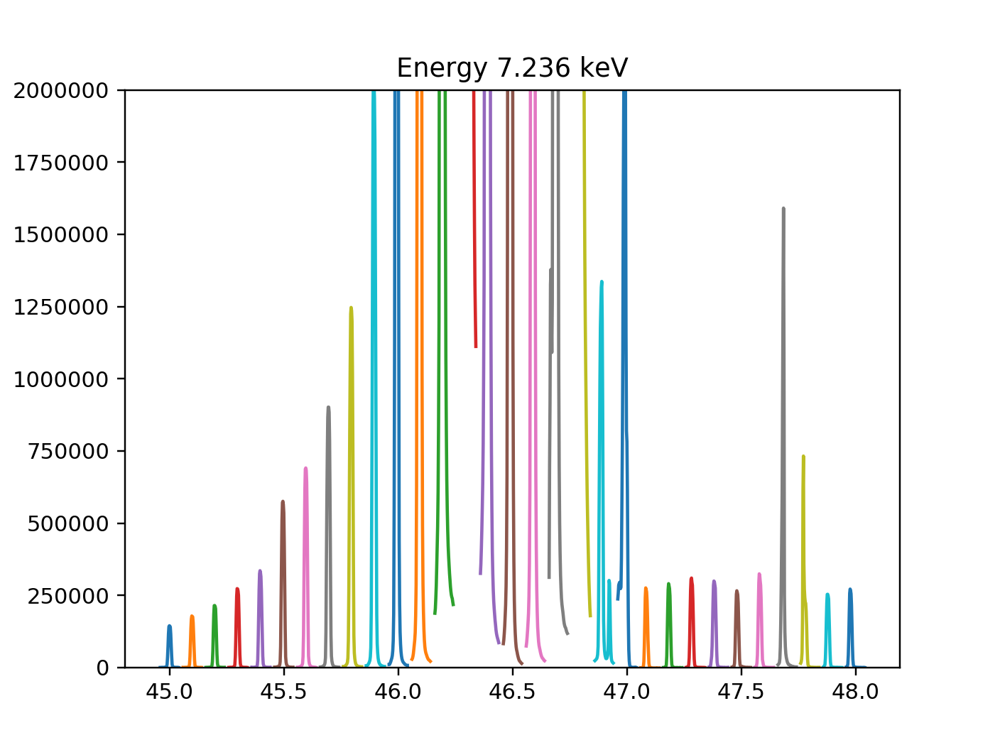

<IPython.core.display.Javascript object>


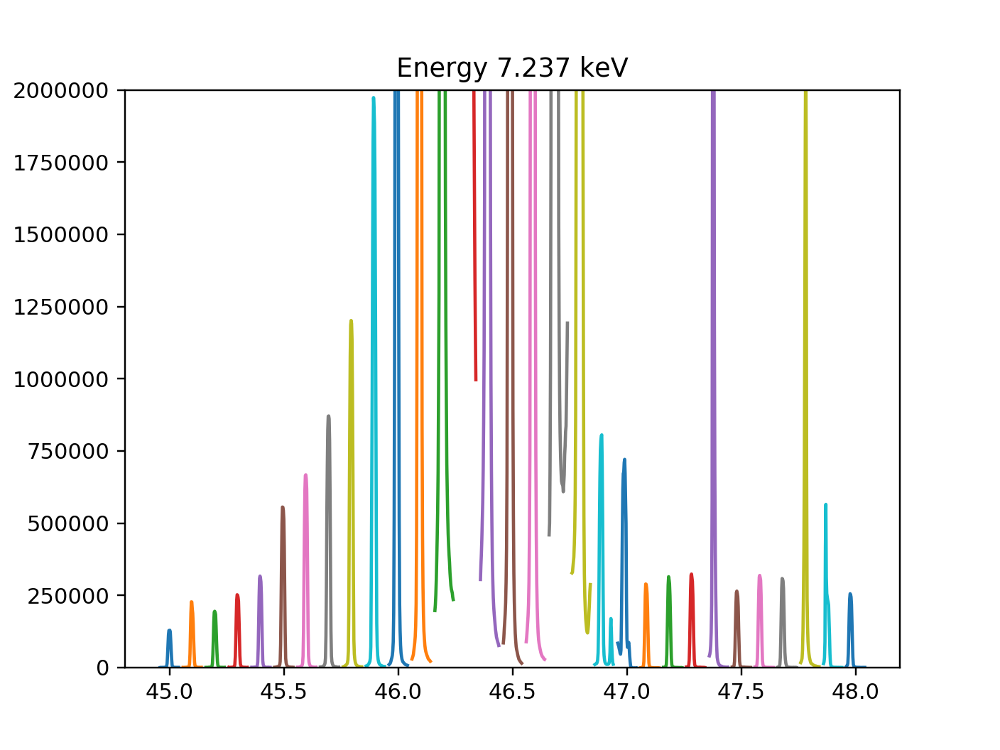

<IPython.core.display.Javascript object>


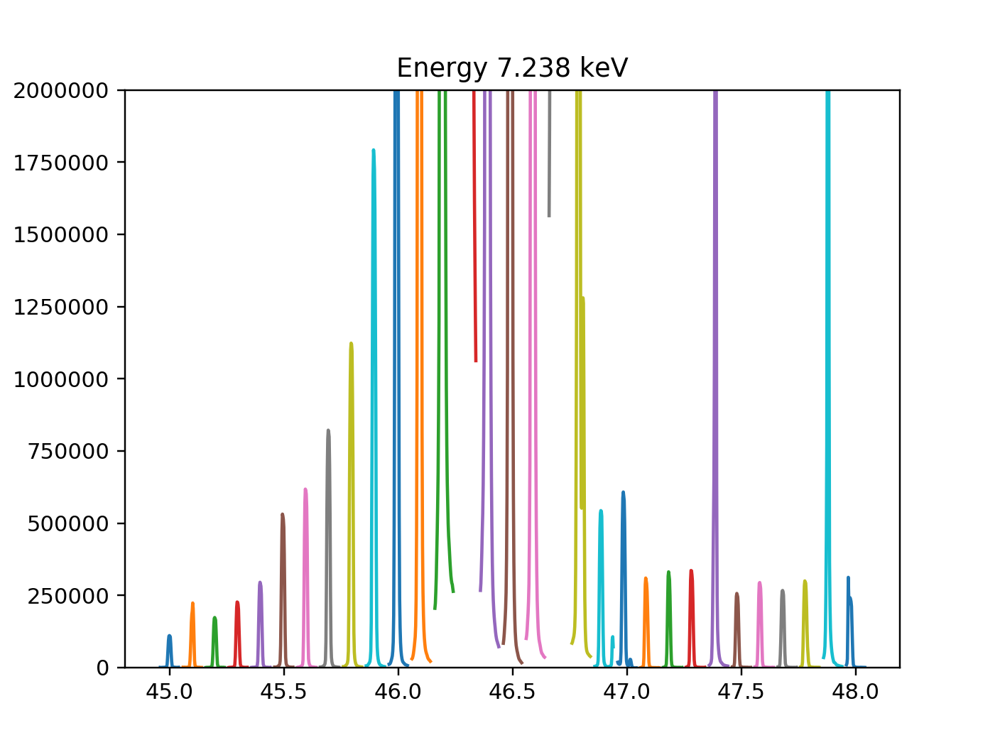

<IPython.core.display.Javascript object>


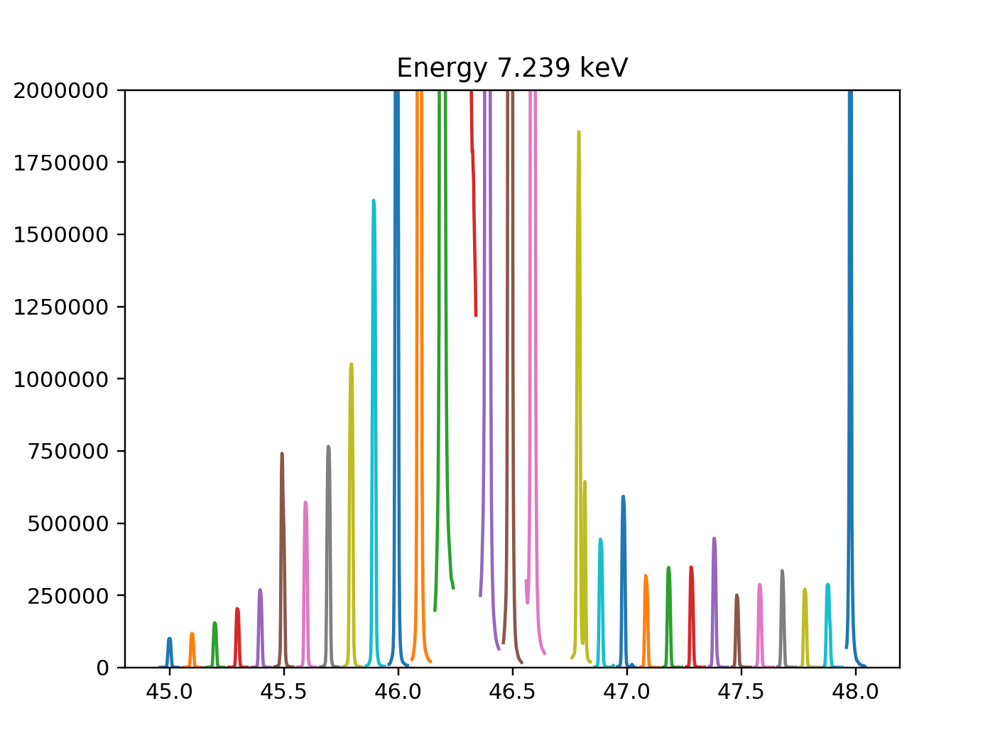

<IPython.core.display.Javascript object>


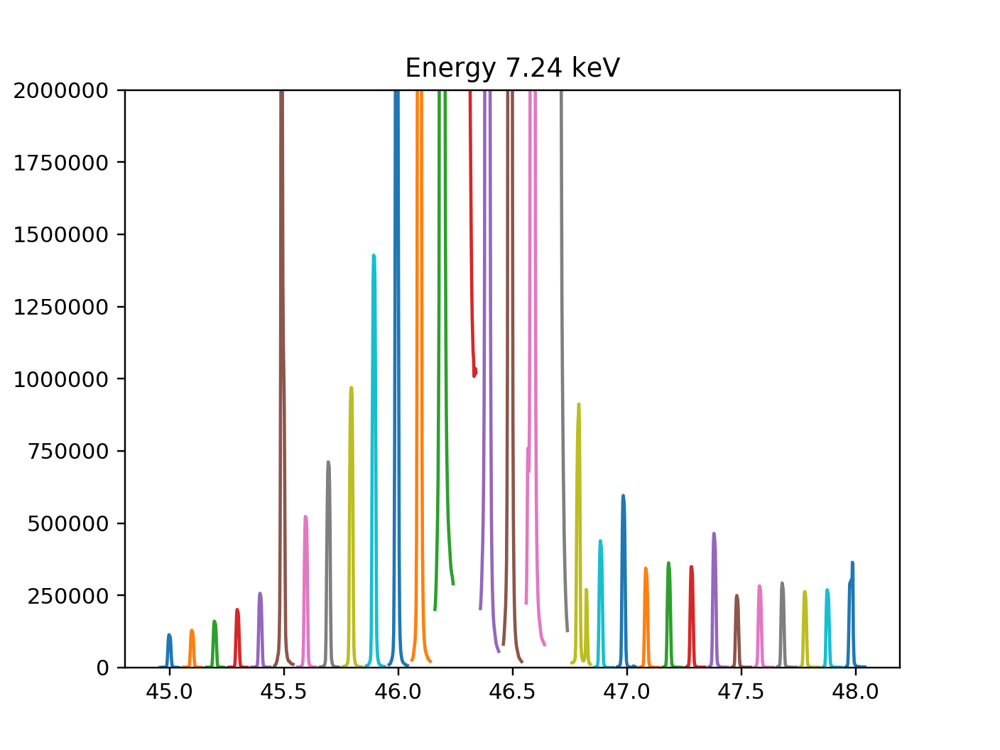

<IPython.core.display.Javascript object>


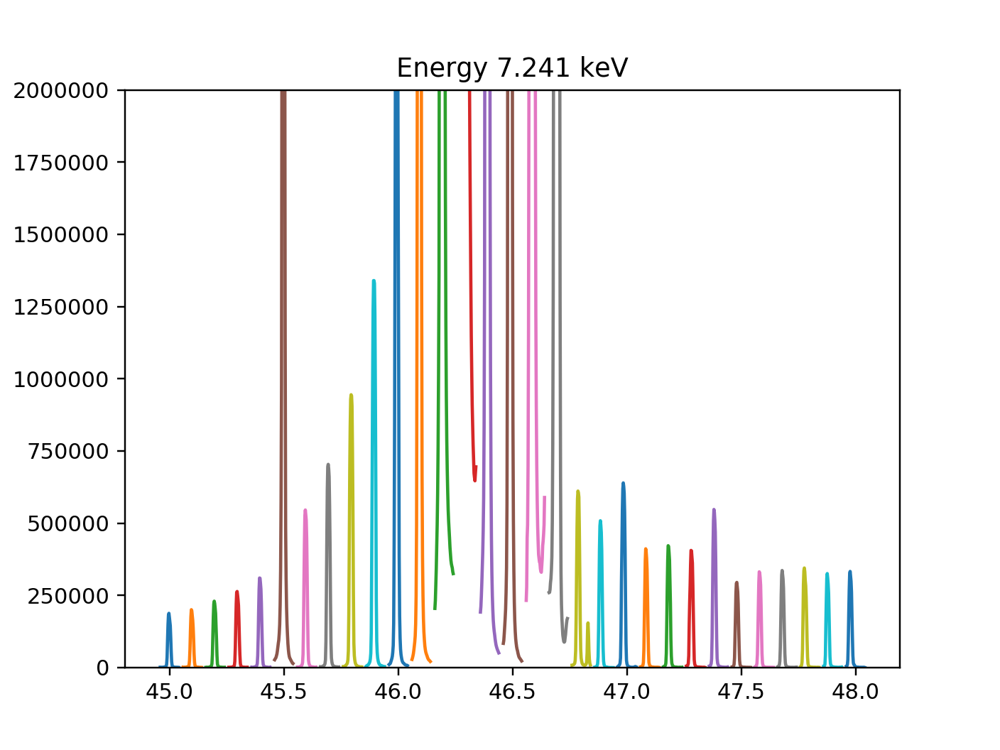

<IPython.core.display.Javascript object>


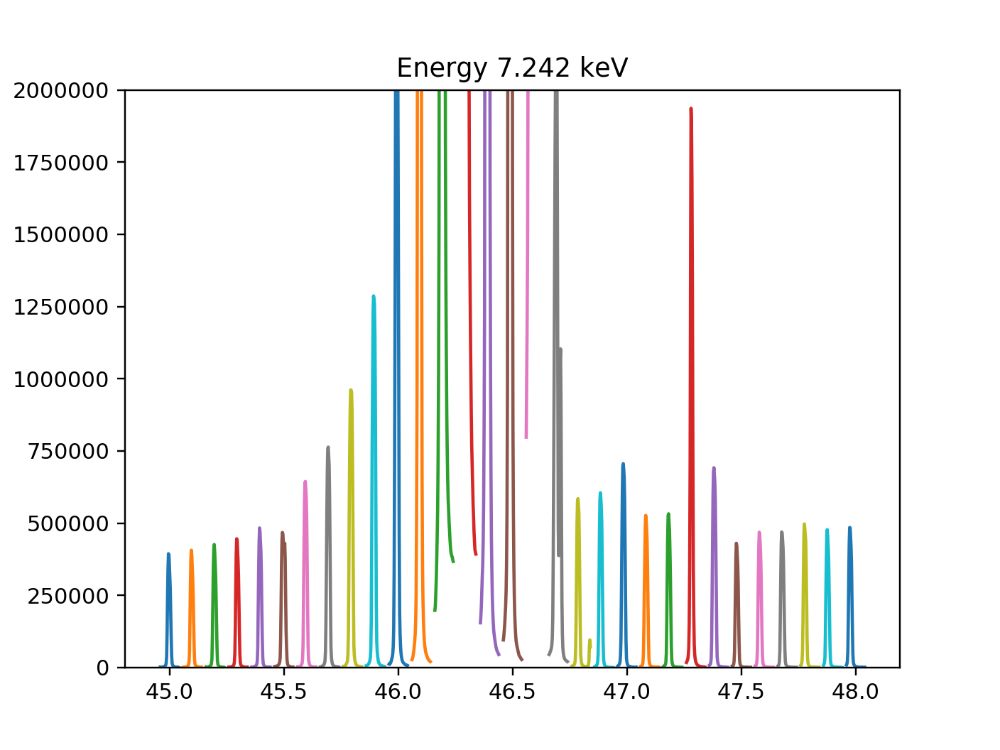

<IPython.core.display.Javascript object>


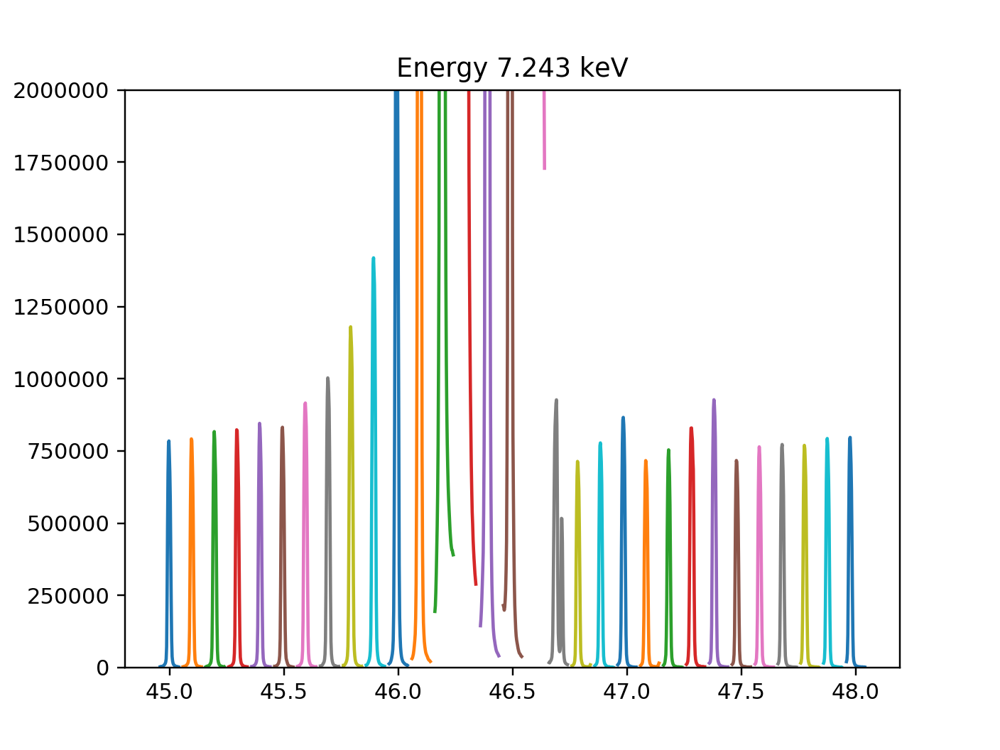

<IPython.core.display.Javascript object>


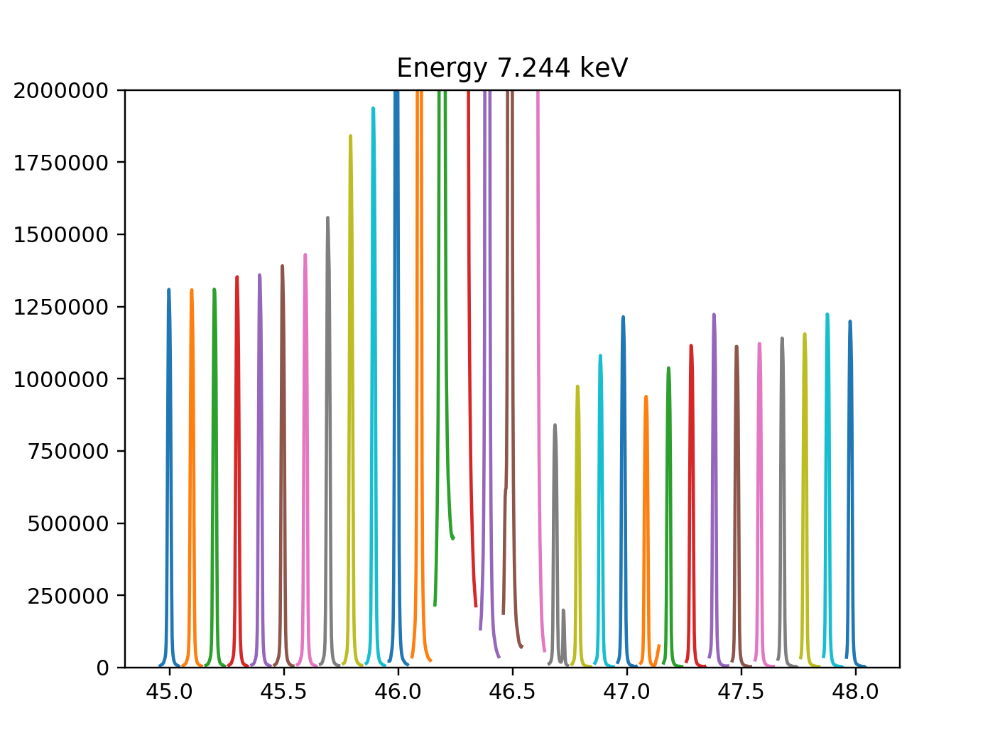

<IPython.core.display.Javascript object>


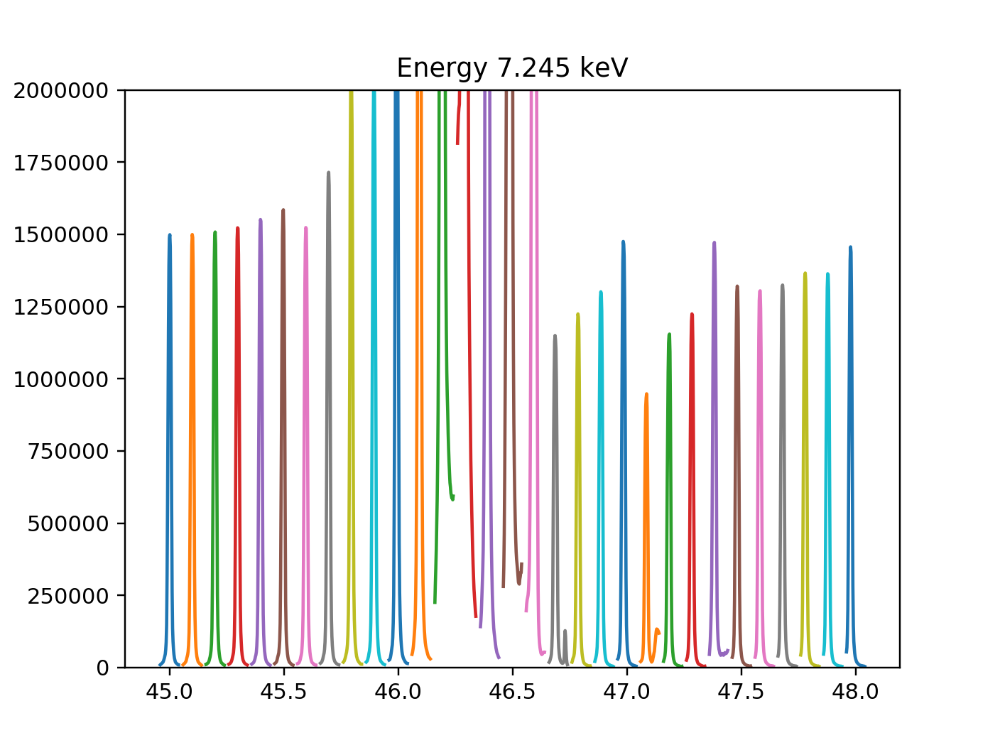

<IPython.core.display.Javascript object>


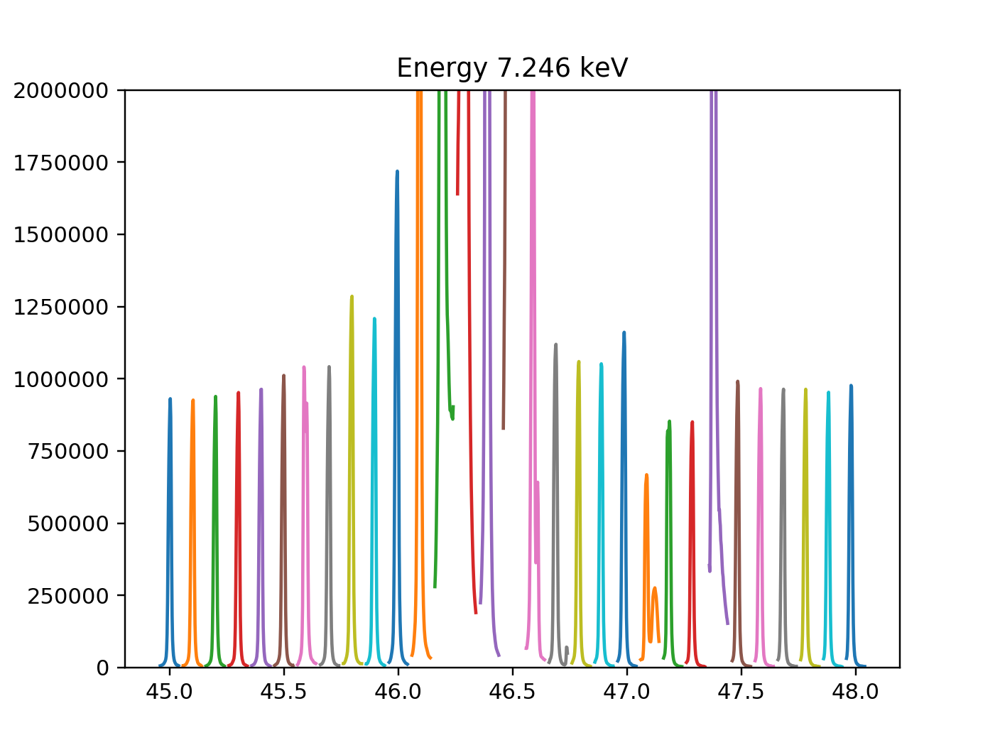

<IPython.core.display.Javascript object>


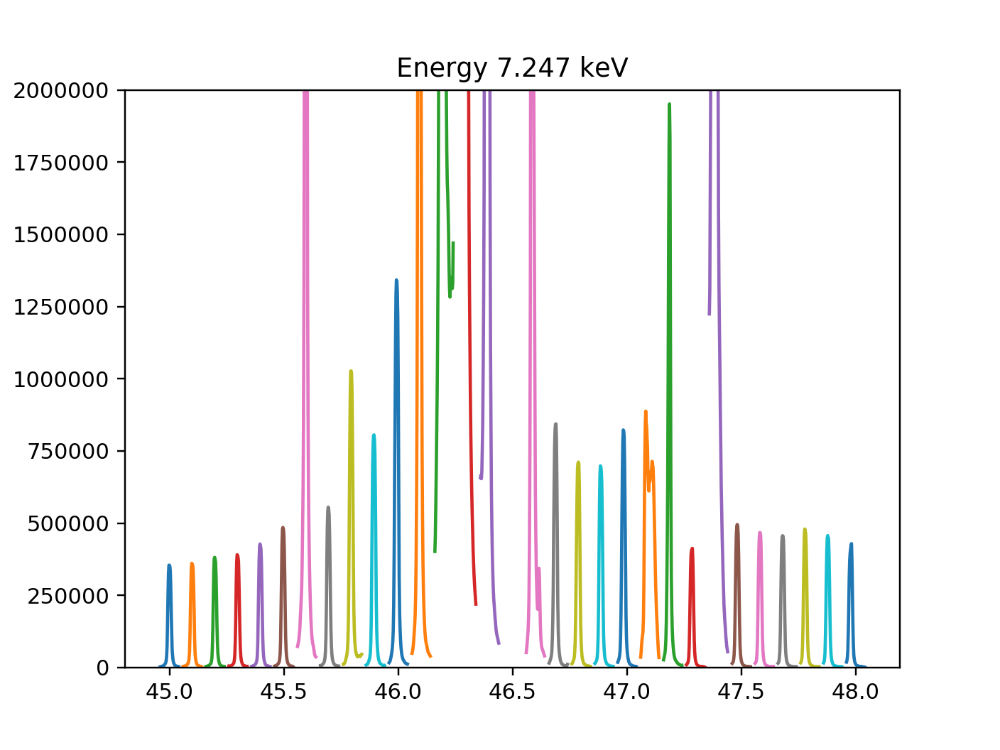

<IPython.core.display.Javascript object>


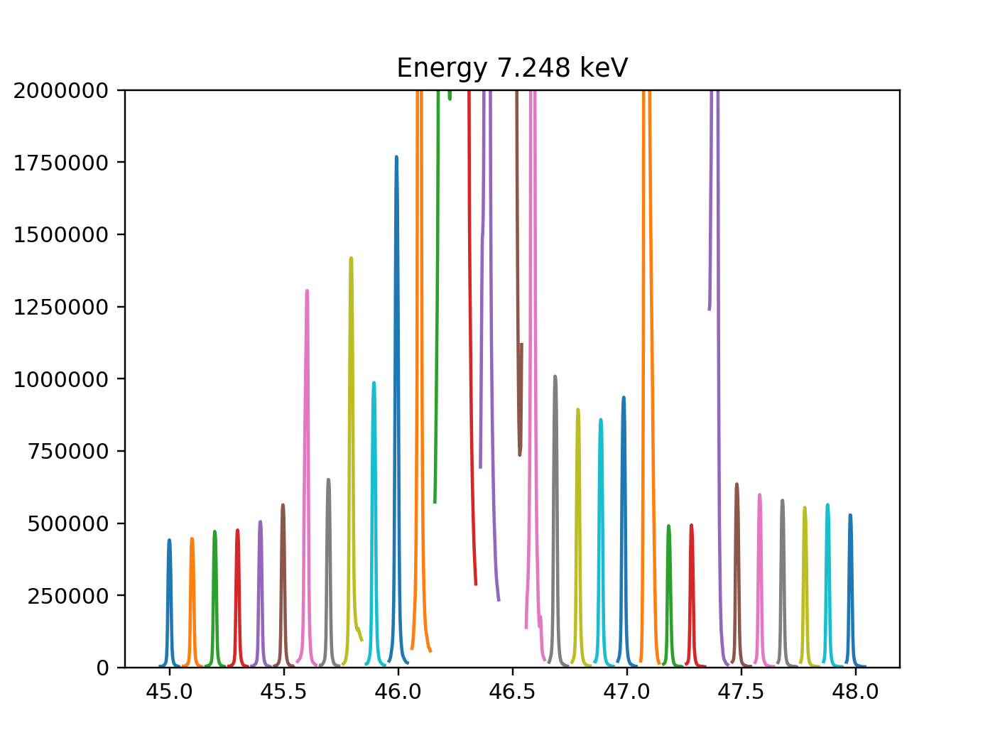

<IPython.core.display.Javascript object>


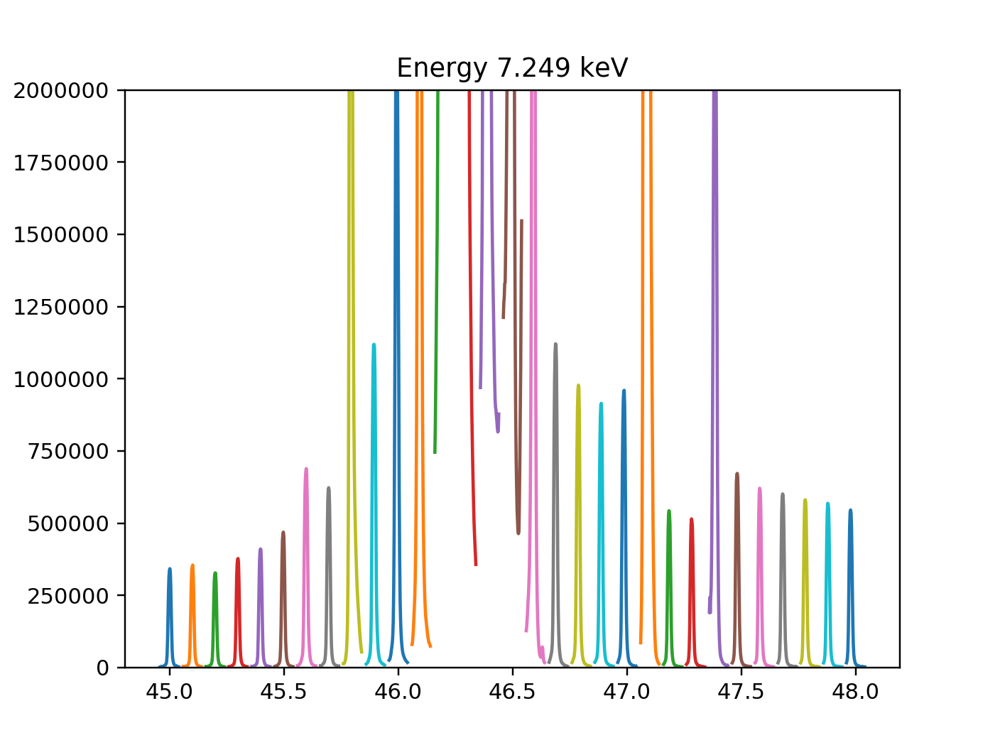

<IPython.core.display.Javascript object>


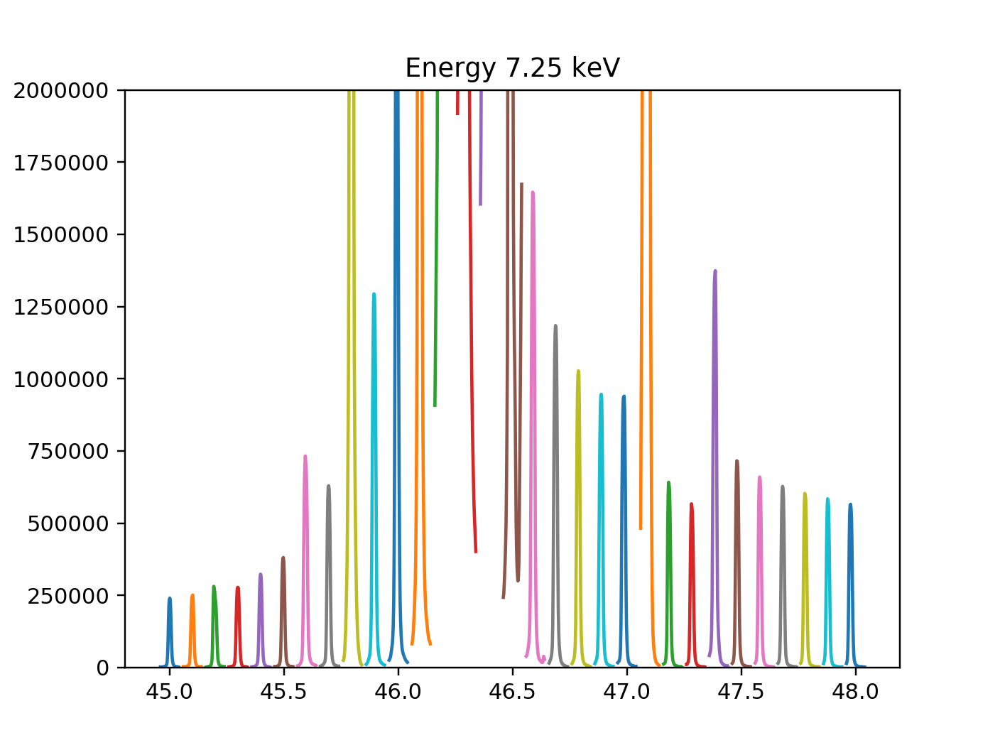

<IPython.core.display.Javascript object>


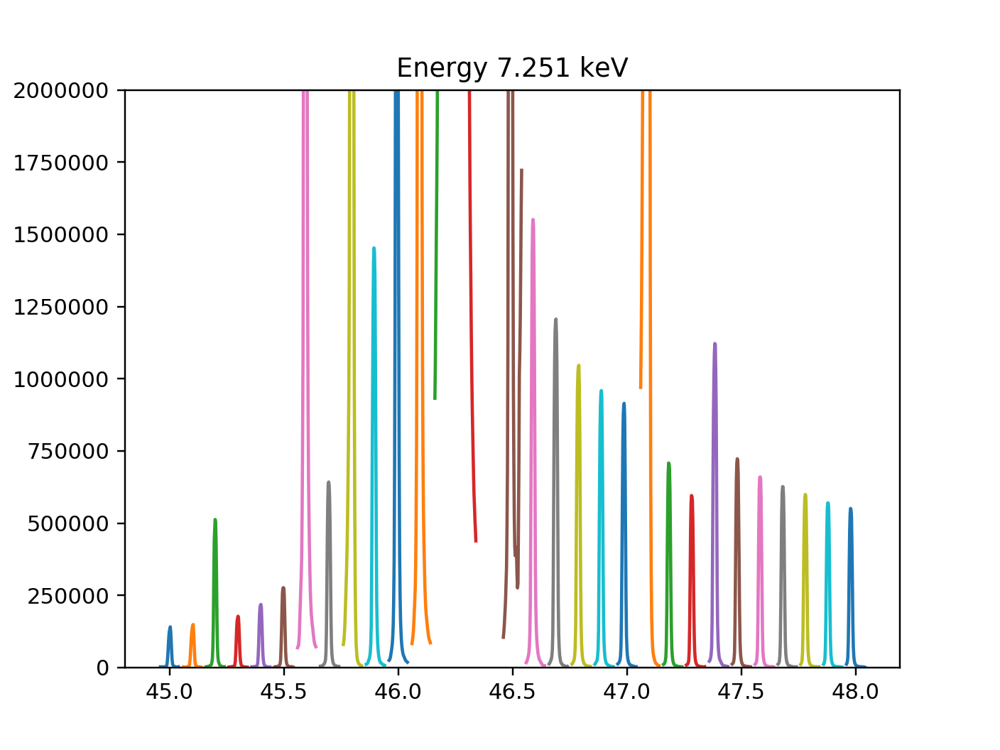

<IPython.core.display.Javascript object>


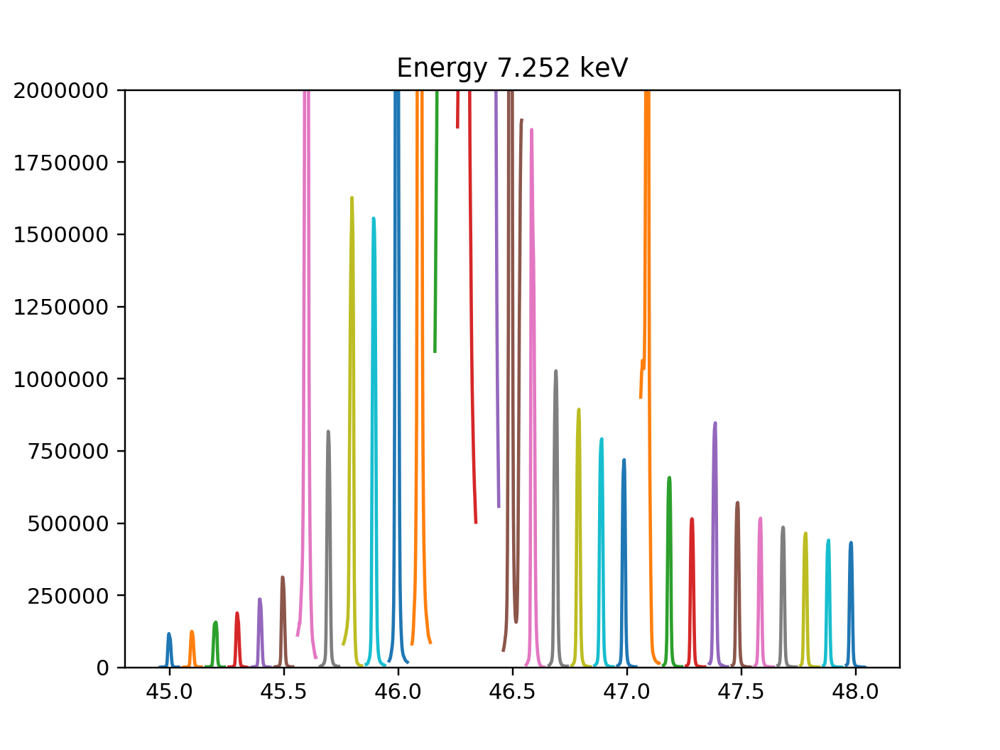

<IPython.core.display.Javascript object>


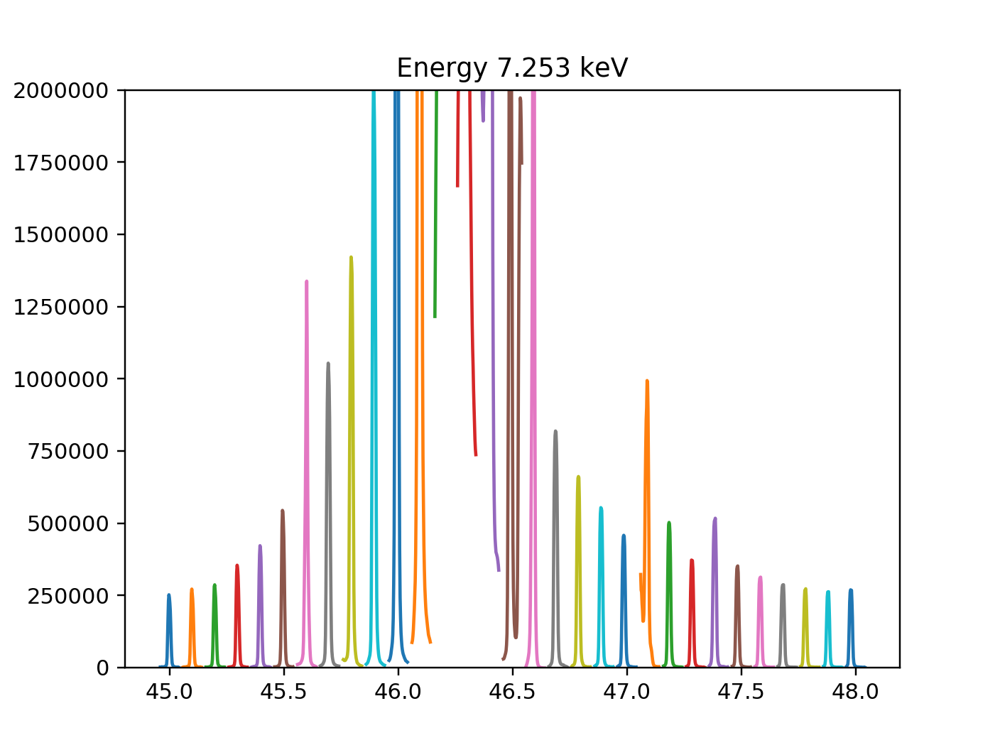

<IPython.core.display.Javascript object>


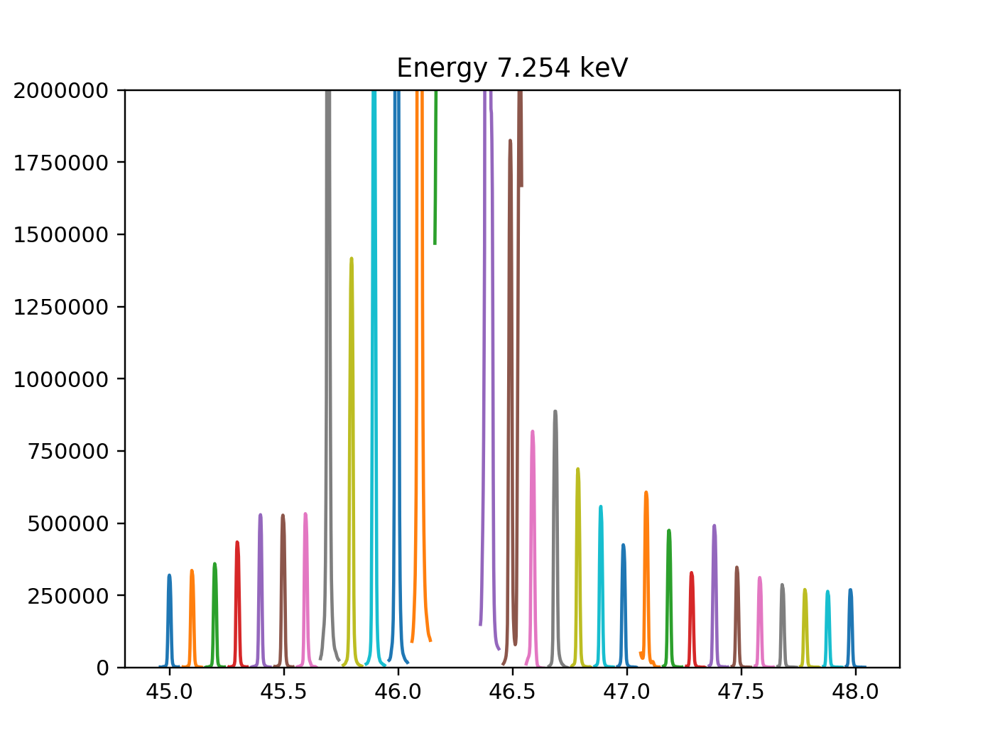

<IPython.core.display.Javascript object>


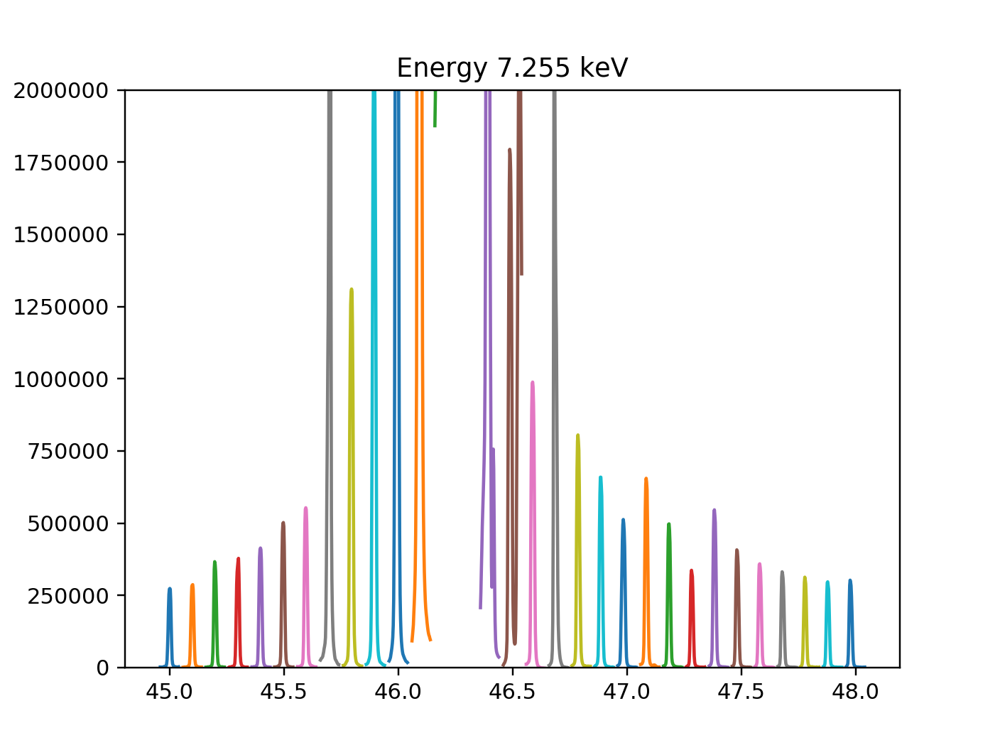

<IPython.core.display.Javascript object>


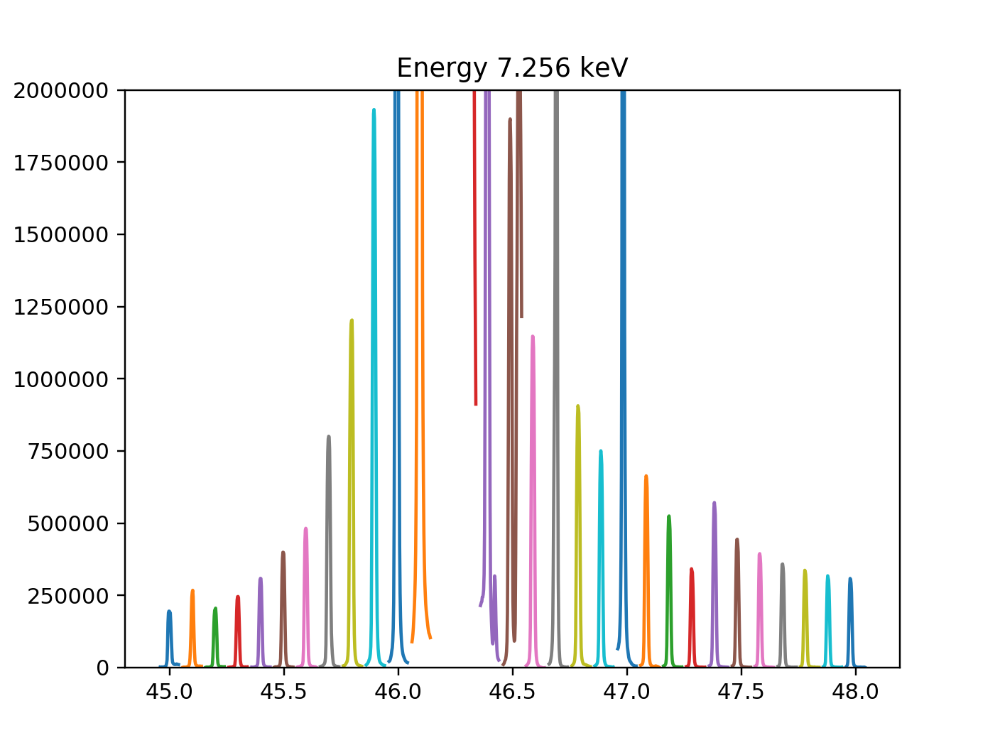

<IPython.core.display.Javascript object>


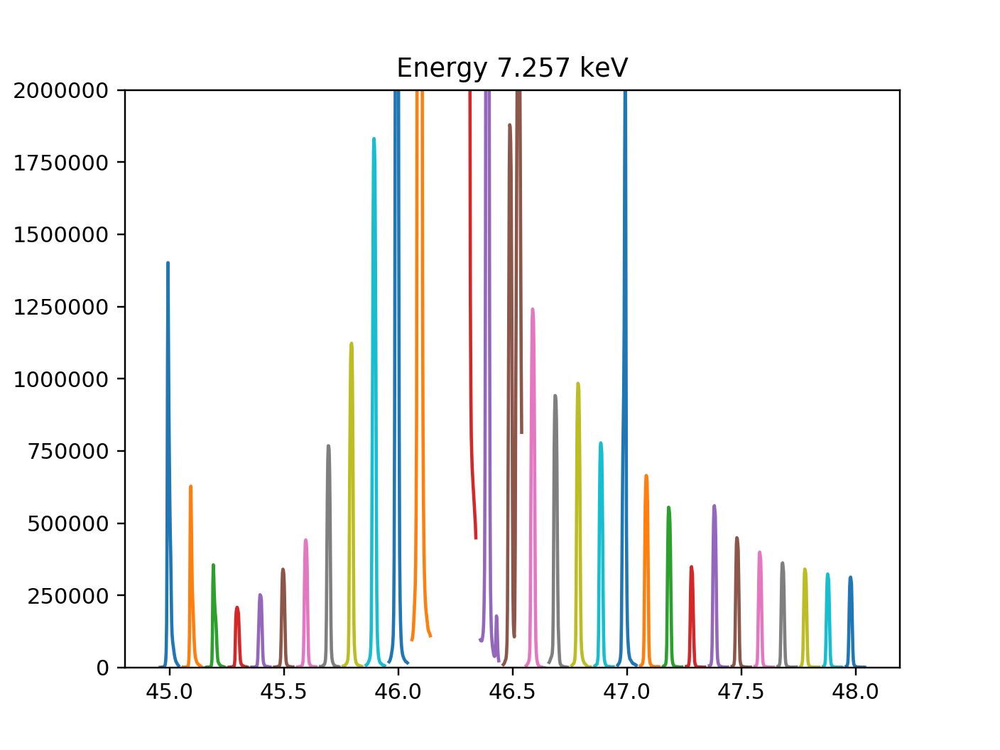

<IPython.core.display.Javascript object>


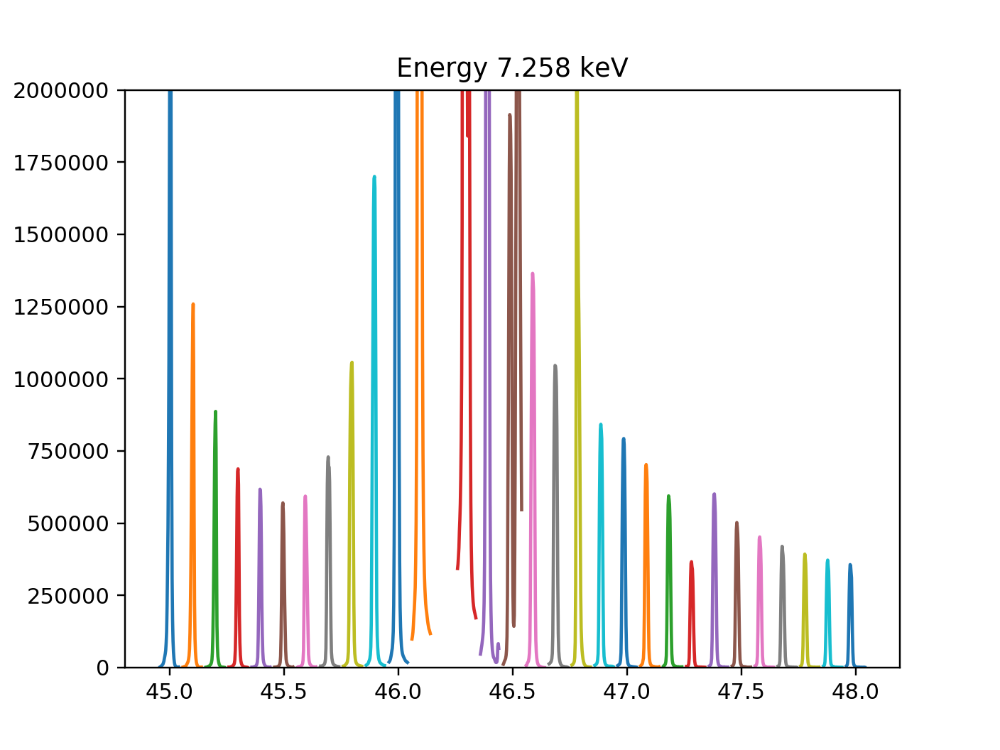

<IPython.core.display.Javascript object>


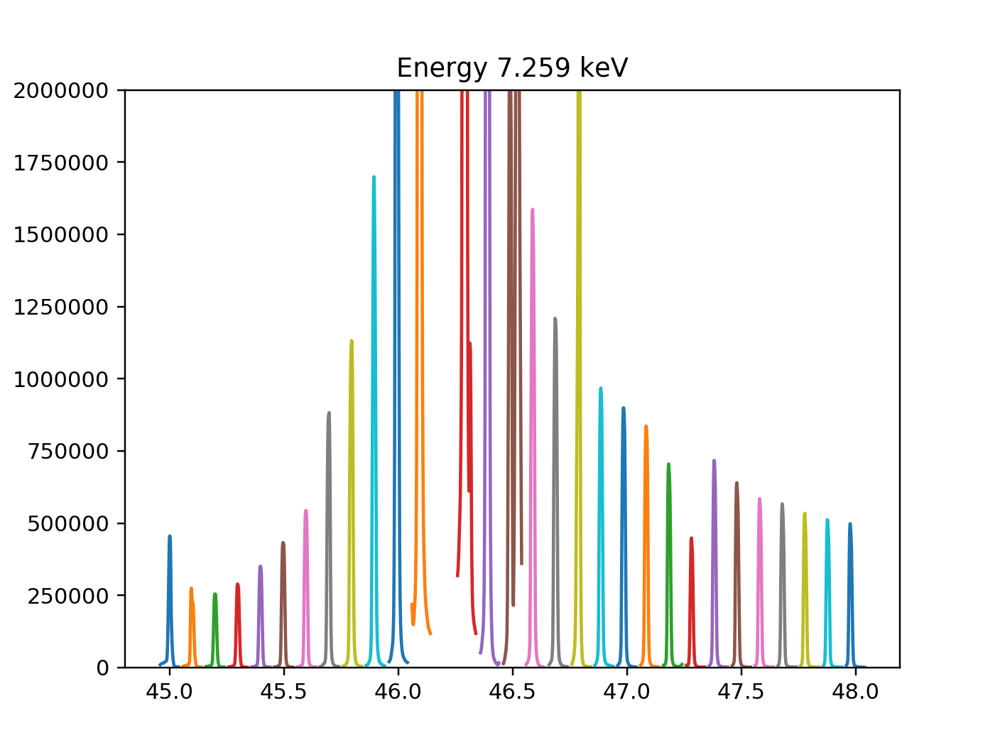

<IPython.core.display.Javascript object>


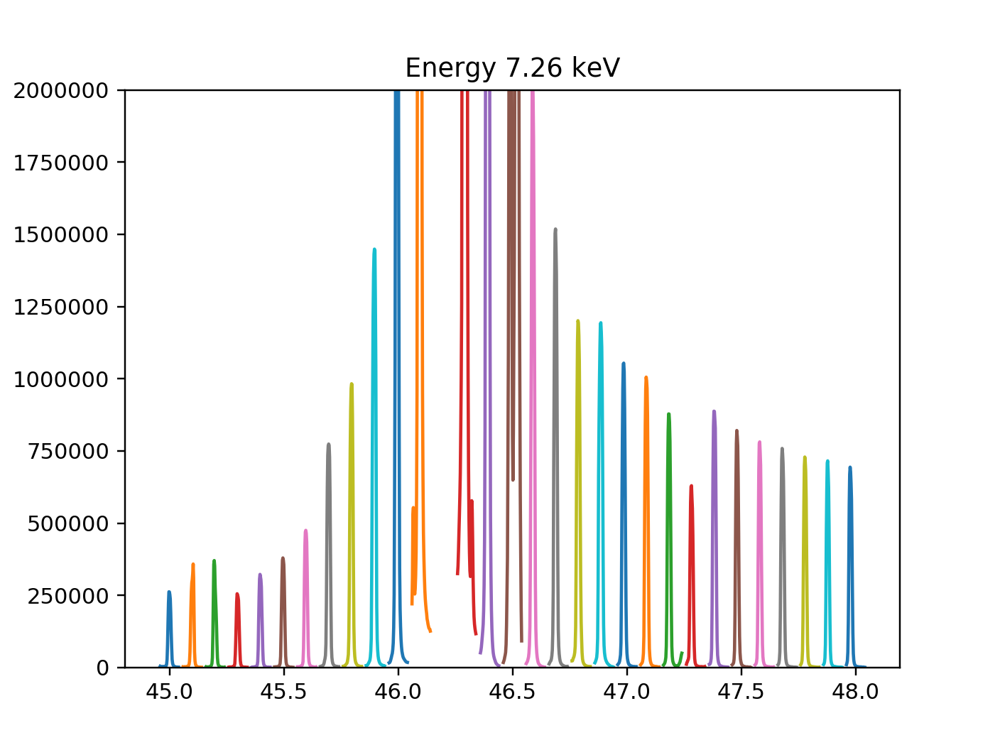

<IPython.core.display.Javascript object>


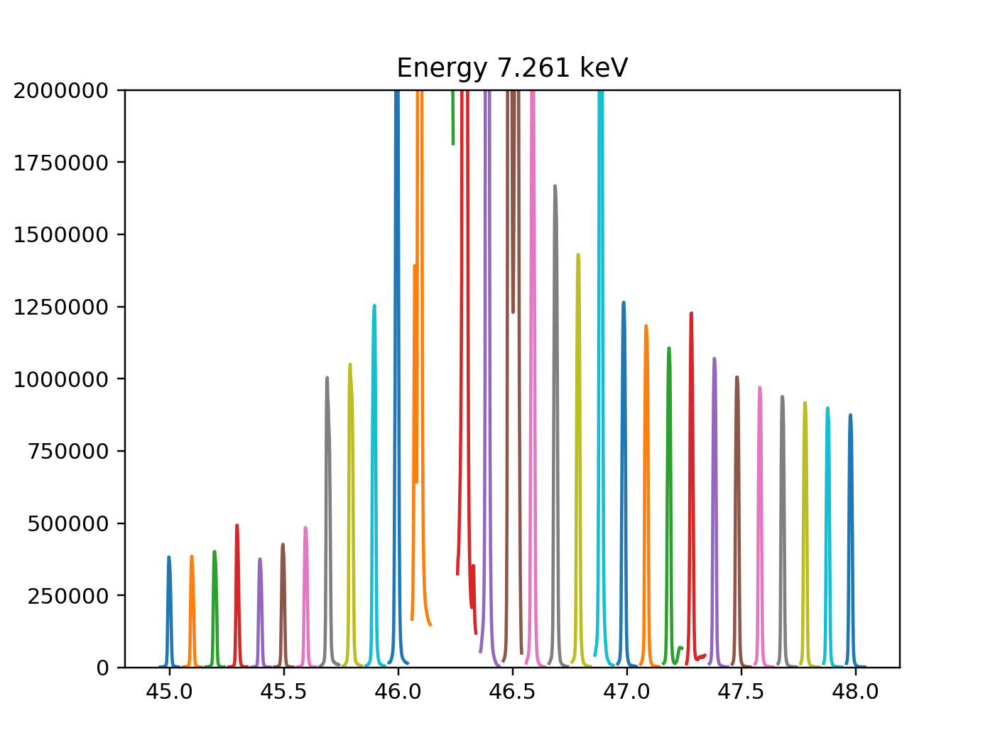

<IPython.core.display.Javascript object>


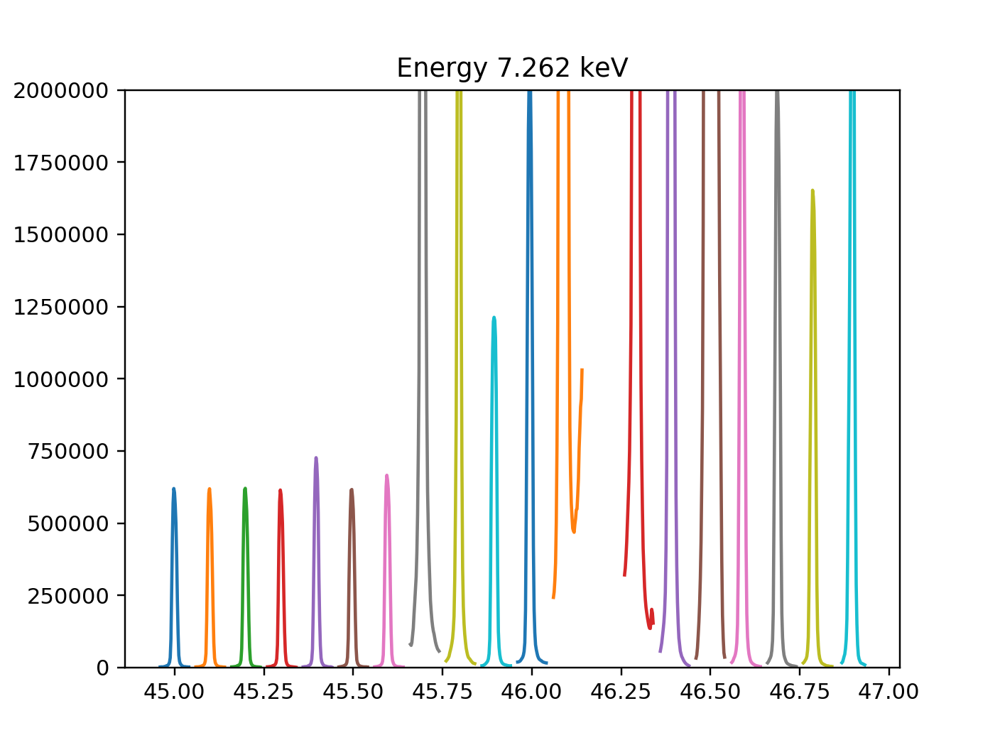

In [72]:
# look at all eta scans for each energy

#figure()
en = 0
for scan in range(824168, 825675+1):
#for scan in range(824168, 824200+1):
#for scan in range(824168, 824170+1):

    enold = en
    n = pdnx(p % scan)
    en = round(float(n.nx['entry1/sample/beam/incident_energy']), 3)
    
    if enold - en != 0: #new figure for new energy
        figure()
        
    psi = n.nx['entry1/before_scan/psi/psi']
    n['psi'] = psi * np.ones(len(n))       
    plot((n.eta-np.mean(n.eta))*2 + psi, n.roi1_sum-n.scroi_bg_sum) #eta width doubled for clearer plot
    ylim([0, 2e6])
    title('Energy %.4g keV' % en)


        
    
        



In [ ]:
#schiroi = HardwareTriggerableDetectorDataProcessor('schiroi', pil3, [SumMaxPositionAndValue()])
#iw=50; jw=1; schiroi.setRoi(int(ci-iw/2.),int(cj-jw/2.),int(ci+iw/2.),int(cj+jw/2.))

#scroi_bg = HardwareTriggerableDetectorDataProcessor('scroi_bg', pil3, [SumMaxPositionAndValue()])
#iw=13; jw=15; scroi_bg.setRoi(int(ci-iw/2.),int(cj-jw/2.-16),int(ci+iw/2.),int(cj+jw/2.-16))

# test file - found data ok
p='/dls/i16/data/2020/cm26473-1/%i.nxs'
n=pdnx(p % 807001)

#recent file - no data
#p='/dls/i16/data/2020/cm26473-2/%i.nxs'
#n = pdnx(p % 824166)
#n = pdnx(p % 824168)

print(n.nx.entry1.pil3_100k.tree)

print(n.nx.entry1.pil3_100k.data.shape, sum(sum(sum(n.nx.entry1.pil3_100k.data))) )
print([sum(sum(n.nx.entry1.pil3_100k.data[i])) for i in range(n.nx.entry1.pil3_100k.data.shape[0])])
    
figure()
imshow(n.nx.entry1.pil3_100k.data[1])


In [3]:
#Official beam time 28-31 July 2020
#Mono problems and power outage - just a few hours to test cvscan script
p='/dls/i16/data/2020/mm25913-2/%i.nxs'

In [17]:

#n=pdnx(p % 828189) #idgap
#n
showscans(range(828189, 830435))

,scan,length,command,start_time
0,828189,21,scan idgap 6.374300000000001 6.4143 0.002 Beam...,2020-07-30T18:03:30.592+01:00
1,828190,61,scan eta 24.374194904580946 24.674194904580943...,2020-07-30T18:04:04.64+01:00
2,828191,21,scan chi 89.35441462626818 90.35441462626818 0...,2020-07-30T18:05:36.126+01:00
3,828192,121,scan kthZebra 81.41685284844606 81.47685284844...,2020-07-30T18:06:21.538+01:00
4,828193,121,scan kthZebra 81.41695284844604 81.47695284844...,2020-07-30T18:06:42.852+01:00
5,828194,121,scan kthZebra 81.41705284844605 81.47705284844...,2020-07-30T18:07:04.043+01:00
6,828195,121,scan kthZebra 81.41725284844605 81.47725284844...,2020-07-30T18:07:24.964+01:00
7,828196,121,scan kthZebra 81.41735284844606 81.47735284844...,2020-07-30T18:07:45.999+01:00
8,828197,121,scan kthZebra 81.41745284844606 81.47745284844...,2020-07-30T18:08:07.091+01:00
9,828198,121,scan kthZebra 81.41755284844605 81.47755284844...,2020-07-30T18:08:28.345+01:00


.nx.entry1.instrument.kthZebraPil3.data : 	 
.nx.entry1.kthZebraPil3.data : 	 


<IPython.core.display.Javascript object>


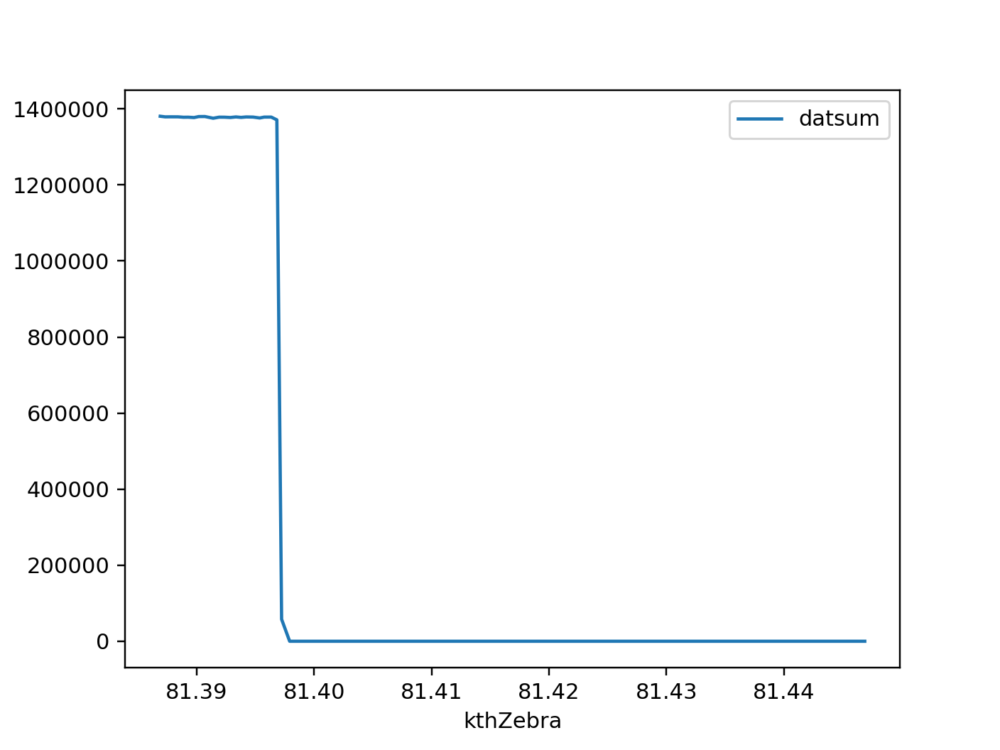

In [72]:
#print(n.nx.tree)
#n = pdnx(p % 828192)

n = pdnx(p % 830031)
n.find('data')
n.nx.entry1.instrument.kthZebraPil3.data.shape
dat = n.nx.entry1.instrument.kthZebraPil3.data.sum((1,2))
n['datsum'] = dat
n
n.plot('kthZebra','datsum')

In [182]:
print(n.nx.tree)

root:NXroot
  entry1:NXentry
    before_scan:NXcollection
      PPR:NXcollection
        ppchi = -44.996699193
        pppiezo1 = 0.0
        pppiezo2 = 12345.012359999999
        ppth1 = 2.6373901632
        ppth2 = -13.3801147506
        ppz1 = 12.0
        ppz2 = 12.0
      alpha:NXcollection
        alpha = -41.291868324508634
      beamline_slits:NXcollection
        s1xcentre = -0.0055
        s1xgap = 2.511
        s1ycentre = 0.001
        s1ygap = 1.0
        s2xcentre = -0.00079375
        s2xgap = 4.9988625
        s2ycentre = 0.499
        s2ygap = 20.0
        s3xcentre = 2.69725
        s3xgap = 25.0015
        s3ycentre = -0.682
        s3ygap = 20.125
        s4xcentre = -5.875
        s4xgap = 36.6504
        s4ycentre = 0.0
        s4ygap = 28.005
        shtr3x = 11.93
        shtr3y = 4.32
      beta:NXcollection
        beta = 41.32621236675409
      delta_offset:NXcollection
        delta_offset = 0.0
      dettrans:NXcollection
        dettrans = 0.0
      diffra

<IPython.core.display.Javascript object>


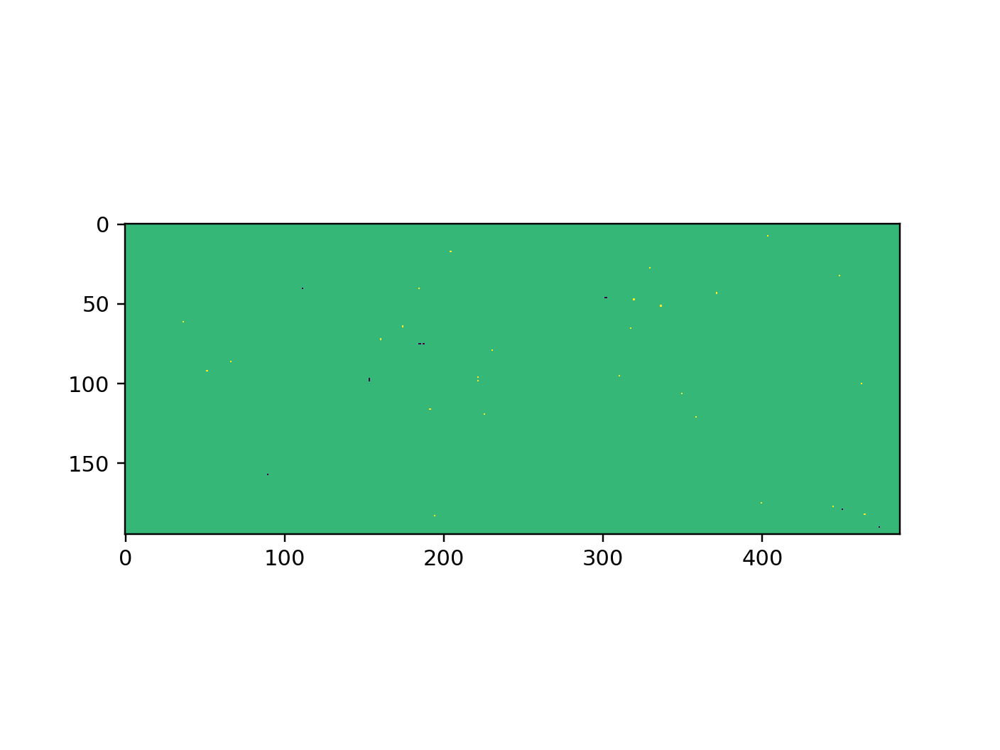

In [5]:
p='/dls/i16/data/2020/mm25913-2/%i.nxs'

# test scan pil3_100k (step scan) - OK
n=pdnx(p % 828123)
imshow(n.nx.entry1.pil3_100k.data[1])

# test scan kthZebraPil3 (cvscan) - OK
n=pdnx(p % 828120)
#imshow(n.nx.entry1.kthZebraPil3.data[1])

In [96]:
#showscans(range(830544, 830550))
showscans(range(830649, 830819))

,scan,length,command,start_time
0,830649,21,scan idgap 6.372400000000001 6.4124 0.002 Beam...,2020-08-04T19:56:35.595+01:00
1,830650,61,scan eta 24.374194904580946 24.674194904580943...,2020-08-04T19:57:08.641+01:00
2,830651,21,scan chi 89.35441462626818 90.35441462626818 0...,2020-08-04T19:58:36.404+01:00
3,830652,121,scan kthZebra 81.41685284844606 81.47685284844...,2020-08-04T19:59:22.014+01:00
4,830653,121,scan kthZebra 81.41705284844605 81.47705284844...,2020-08-04T19:59:33.979+01:00
5,830654,121,scan kthZebra 81.41735284844606 81.47735284844...,2020-08-04T19:59:46.237+01:00
6,830655,121,scan kthZebra 81.41755284844605 81.47755284844...,2020-08-04T19:59:58.22+01:00
7,830656,121,scan kthZebra 81.41785284844605 81.47785284844...,2020-08-04T20:00:10.516+01:00
8,830657,121,scan kthZebra 81.41805284844605 81.47805284844...,2020-08-04T20:00:22.504+01:00
9,830658,121,scan kthZebra 81.41835284844605 81.47835284844...,2020-08-04T20:00:34.466+01:00


In [80]:
#scan timing tests
# cvscan kthZebra kth_val-.03 kth_val+0.03 .0005 kthZebraPil3 .1 ##  21 sec/scan (12.1 sec counting, o/head 9 sec)
# cvscan kthZebra kth_val-.03 kth_val+0.03 .0005 kthZebraPil3 .02 ## 12 sec (2.4 sec counting, o/head 9 sec)
# cvscan kthZebra kth_val-.03 kth_val+0.03 .0005 kthZebraPil3 .05 ## 14 sec (5 sec counting, o/head 9 sec)
# time in days
#(160 + 200) * 100 * 14. /3600/24
#~ 3 days with 0.1 deg psi instead of 0.05

5.833333333333333

.nx.entry1.instrument.kthZebraPil3.data : 	 
.nx.entry1.kthZebraPil3.data : 	 
.nx.entry1.sample.beam.incident_energy : 	 7.224001991465036
.nx.entry1.before_scan.psi : 	 psi
.nx.entry1.before_scan.psi.psi : 	 48.39999126229341


<IPython.core.display.Javascript object>


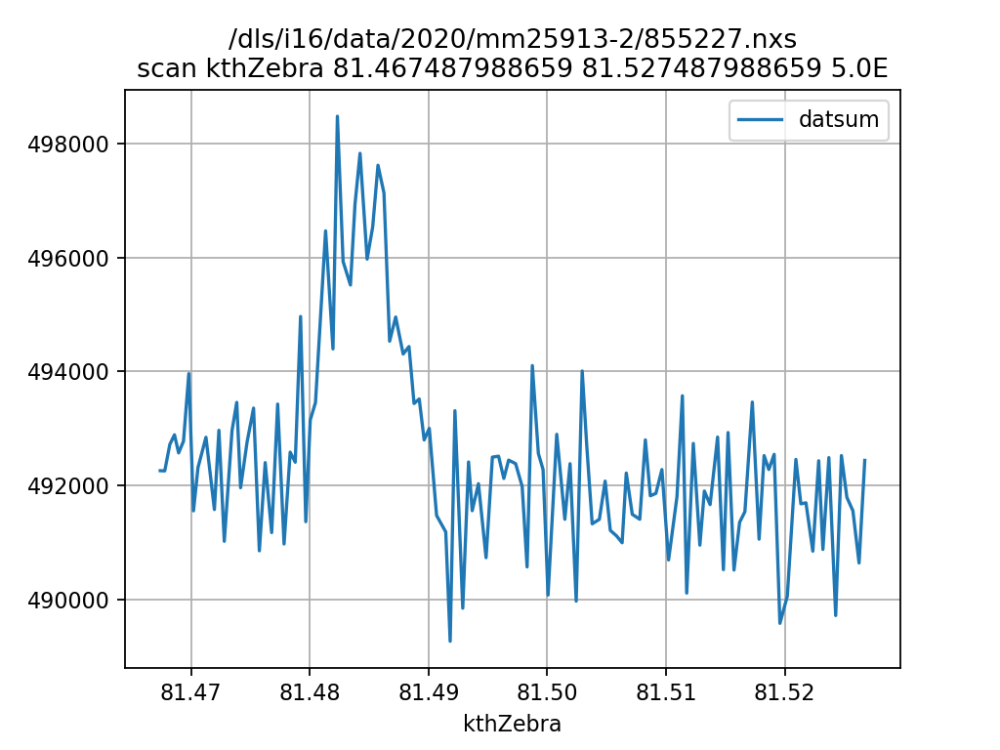

<IPython.core.display.Javascript object>


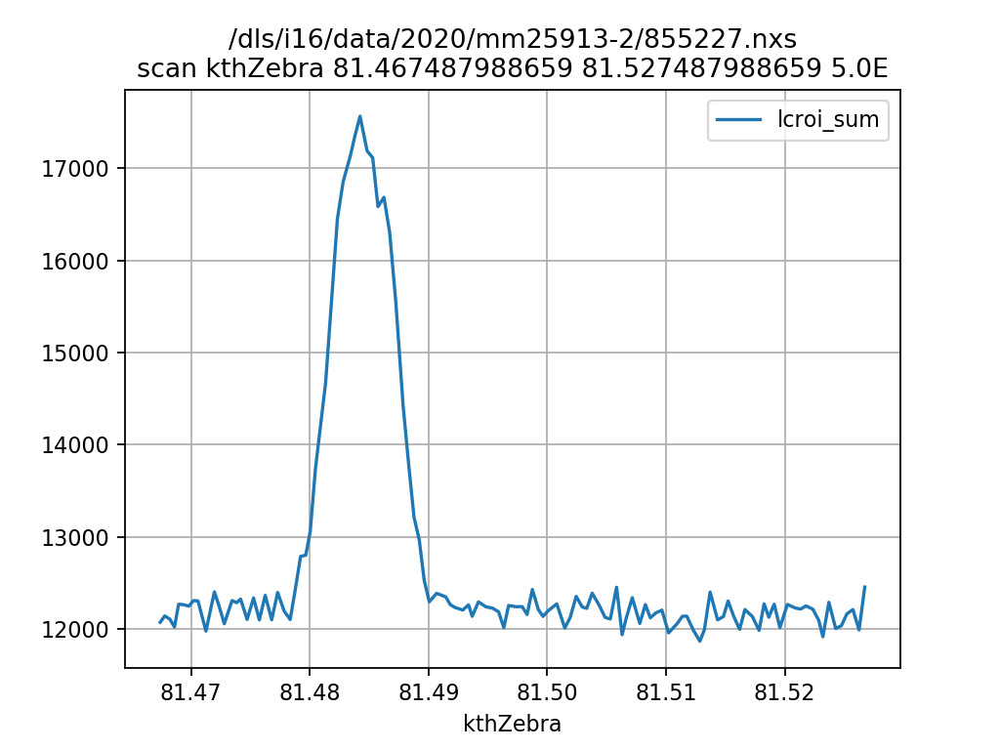

<IPython.core.display.Javascript object>


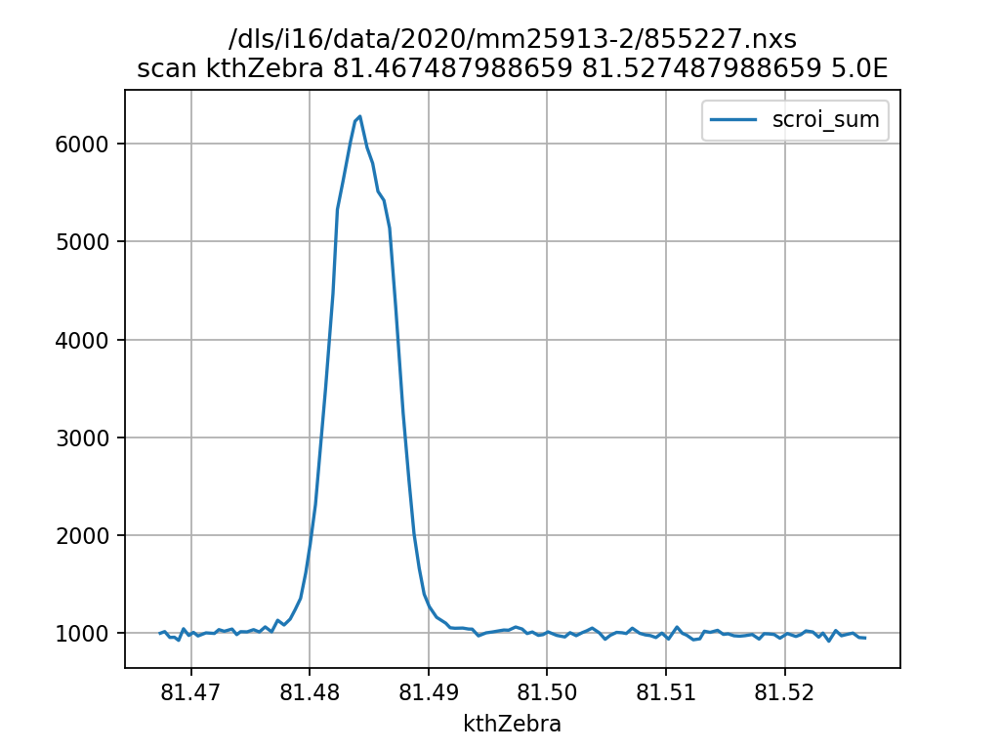

In [24]:
#n = pdnx(p % 834500)
#n = pdnx(p % 840752) # nothing
#n = pdnx(p % 84000) # ok 8.346 keV small roi needs moving
n = pdnx(p % 855227) # ok 

# no data 840650 - 840752 (8.357 - 8.3485 keV)

n.find('data')
n.find('incident_energy')
n.find('psi')
n.nx.entry1.instrument.kthZebraPil3.data.shape
dat = n.nx.entry1.instrument.kthZebraPil3.data.sum((1,2))
n['datsum'] = dat
n.plt('kthZebra','datsum')

r =  lcroi
n['lcroi_sum'] = n.nx.entry1.instrument.kthZebraPil3.data[:, r[1]:r[3], r[0]:r[2]].sum((1,2))
n.plt('kthZebra','lcroi_sum')

r =  scroi
n['scroi_sum'] = n.nx.entry1.instrument.kthZebraPil3.data[:, r[1]:r[3], r[0]:r[2]].sum((1,2))
n.plt('kthZebra','scroi_sum')


In [16]:
n = pdnx(p % 846977) 
#print(n.nx.tree)
n.find('incident_energy')
n.find('psi')
n.nx.entry1.start_time

.nx.entry1.sample.beam.incident_energy : 	 8.363998311399854
.nx.entry1.before_scan.psi : 	 psi
.nx.entry1.before_scan.psi.psi : 	 48.60000615987769


NXfield('2020-08-07T08:45:00.269+01:00')

In [10]:

#roi1 = scroi=HardwareTriggerableDetectorDataProcessor('roi1', pil3, [SumMaxPositionAndValue()])
#iw=13; jw=15; roi1.setRoi(int(ci-iw/2.),int(cj-jw/2.),int(ci+iw/2.),int(cj+jw/2.))

#roi2 = lcroi=HardwareTriggerableDetectorDataProcessor('roi2', pil3, [SumMaxPositionAndValue()])
#iw=50; jw=50; roi2.setRoi(int(ci-iw/2.),int(cj-jw/2.),int(ci+iw/2.),int(cj+jw/2.))


#scroi_bg = HardwareTriggerableDetectorDataProcessor('scroi_bg', pil3, [SumMaxPositionAndValue()])
#iw=13; jw=15; scroi_bg.setRoi(int(ci-iw/2.),int(cj-jw/2.-16),int(ci+iw/2.),int(cj+jw/2.-16)



ci, cj = 242, 95

iw=50; jw=50
lcroi = (int(ci-iw/2.), int(cj-jw/2.), int(ci+iw/2.), int(cj+jw/2.))
iw=13; jw=15
scroi = (int(ci-iw/2.), int(cj-jw/2.), int(ci+iw/2.), int(cj+jw/2.))
scroi_bg = (int(ci-iw/2.), int(cj-jw/2.-16), int(ci+iw/2.), int(cj+jw/2.-16))



#scroi_bg = HardwareTriggerableDetectorDataProcessor('scroi_bg', pil3, [SumMaxPositionAndValue()])
#iw=13; jw=15; scroi_bg.setRoi(int(ci-iw/2.),int(cj-jw/2.-16),int(ci+iw/2.),int(cj+jw/2.-16))



r =  lcroi
len(n.nx.entry1.instrument.kthZebraPil3.data[:, r[1]:r[3], r[0]:r[2]].sum((1,2)))


121

<IPython.core.display.Javascript object>


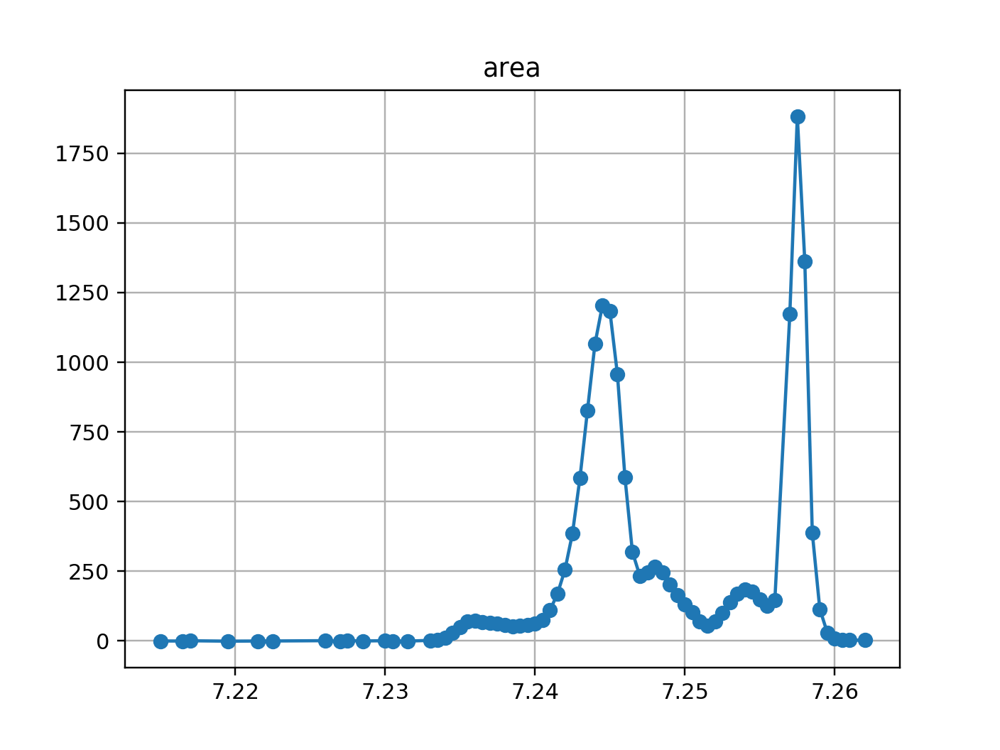

<IPython.core.display.Javascript object>


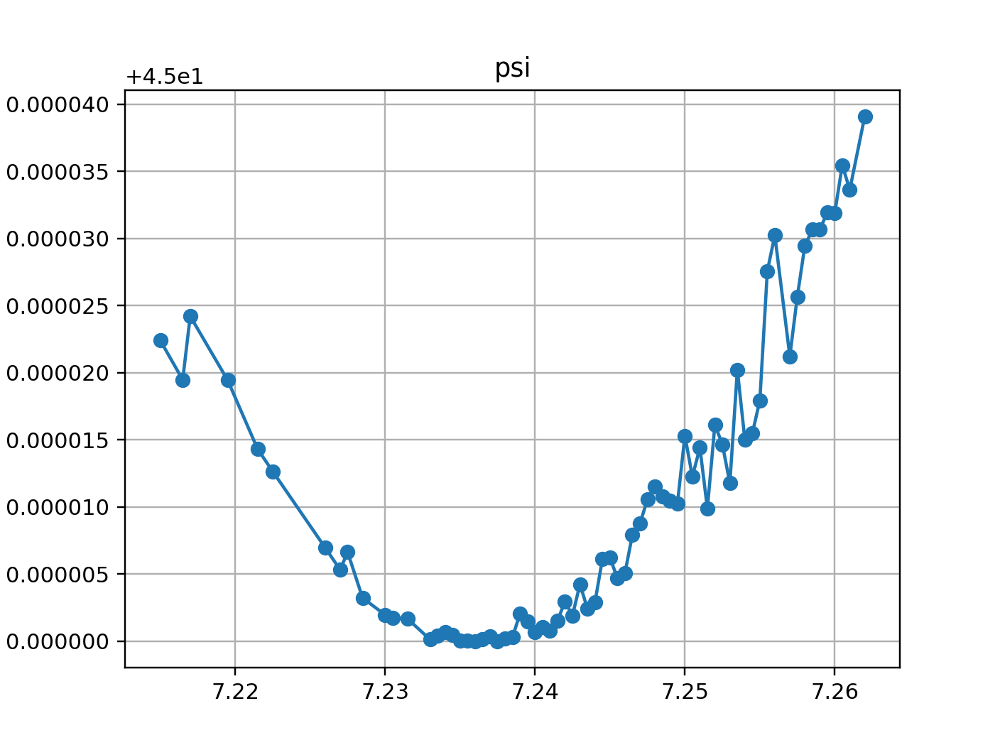

<IPython.core.display.Javascript object>


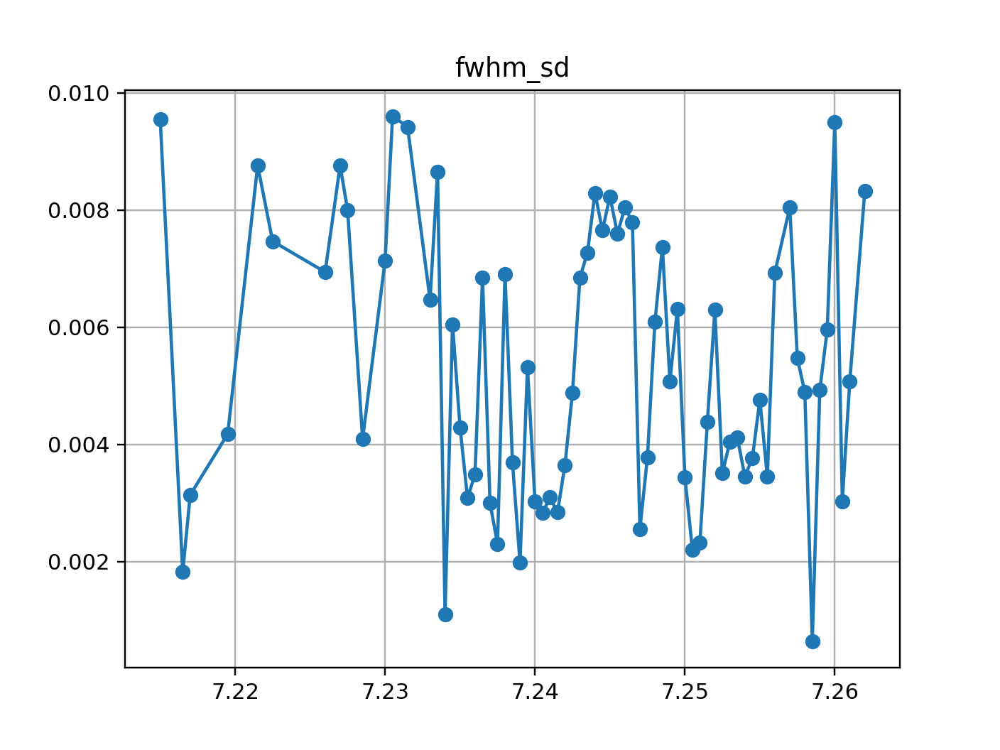

<IPython.core.display.Javascript object>


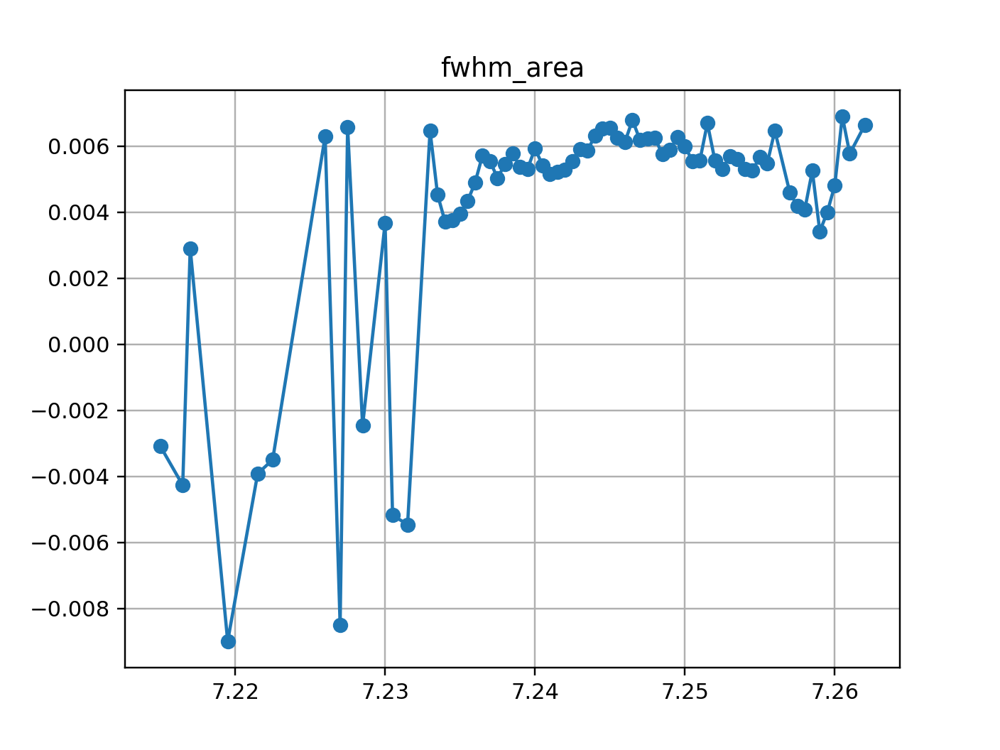

<IPython.core.display.Javascript object>


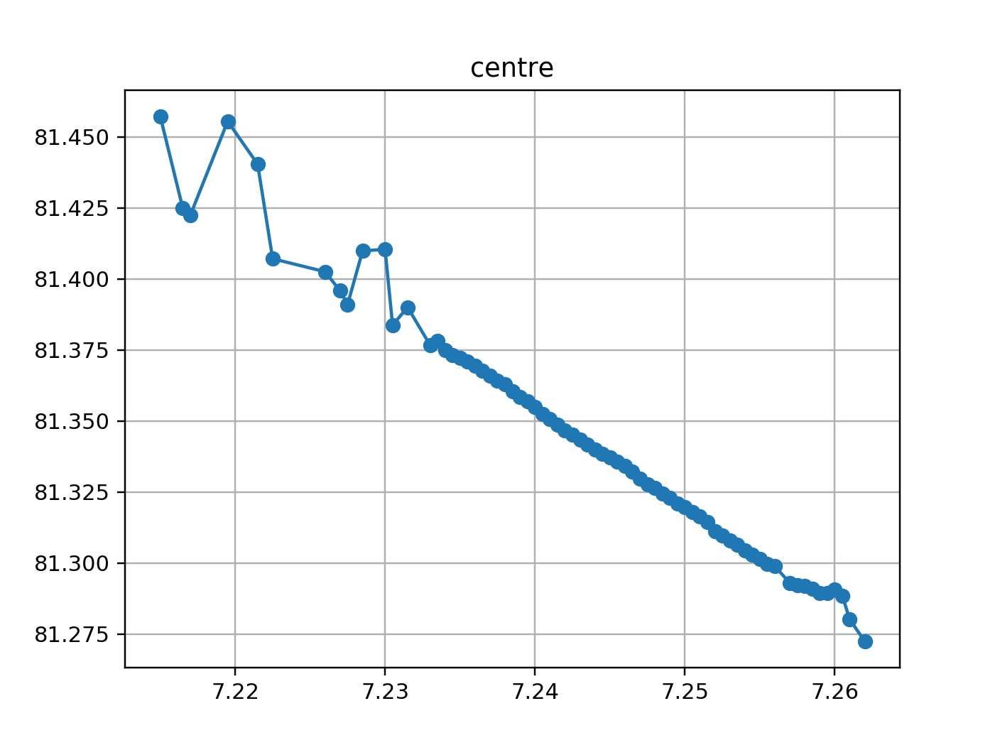

In [152]:
#modified from previous script - now with kth cvscans and sums extracted from images
# get smallest area for each energy
max_width = 0.01 # ignore wide peaks
res = {}
for scan in range(830649, 835662+1):
    n = pdnx(p % scan)
    if len(n) == 121: #it's a fine eta scan
        
        en = round(float(n.nx['entry1/sample/beam/incident_energy']), 4)
        psi = n.nx['entry1/before_scan/psi/psi']
        
        r =  scroi
        n['scroi_sum'] = n.nx.entry1.instrument.kthZebraPil3.data[:, r[1]:r[3], r[0]:r[2]].sum((1,2))        
        r =  scroi_bg
        n['scroi_bg_sum'] = n.nx.entry1.instrument.kthZebraPil3.data[:, r[1]:r[3], r[0]:r[2]].sum((1,2))   
        [centre, fwhm_sd, fwhm_area, sum, height, area, m, c] = peak(n.kthZebra, n.scroi_sum-n.scroi_bg_sum, 3)
        
        #print(en, centre-np.mean(n.eta), np.max(n.eta)-np.min(n.eta), fwhm_sd, area, float(psi))
        
        if not np.isnan(fwhm_sd) and fwhm_sd < max_width:
        
            if en in res.keys():

                if area < res[en]['area']:   
                    res[en] = {'area': area, 'fwhm_sd': fwhm_sd, 'fwhm_area': fwhm_area, 'centre': centre, 'psi': float(psi)}
            else:

                res[en] = {'area': area, 'fwhm_sd': fwhm_sd, 'fwhm_area': fwhm_area, 'centre': centre, 'psi': float(psi)}
        
        #plot(n.eta, n.roi1_sum-n.scroi_bg_sum)

en, cts, psi , centre, fwhm_sd, fwhm_area = [], [], [], [], [], []
for pt in res:
    en += [pt]
    cts += [res[pt]['area']]
    psi += [res[pt]['psi']]
    fwhm_sd += [res[pt]['fwhm_sd']]
    fwhm_area += [res[pt]['fwhm_area']]
    centre += [res[pt]['centre']]
    
    
en, cts, psi, fwhm_sd, centre, fwhm_area = np.array(en), np.array(cts), np.array(psi), np.array(fwhm_sd), np.array(centre), np.array(fwhm_area)

figure(); plot(en, cts, '-o'); title('area'); grid(1)
figure(); plot(en, psi, '-o'); title('psi'); grid(1)
figure(); plot(en, fwhm_sd, '-o'); title('fwhm_sd'); grid(1)
figure(); plot(en, fwhm_area, '-o'); title('fwhm_area'); grid(1)
figure(); plot(en, centre, '-o'); title('centre'); grid(1)


In [3]:
# modified tmp version with detector sum
# might need try/except
pd.set_option('display.max_rows',9999)
def showscans1(scans, metadata = []):
    # md is metadata list e.g. ['entry1/sample/name']
    _scanlist =[]
    for scan in scans:
        _n = pdnx(p % scan)
        try:
            dic = {}
            dic['scan'] = scan
            dic['length'] = len(_n)
            dic['command'] = _n.nx.entry1.scan_command
            dic['start_time'] = _n.nx.entry1.start_time
            dic['sum'] = int(_n.nx.entry1.instrument.kthZebraPil3.data.sum()) ### special bit
            for meta in metadata:
                dic[meta.split('/')[-1]] = _n.nx[meta]   
            
            _scanlist += [dic]
        except:
            print('=== Skipping scan #%i - field not found' % scan)
        
    return pd.DataFrame(_scanlist)

=== Error loading file /dls/i16/data/2020/mm25913-2/843459.nxs
=== Skipping scan #843459 - field not found
=== Skipping scan #843460 - field not found
=== Skipping scan #843461 - field not found
=== Skipping scan #843462 - field not found


<IPython.core.display.Javascript object>


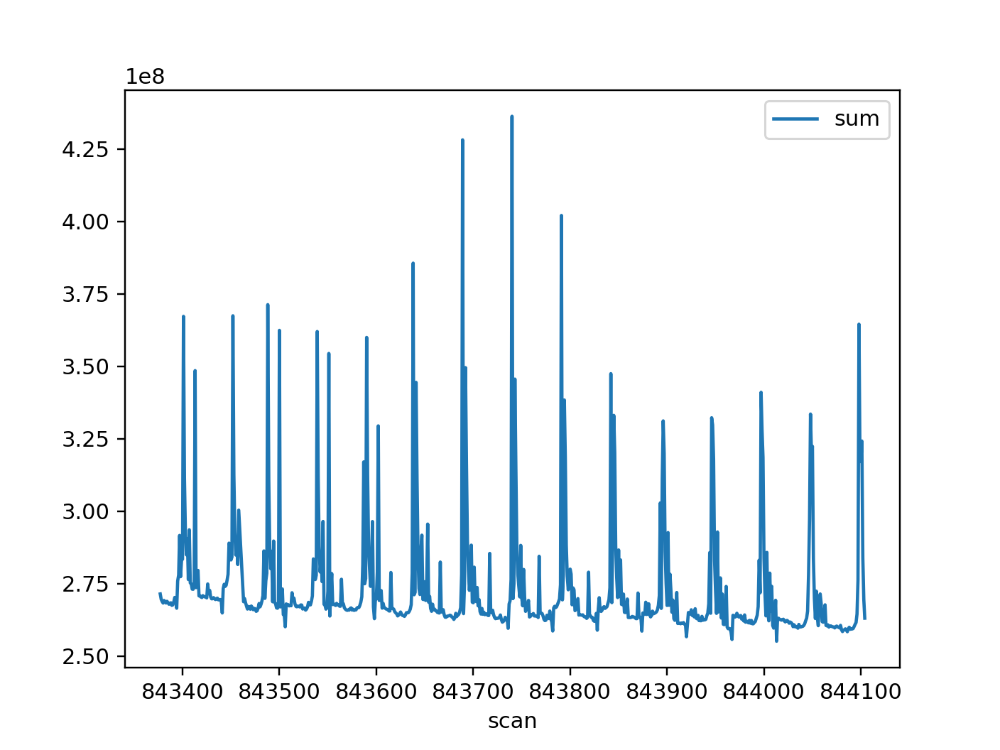

,scan,length,command,start_time,sum,incident_energy,psi
0,843377,121,scan kthZebra 77.94717165700227 78.00717165700...,2020-08-06T19:36:23.008+01:00,271413588,8.329999999940577,44.09999910294345
1,843378,121,scan kthZebra 77.94737165700228 78.00737165700...,2020-08-06T19:36:35.734+01:00,269563053,8.329999999940577,44.20000185951363
2,843379,121,scan kthZebra 77.94782459669113 78.00782459669...,2020-08-06T19:36:48.461+01:00,268803552,8.329997024635196,44.29999462860521
3,843380,121,scan kthZebra 77.94812459669114 78.00812459669...,2020-08-06T19:37:01.426+01:00,268264600,8.329999999940577,44.399992832342974
4,843381,121,scan kthZebra 77.94832459669114 78.00832459669...,2020-08-06T19:37:13.843+01:00,269151153,8.329999999940577,44.49999936291481
5,843382,121,scan kthZebra 77.94877753727137 78.00877753727...,2020-08-06T19:37:26.77+01:00,268721930,8.329999999940577,44.59999899608423
6,843383,121,scan kthZebra 77.94897753727138 78.00897753727...,2020-08-06T19:37:39.441+01:00,268280577,8.329999999940577,44.699993044587174
7,843384,121,scan kthZebra 77.94927753727137 78.00927753727...,2020-08-06T19:37:52.204+01:00,268871487,8.330002975248151,44.7999942796868
8,843385,121,scan kthZebra 77.94963047874172 78.00963047874...,2020-08-06T19:38:04.802+01:00,268429879,8.329997024635196,44.89999801395638
9,843386,121,scan kthZebra 77.94993047874172 78.00993047874...,2020-08-06T19:38:17.489+01:00,267873885,8.329999999940577,44.999992084488156


In [14]:
p='/dls/i16/data/2020/mm25913-2/%i.nxs'
d = showscans1(range(843377, 844105), metadata = ['entry1/sample/beam/incident_energy','entry1/before_scan/psi/psi'])
d.plot('scan','sum')
d

In [7]:
n = pdnx(p % 841001)
n.find('psi')
n.find('phi')

.nx.entry1.before_scan.psi : 	 psi
.nx.entry1.before_scan.psi.psi : 	 45.00001019221517
.nx.entry1.before_scan.diffractometer_sample.phi : 	 177.25555353323693
.nx.entry1.sample.transformations.phi : 	 234.077106381683


# Previous scans did not more chi and phi - start again 843373

=== Skipping scan #843460 - field not found
=== Skipping scan #843461 - field not found
=== Skipping scan #843462 - field not found


<IPython.core.display.Javascript object>


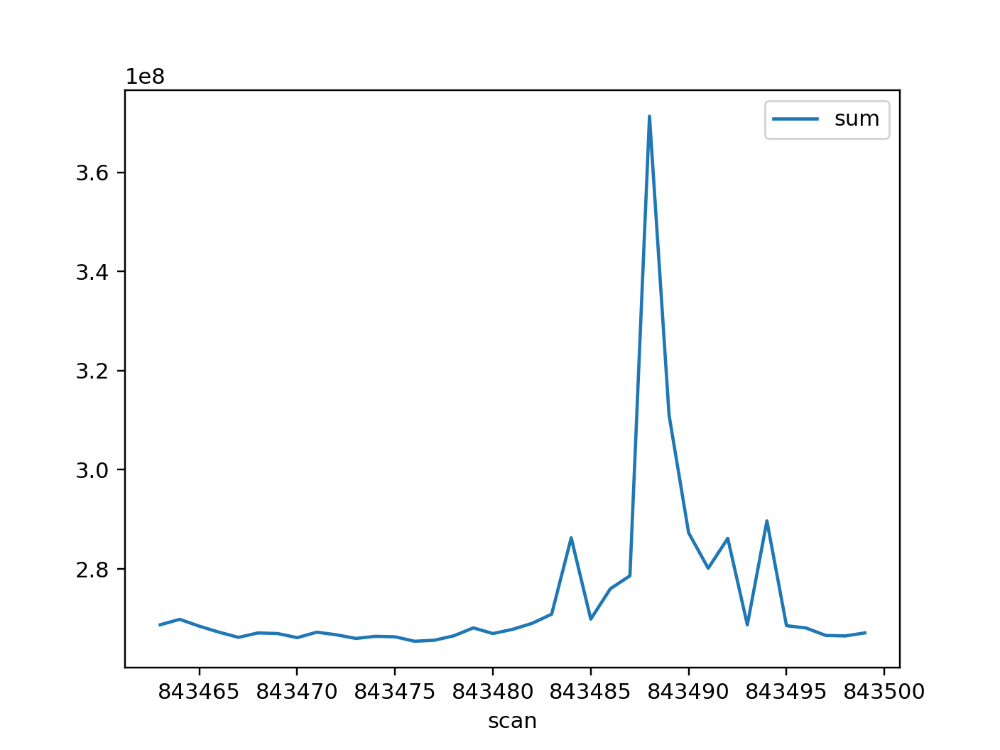

,scan,length,command,start_time,sum,incident_energy,psi
0,843463,121,scan kthZebra 77.946844192142 78.006844192142 ...,2020-08-06T20:00:46.286+01:00,268737592,8.329997024635196,44.00000558801664
1,843464,121,scan kthZebra 77.947150109104 78.007150109104 ...,2020-08-06T20:00:59.281+01:00,269829459,8.329999999940577,44.10000567686349
2,843465,121,scan kthZebra 77.947456647065 78.007456647065 ...,2020-08-06T20:01:12.436+01:00,268448282,8.330002975248151,44.20000610703883
3,843466,121,scan kthZebra 77.947763805095 78.007763805095 ...,2020-08-06T20:01:25.382+01:00,267245107,8.329999999940577,44.30000565403225
4,843467,121,scan kthZebra 77.948071582262 78.008071582262 ...,2020-08-06T20:01:38.161+01:00,266194680,8.330002975248151,44.40000509343115
5,843468,121,scan kthZebra 77.948379977633 78.008379977633 ...,2020-08-06T20:01:51.204+01:00,267094298,8.329997024635196,44.500005685622085
6,843469,121,scan kthZebra 77.948688990272 78.008688990272 ...,2020-08-06T20:02:04.401+01:00,266969047,8.329994049332,44.60000336787356
7,843470,121,scan kthZebra 77.948998619243 78.008998619243 ...,2020-08-06T20:02:17.281+01:00,266134298,8.329994049332,44.70000609778401
8,843471,121,scan kthZebra 77.949308863607 78.009308863607 ...,2020-08-06T20:02:30.237+01:00,267241537,8.330002975248151,44.80000558419877
9,843472,121,scan kthZebra 77.949619722422 78.009619722422 ...,2020-08-06T20:02:43.251+01:00,266716839,8.329997024635196,44.90000569600216


In [22]:
p='/dls/i16/data/2020/mm25913-2/%i.nxs'
d = showscans1(range(843460, 843500), metadata = ['entry1/sample/beam/incident_energy','entry1/before_scan/psi/psi'])
d.plot('scan','sum')
d

<IPython.core.display.Javascript object>


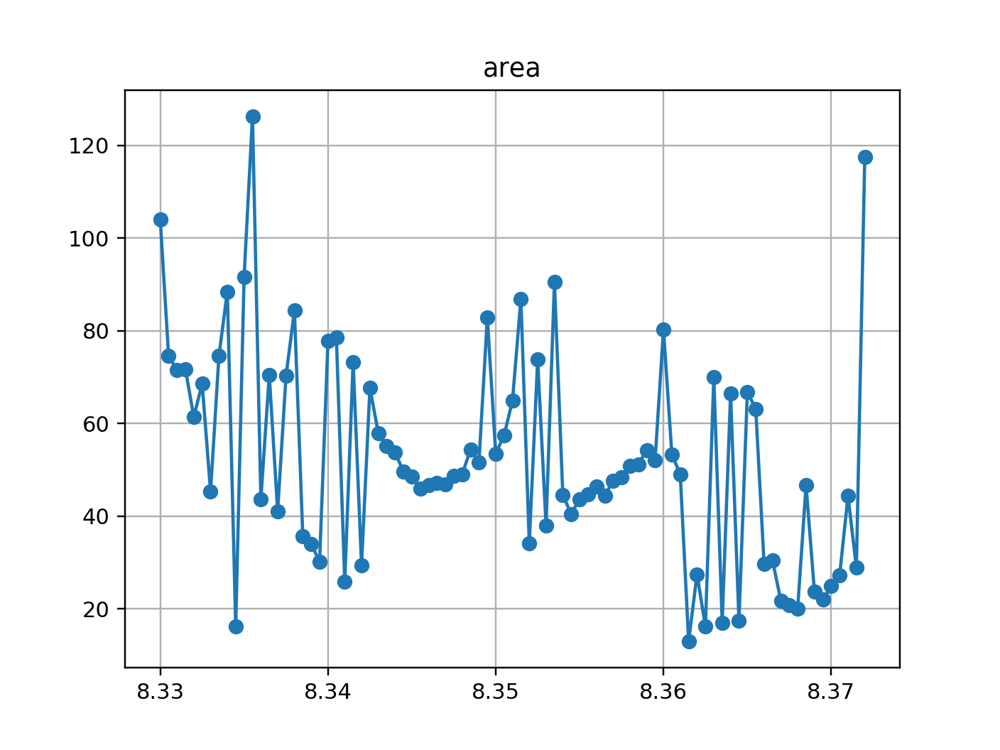

<IPython.core.display.Javascript object>


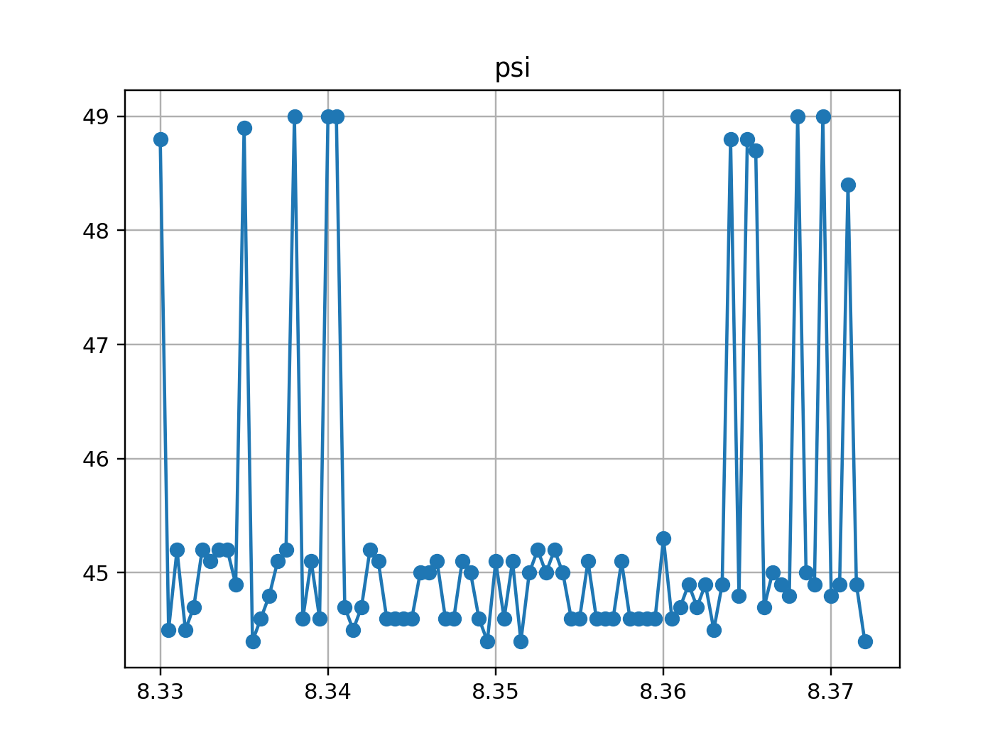

<IPython.core.display.Javascript object>


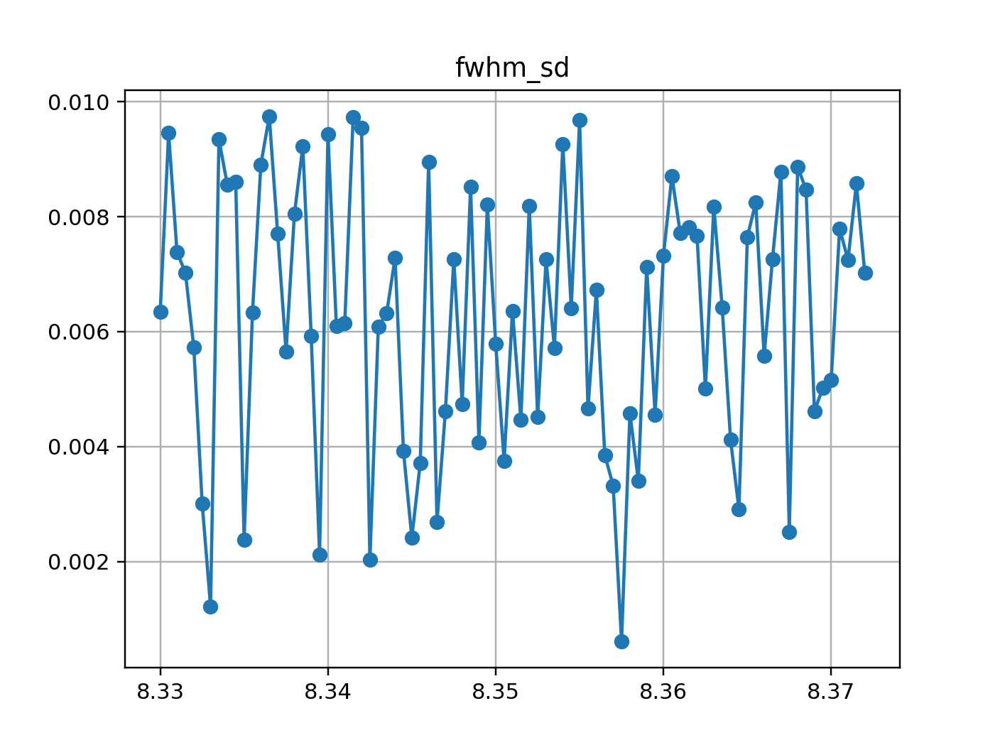

<IPython.core.display.Javascript object>


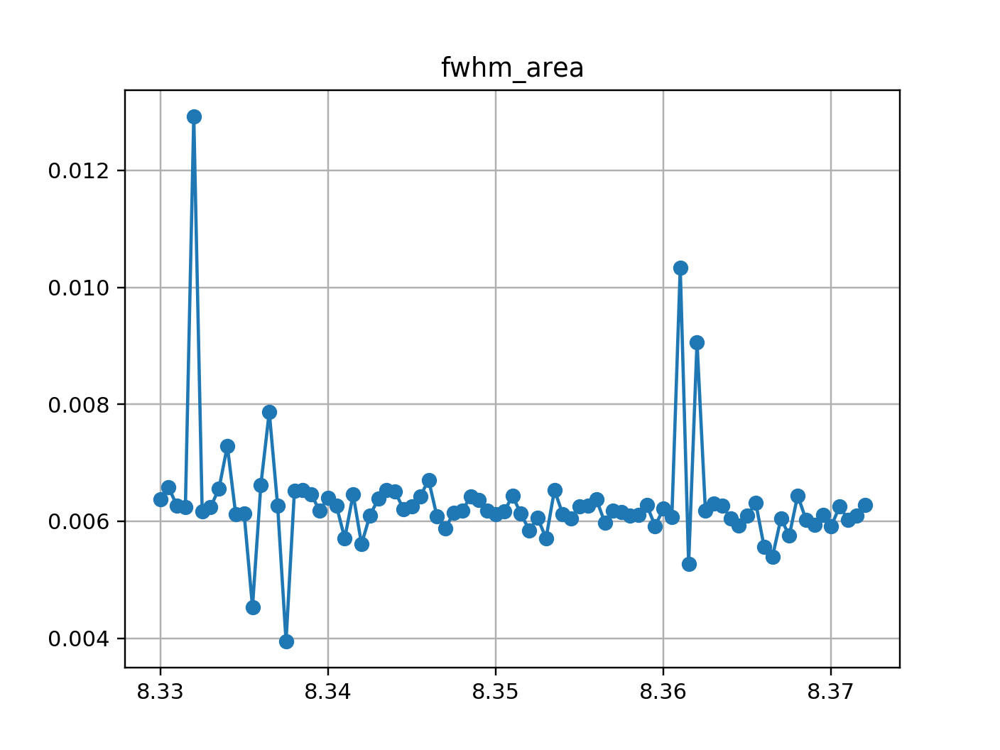

<IPython.core.display.Javascript object>


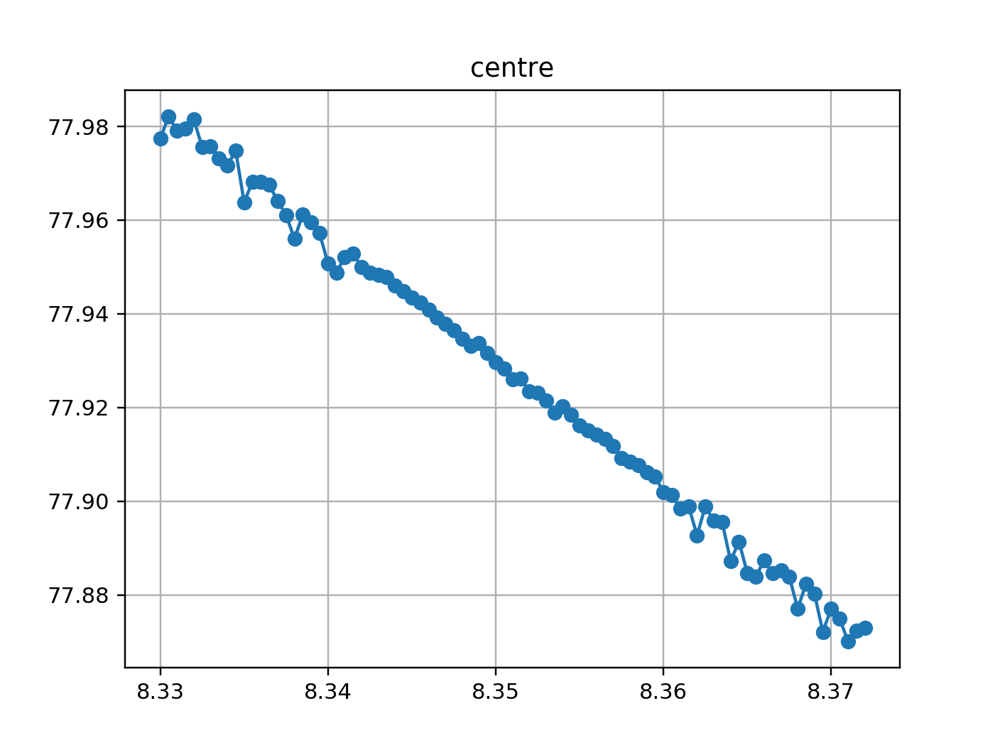

In [23]:
#modified from previous script - now with kth cvscans and sums extracted from images
# get smallest area for each energy
max_width = 0.01 # ignore wide peaks
res = {}
for scan in range(843460, 847754):
    n = pdnx(p % scan)
    if len(n) == 121: #it's a fine eta scan
        
        en = round(float(n.nx['entry1/sample/beam/incident_energy']), 4)
        psi = n.nx['entry1/before_scan/psi/psi']
        
        r =  scroi
        n['scroi_sum'] = n.nx.entry1.instrument.kthZebraPil3.data[:, r[1]:r[3], r[0]:r[2]].sum((1,2))        
        r =  scroi_bg
        n['scroi_bg_sum'] = n.nx.entry1.instrument.kthZebraPil3.data[:, r[1]:r[3], r[0]:r[2]].sum((1,2))   
        [centre, fwhm_sd, fwhm_area, sum, height, area, m, c] = peak(n.kthZebra, n.scroi_sum-n.scroi_bg_sum, 3)
        
        #print(en, centre-np.mean(n.eta), np.max(n.eta)-np.min(n.eta), fwhm_sd, area, float(psi))
        
        if not np.isnan(fwhm_sd) and fwhm_sd < max_width:
        
            if en in res.keys():

                if area < res[en]['area']:   
                    res[en] = {'area': area, 'fwhm_sd': fwhm_sd, 'fwhm_area': fwhm_area, 'centre': centre, 'psi': float(psi)}
            else:

                res[en] = {'area': area, 'fwhm_sd': fwhm_sd, 'fwhm_area': fwhm_area, 'centre': centre, 'psi': float(psi)}
        
        #plot(n.eta, n.roi1_sum-n.scroi_bg_sum)

en, cts, psi , centre, fwhm_sd, fwhm_area = [], [], [], [], [], []
for pt in res:
    en += [pt]
    cts += [res[pt]['area']]
    psi += [res[pt]['psi']]
    fwhm_sd += [res[pt]['fwhm_sd']]
    fwhm_area += [res[pt]['fwhm_area']]
    centre += [res[pt]['centre']]
    
    
en, cts, psi, fwhm_sd, centre, fwhm_area = np.array(en), np.array(cts), np.array(psi), np.array(fwhm_sd), np.array(centre), np.array(fwhm_area)

figure(); plot(en, cts, '-o'); title('area'); grid(1)
figure(); plot(en, psi, '-o'); title('psi'); grid(1)
figure(); plot(en, fwhm_sd, '-o'); title('fwhm_sd'); grid(1)
figure(); plot(en, fwhm_area, '-o'); title('fwhm_area'); grid(1)
figure(); plot(en, centre, '-o'); title('centre'); grid(1)



Crystal properties

                    CIF file:  /home/spc93/spc_cifs/GGG_sawada_icsd_84874.cif
                     Lattice:  12.383 12.383 12.383 90.00 90.00 90.00
                   All sites:  Gd1, Ga1, Ga2, O1
               Site selected:  Gd1
                 Site vector:  0.125 0.000 0.250
       No. of spacegroup ops:  96
      No. of sym ops at site:  4
 No. of equiv. sites in cell:  24
   No. of pg ops for crystal:  48

Tensor properties

             Required parity:  Even
          Required time sym.:  Even
                         hkl:  [0.0, 0.0, 2.0]
                Site allowed:  No
   Structure factor for site:  0.00+-0.00i
          Spacegroup allowed:  No
              Tensor allowed:  Yes
                      Parity:  Either
                        Time:  Either
                          PT:  Either
              Glide or screw:  True


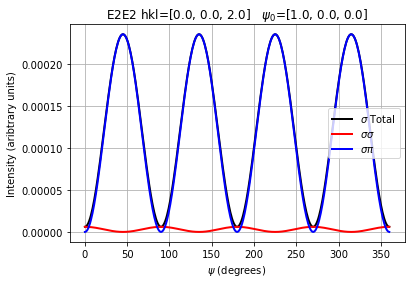

('\nTensor components\n', '\n         Crystal (spherical):  ', array([ 0.598-0.j,  0.   +0.j, -0.   +0.j, -0.   +0.j,  1.   -0.j,
        0.   +0.j, -0.   -0.j, -0.   +0.j,  0.598+0.j]), '\n            Atom (spherical):  ', array([ 0.447-0.j   ,  0.   +0.054j,  0.2  +0.j   , -0.   -0.02j ,
        1.   +0.j   ,  0.   -0.02j ,  0.2  -0.j   , -0.   +0.054j,
        0.447+0.j   ]), '\n  Struct. factor (spherical):  ', array([-0.-0.j, -0.+0.j,  1.+0.j,  0.+0.j,  0.-0.j, -0.+0.j,  1.+0.j,
        0.+0.j, -0.+0.j]), '\n\nCrystal (Cartesian):\n\n', array([[[[19.694-0.j,  0.   +0.j,  0.   -0.j],
         [ 0.   +0.j, -9.847-0.j, -0.   -0.j],
         [ 0.   -0.j, -0.   -0.j, -9.847-0.j]],

        [[ 0.   +0.j, -9.847-0.j, -0.   -0.j],
         [-9.847-0.j, -0.   +0.j, -0.   -0.j],
         [-0.   -0.j, -0.   -0.j, -0.   -0.j]],

        [[ 0.   -0.j, -0.   -0.j, -9.847-0.j],
         [-0.   -0.j, -0.   -0.j, -0.   -0.j],
         [-9.847-0.j, -0.   -0.j, -0.   +0.j]]],


       [[[ 0.   +0.j,

<Figure size 432x288 with 0 Axes>

In [5]:
import TensorScatteringClass as ten
import numpy as np


t=ten.TensorScatteringClass(CIFfile='/home/spc93/spc_cifs/GGG_sawada_icsd_84874.cif', Site='Gd1');

#hkl, proc , K, Parity = np.array([0,0,2]), 'E1E1', 2, 1
hkl, proc , K, Parity = np.array([0,0,2]), 'E2E2', 4, 1
#hkl, proc , K, Parity = np.array([0,1,1]), 'E1E1', 2, 1
#hkl, proc , K, Parity = np.array([0,1,1]), 'E2E2', 4, 1


name = '%s hkl = (%i, %i, %i) K=%i' % (proc, hkl[0], hkl[1], hkl[2], K)
name = '/home/spc93/tmp/' + name
t.PlotIntensityInPolarizationChannels(proc, lam=1, hkl=hkl, hkln=np.array([1,0,0]), K=K, Time=+1, Parity=Parity, mk=None, lk=None, sk=None, sigmapi='sigma', savefile = name)
t.print_tensors()


#Iss, Isp,Ips, Ipp = t.CalculateIntensityInPolarizationChannels('E2E2', lam=1, hkl=np.array([0,0,0]), hkln=np.array([1,0,0]), psideg = np.arange(0, 360, 25),  K=4, Time=1, Parity=+1, mk=None, lk=None, sk=None)


In [2]:
name
#print '%s '+'sigma'+'.pdf' % name
#'%s '+'sigma'+'.pdf'
print ('%s '+'sigma'+'.pdf') % name

/home/spc93/tmp/E2E2 hkl = (0, 1, 1) K=4 sigma.pdf


In [9]:
t=ten.TensorScatteringClass(CIFfile='/home/spc93/spc_cifs/GGG_sawada_icsd_84874.cif', Site='Gd1', verbose = False);

def calc_ten(hkl):
    proc_dic = {'E1E1':{'K':2, 'Parity':1},
                'E1E2':{'K':3, 'Parity':-1},
                'E2E2':{'K':4, 'Parity':1}
               }
    lam = 1
    Time = 1
    psideg = np.arange(0, 360, 25)
    hkln = np.array([0.1234, 0.7777, 0.22804969])
    
    dic = {}
    for proc in proc_dic.keys():
        #print proc, lam, hkl, hkln, psideg, proc_dic[proc]['K'], Time, proc_dic[proc]['Parity']
        Iss, Isp,Ips, Ipp = t.CalculateIntensityInPolarizationChannels(proc, lam, hkl, hkln, psideg=psideg, K=proc_dic[proc]['K'], Time=Time, Parity=proc_dic[proc]['Parity'])
        ten_allowed = t.tensor_allowed==1
        sg_allowed = t.gen_scalar_allowed==1
        tensor = max(abs(t.Fs)**2)>0.000001   
        signal = max(Iss**2 + Isp**2 + Ips**2 + Ipp**2)>0.000001
        dic[proc] = {'tensor': tensor, 'signal': signal}
        
    return {'hkl': list(hkl), 'sg_allowed': sg_allowed, 'ten_allowed':ten_allowed, 'E1E1': dic['E1E1'], 'E1E2': dic['E1E2'], 'E2E2': dic['E2E2']}

            
reflist = []
for h in range(8):
    for k in range(8):
        for l in range(8):
            reflist += [[h, k, l]]
reflist.sort(key = lambda x : x[0]**2 + x[1]**2 + x[2]**2)
            

ten_list = []
for hkl in reflist:
    ten_list += [calc_ten(hkl)]

print 'hkl\t\tsg_allowed\tten_allowed\tproc\ttensor\tsignal\tproc\ttensor\tsignal\tproc\ttensor\tsignal'
print
for r in ten_list:
    print r['hkl'],'\t',r['sg_allowed'],'\t\t',r['ten_allowed'],'\t\t', 'E1E1', '\t',r['E1E1']['tensor'],'\t',r['E1E1']['signal'],'\t','E1E2', '\t',r['E1E2']['tensor'],'\t',r['E1E2']['signal'],'\t','E2E2', '\t',r['E2E2']['tensor'],'\t',r['E2E2']['signal']
    

hkl		sg_allowed	ten_allowed	proc	tensor	signal	proc	tensor	signal	proc	tensor	signal

[0, 0, 0] 	True 		True 		E1E1 	False 	False 	E1E2 	False 	False 	E2E2 	True 	False
[0, 0, 1] 	False 		False 		E1E1 	False 	False 	E1E2 	False 	False 	E2E2 	False 	False
[0, 1, 0] 	False 		False 		E1E1 	False 	False 	E1E2 	False 	False 	E2E2 	False 	False
[1, 0, 0] 	False 		False 		E1E1 	False 	False 	E1E2 	False 	False 	E2E2 	False 	False
[0, 1, 1] 	False 		True 		E1E1 	True 	True 	E1E2 	True 	True 	E2E2 	True 	True
[1, 0, 1] 	False 		True 		E1E1 	True 	True 	E1E2 	True 	True 	E2E2 	True 	True
[1, 1, 0] 	False 		True 		E1E1 	True 	True 	E1E2 	True 	False 	E2E2 	True 	True
[1, 1, 1] 	False 		False 		E1E1 	False 	False 	E1E2 	False 	False 	E2E2 	False 	False
[0, 0, 2] 	False 		True 		E1E1 	True 	True 	E1E2 	True 	True 	E2E2 	True 	True
[0, 2, 0] 	False 		True 		E1E1 	True 	True 	E1E2 	True 	True 	E2E2 	True 	True
[2, 0, 0] 	False 		True 		E1E1 	True 	True 	E1E2 	True 	True 	E2E2 	True 	True
[0, 1, 2] 	F

[3, 0, 6] 	False 		False 		E1E1 	False 	False 	E1E2 	False 	False 	E2E2 	False 	False
[3, 6, 0] 	False 		False 		E1E1 	False 	False 	E1E2 	False 	False 	E2E2 	False 	False
[4, 2, 5] 	False 		False 		E1E1 	False 	False 	E1E2 	False 	False 	E2E2 	False 	False
[4, 5, 2] 	False 		False 		E1E1 	False 	False 	E1E2 	False 	False 	E2E2 	False 	False
[5, 2, 4] 	False 		False 		E1E1 	False 	False 	E1E2 	False 	False 	E2E2 	False 	False
[5, 4, 2] 	False 		False 		E1E1 	False 	False 	E1E2 	False 	False 	E2E2 	False 	False
[6, 0, 3] 	False 		False 		E1E1 	False 	False 	E1E2 	False 	False 	E2E2 	False 	False
[6, 3, 0] 	False 		False 		E1E1 	False 	False 	E1E2 	False 	False 	E2E2 	False 	False
[1, 3, 6] 	True 		True 		E1E1 	True 	True 	E1E2 	False 	False 	E2E2 	True 	True
[1, 6, 3] 	True 		True 		E1E1 	True 	True 	E1E2 	False 	False 	E2E2 	True 	True
[3, 1, 6] 	True 		True 		E1E1 	True 	True 	E1E2 	False 	False 	E2E2 	True 	True
[3, 6, 1] 	True 		True 		E1E1 	True 	True 	E1E2 	False 	False 	E2E2 	Tru

[5, 7, 3] 	False 		False 		E1E1 	False 	False 	E1E2 	False 	False 	E2E2 	False 	False
[7, 3, 5] 	False 		False 		E1E1 	False 	False 	E1E2 	False 	False 	E2E2 	False 	False
[7, 5, 3] 	False 		False 		E1E1 	False 	False 	E1E2 	False 	False 	E2E2 	False 	False
[0, 6, 7] 	False 		False 		E1E1 	False 	False 	E1E2 	False 	False 	E2E2 	False 	False
[0, 7, 6] 	False 		False 		E1E1 	False 	False 	E1E2 	False 	False 	E2E2 	False 	False
[6, 0, 7] 	False 		False 		E1E1 	False 	False 	E1E2 	False 	False 	E2E2 	False 	False
[6, 7, 0] 	False 		False 		E1E1 	False 	False 	E1E2 	False 	False 	E2E2 	False 	False
[7, 0, 6] 	False 		False 		E1E1 	False 	False 	E1E2 	False 	False 	E2E2 	False 	False
[7, 6, 0] 	False 		False 		E1E1 	False 	False 	E1E2 	False 	False 	E2E2 	False 	False
[1, 6, 7] 	True 		True 		E1E1 	True 	True 	E1E2 	False 	False 	E2E2 	True 	True
[1, 7, 6] 	True 		True 		E1E1 	True 	True 	E1E2 	False 	False 	E2E2 	True 	True
[5, 5, 6] 	True 		True 		E1E1 	True 	True 	E1E2 	False 	False 	E2E

In [6]:
t.lattice

[12.3829, 12.3829, 12.3829, 90.0, 90.0, 90.0]

In [139]:
'%%.%if' % 4

'%.4f'

In [141]:
[ '%.4g' % x for x in (12., 0.125, 12e6, 12e32, 12e-6, 12e-32) ]

['12', '0.125', '1.2e+07', '1.2e+33', '1.2e-05', '1.2e-31']